# AI-enabled Children Story Telling Market Research



In [1]:
import json
import sys
import pandas as pd
import matplotlib.pyplot as plt

sys.path.insert(0, '..')

import tinytroupe
from tinytroupe import config_manager
from tinytroupe.agent import TinyPerson
from tinytroupe.environment import TinyWorld
from tinytroupe.factory import TinyPersonFactory
from tinytroupe.validation import TinyPersonValidator
from tinytroupe import control

from tinytroupe.extraction import ResultsExtractor
from tinytroupe.profiling import Profiler

from tinytroupe.validation import SimulationExperimentEmpiricalValidator, SimulationExperimentDataset, validate_simulation_experiment_empirically


!!!!
DISCLAIMER: TinyTroupe relies on Artificial Intelligence (AI) models to generate content. 
The AI models are not perfect and may produce inappropriate or inacurate results. 
For any serious or consequential use, please review the generated content before using it.
!!!!

Looking for default config on: c:\Users\pdasilva\repos\TinyTroupe\examples\..\tinytroupe\utils\..\config.ini
Found custom config on: c:\Users\pdasilva\repos\TinyTroupe\examples\config.ini
TinyTroupe version: 0.6.0
Current date and time (local): 2025-09-19 22:47:33
Current date and time (UTC):   2025-09-20 01:47:33

Current TinyTroupe configuration 
[OpenAI]
api_type = openai
azure_api_version = 2024-08-01-preview
model = gpt-5-mini
reasoning_model = o3-mini
embedding_model = text-embedding-3-small
max_completion_tokens = 32000
timeout = 480
max_attempts = 5
waiting_time = 0
exponential_backoff_factor = 5
reasoning_effort = high
cache_api_calls = False
cache_file_name = openai_api_cache.pickle
max_content_display_l

2025-09-19 22:48:03,212 - tinytroupe - DEBUG - Initializing OpenAIClient
2025-09-19 22:48:03,214 - tinytroupe - DEBUG - Initializing AzureClient
2025-09-19 22:48:03,216 - tinytroupe - DEBUG - Initializing OpenAIClient
2025-09-19 22:48:03,219 - tinytroupe - DEBUG - Initializing OllamaClient
2025-09-19 22:48:03,222 - tinytroupe - DEBUG - base_url set to None


In [2]:
config_manager.update("action_generator_enable_quality_checks", True)
config_manager.update("action_generator_quality_threshold", 6)

First of all, we'll use a cached simulation, to avoid having to recompute expensive steps unless really necessary. We accomplish this via the `control.begin()` function. The file it takes as an argument is the cache file that will be created and then updated as needed.

**Tip:** the ".cache." naming convention is used to indicate that the file is a cache file and will not be committed to the repository.

In [3]:
control.begin("ai_enabled_children_story_telling.cache.json")

2025-09-19 22:48:04,712 - tinytroupe - DEBUG - Starting simulation, cache_path=ai_enabled_children_story_telling.cache.json, auto_checkpoint=False.


## Prepare the survey and auxiliary elements

Main target nationality and population size.

In [4]:
target_nationality = "American"
population_size = 50

additional_demographic_specification = f"""
 ALL sampled people MUST have the following characteristics too:
   - Like reading books.
   - Parent with children aged 4 to 5 years old.
"""
  

Should we also compute the other nationalities? This might take a while, so we leave it as an option.

In [5]:
compute_other_nationalities = True

Descriptions and standard questions for the survey.

In [6]:
interviewer_introduction =\
    """
   Artificial Intelligence (AI) can now create compelling stories for young children, tell them aloud and 
   even generate illustrations of the scenes, like a regular book. We are considering creating a "digital story-teller" to leverage 
   this, and would like the opinion of parents. The key idea is that that the child would be able to independently talk to the AI 
   story-teller and request specific stories, anything the child can imagine. Our main doubt is HOW to deliver this technology to 
   the children.
   
   Your task is to order the options based on your preferences. The first option is the one you like the most, and the last option 
   is the one you like the least. So, for example, if you respond with "B, A, C, D, E", it means you prefer option B the most and 
   option E the least.
    """

interviewer_main_question =\
    """ 
    So the main question for you to rank the options is this: what kind of AI-enabled story-telling device would you buy for your very young children (3 to 5 y.o.)? 
    
    Pick from the options below (A, B, C, D, E) and please explain your choices. Here are the details about each option:


     - (A) DEDICATED SINGLE-PURPOSE DEVICE (AUDIO + IMAGES): A single-purpose portable device, where there are no apps or anything else. There is just a single button to turn it ON or OFF, plus a screen, and when ON the child can talk to an animated story-teller, ask stories and the device then tells the requested stories aloud, including related story illustrations too shown on a screen, all on demand. The child can interrupt it at any time too. There is nothing else, no other apps, no other info, nothing, it is just a story-teller device. The stories are told aloud and include static images (like a book, but on the screen). No parent supervision needed.
           PRICE:  Would cost the same as a regular low-end smartphone or tablet.

     - (B) NOTHING: I would rather NOT use ANY AI-enabled device or app for story-telling to my children.

     - (C) APP FOR YOUR EXISTING PHONE OR TABLET (AUDIO + IMAGES): An app for your existing smartphone or tablet, which the child can open any time, and then interact by voice with an animated storyteller. The child can talk to the app, ask for stories and then the stories are told aloud and include related story illustrations (like a book, but on the screen). The child can interrupt it at any time too. No parent supervision needed while using the app.
           PRICE: Would cost the same as any cheap app (US$ 10).

     - (D) DEDICATED SINGLE-PURPOSE DEVICE (AUDIO-ONLY): A single-purpose portable device, where there are no apps or anything else. There is just a single button to turn it ON or OFF, no screens, and when ON the child can talk to it, ask stories and the device then tells the requested stories aloud (no images) on demand. The child can interrupt it at any time too. There is nothing else, no other apps, no other info, nothing,  it is just a story-teller device. The stories are told aloud and have no images or videos - there's just a soft LED light to indicate whether the device is ON or OFF. No parent supervision needed
           PRICE:  Would cost the same as a regular low-end smartphone or tablet.

     - (E) APP FOR YOUR EXISTING PHONE OR TABLET (AUDIO-ONLY): An app for your existing smartphone or tablet, which the child can open any time, and then interact by voice. The child can talk to the app, ask for stories and then the stories would be told aloud on demand, no images nor videos though. The child can interrupt it at any time too. No parent supervision needed while using the app.
           PRICE: Would cost the same as any cheap app (US$ 10).

   IMPORTANT: Please respond with a list of single letter options (A, B, C, D, E), ordered according to your preferences. After that, you can 
   justify your choice. For example:
  
      "Ranking: B, D, C, A, E. Justification: ..."
   """

inner_monologue =\
    """
    I will be honest as I understand they are not here to judge me, but just to learn from me. 
    Such choices depend on many factors, but I will make my best guess, considering my current 
    situation in life, location, job and interests.

    Now I **must** first THINK deeply about the question, consider all the factors that might influence my decision,
    and only then I will TALK with my response to the question as best, as detailed and as honestly as I can.

    I will respect the expected response format, giving first my ranked choices and then justifying that ranking. I MUST adhere to the format strictly,
    saying "Ranking: ..." and "Justification: ...", otherwise my answer might be discarded. For the choices, I WILL USE LETTERS (A, B, C, D, E).
    """

Common mechaniss.

In [7]:
results_extractor = ResultsExtractor(extraction_objective="Find the preference order for the options given to the customer." ,
                                     situation="Agent was presented with a few product options and then order them according to his/her preference.", 
                                     fields=["name", "response", "justification"],
                                     fields_hints={"response": "Must be a string formatted exactly as 'OPTION_1-OPTION_2-...-OPTION_N' or 'N/A'(if there is no response or you cannot determine the precise response)."},
                                     verbose=True)

## Build the audience

Summon an audience out of thin simulated air. To do so, we build a factory whose context defines our problem and target audience. Actual agents will be later sampled from this factory.

In [8]:
factory = TinyPersonFactory.create_factory_from_demography("./information/populations/usa.json", 
                                                           population_size=population_size, 
                                                           additional_demographic_specification=additional_demographic_specification)

In [9]:
people = factory.generate_people(population_size, verbose=True)

2025-09-19 22:48:18,121 - tinytroupe - DEBUG - -----------------------------------------> Transaction: _generate_people_in_parallel with args () and kwargs {'number_of_people': 50, 'agent_particularities': None, 'temperature': 1.0, 'attempts': 10, 'post_processing_func': None, 'verbose': True} under simulation None, parallel=True.
2025-09-19 22:48:18,122 - tinytroupe - DEBUG - >>>>>>>>>>>>>>>>>>>>>>> Added factory TinyFactory(name='Factory 1') to simulation default.
2025-09-19 22:48:18,134 - tinytroupe - DEBUG - Starting the person generation based these particularities: None
2025-09-19 22:48:18,142 - tinytroupe - DEBUG - Starting the person generation based these particularities: None
2025-09-19 22:48:18,143 - tinytroupe - DEBUG - Trying function <lambda>...
2025-09-19 22:48:18,148 - tinytroupe - DEBUG - Starting the person generation based these particularities: None
2025-09-19 22:48:18,152 - tinytroupe - DEBUG - Starting the person generation based these particularities: None
2025-0

In [10]:
factory.sampling_dimensions

{'sampling_space_description': 'USA population restricted to individuals who like reading books and who are parents with at least one child aged 4 to 5 years old. The sampling space combines the provided demographic proportions with additional fine-grained attributes so samples can be richly varied.',
 'dimensions': [{'name': 'age', 'range': [18, 60]},
  {'name': 'gender', 'values': {'Male': 0.492, 'Female': 0.508}},
  {'name': 'race_and_ethnicity',
   'values': {'White (Non-Hispanic)': 0.571,
    'Hispanic or Latino': 0.194,
    'Black or African American': 0.121,
    'Asian': 0.07,
    'Two or More Races': 0.029,
    'American Indian or Alaska Native': 0.013,
    'Native Hawaiian or Pacific Islander': 0.002}},
  {'name': 'cultural_background',
   'values': {'A multigenerational White non-Hispanic family from the Midwest with deep local roots, often practicing regional cultural traditions, church involvement, and multi-generational social networks.': 0.35,
    'A White urban professio

In [11]:
factory.sampling_plan

[{'id': 1,
  'subpopulation_description': 'Midwestern multigenerational White non-Hispanic parents who prioritize local traditions and reading with children.',
  'sampled_values': {'age': [30, 40],
   'gender': ['Female', 'Male'],
   'race_and_ethnicity': ['White (Non-Hispanic)'],
   'cultural_background': ['A multigenerational White non-Hispanic family from the Midwest with deep local roots, often practicing regional cultural traditions, church involvement, and multi-generational social networks.'],
   'education_attainment': ["High school graduate (no bachelor's degree)",
    "Bachelor's degree or higher"],
   'household_income': ['$50,000-$99,999', '$100,000-$199,999'],
   'geography': ['Midwest', 'Urban'],
   'marital_status': 'Married',
   'employment_status': ['Employed full-time in a wide range of sectors (professional, technical, service, manual labor); employment choices reflect the occupations and wage levels in the population.'],
   'number_of_children_at_home': ['Single chi

We can request a specific number of people.

A quick look into the folks that were created:

In [12]:
factory.generated_minibios

["Claire Elizabeth Martin is a 36 year old Elementary School Teacher (Kindergarten/1st Grade split), American, currently living in Madison, Wisconsin (urban neighborhood, near a mid-sized public park). Warm, organized, and quietly energetic, Claire leans on routines and small caregiving rituals—she keeps a color‑coded family calendar, tucks stray hair behind her ear when concentrating, and often sings short songs or kneels to meet children at eye level to help them feel secure. She is an avid reader and baker who treasures children's literature, makes her grandmother's apple pie every Thanksgiving, tends a small porch herb garden, and organizes neighborhood traditions like a cookie exchange and book drives. Modestly ambitious and practical, she mentors student teachers, serves on a literacy committee, and hopes to move into an instructional‑leadership role while preserving work–life balance, family rituals, and a solid emergency fund. Conscientious and tech‑comfortable, she uses Google

2025-09-19 22:48:22,102 - tinytroupe - INFO - Computing up to 6 normalized elements from 750 originals (may return fewer if clusters merge).
2025-09-19 22:48:22,180 - tinytroupe - DEBUG - Using  API type openai.


[DEBUG facet:interests] agents=50 raw_tokens=0 sample=[]
[DEBUG normalize:interests] No tokens provided.
[DEBUG distribution] agents=50 mapping_clusters=0 rev_lookup_size=0
[DEBUG distribution] total_raw_tokens=0
[DEBUG distribution] No mapping available -> raw frequency fallback.
[DEBUG distribution] No flat tokens after flattening.
[DEBUG facet:interests] categories= []
DEBUG Skills: skills_per_agent sample: [['Child engagement: skilled at reading aloud, facilitating circle time, and guiding simple social-emotional lessons.', 'Event planning: organizes preschool enrollment fairs, family nights, and small fundraisers with limited budgets.', 'Relationship-building: establishes trust with parents, teachers, church leaders, and volunteers.', 'Basic administrative skills: tracks enrollments, registrations, and donations using Google Sheets and a donor/participant database.', 'Public speaking: comfortable presenting at parent nights and church gatherings.', 'Basic bookkeeping: manages pett

2025-09-19 22:48:23,074 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 22:48:23,536 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 22:48:23,558 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=14455.
2025-09-19 22:48:23,560 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 22:48:23,566 - tinytroupe - DEBUG - Calling LLM model (using .parse too) with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'timeout': 480.0, 'stream': False, 'n': 1, 'response_format': {'type': 'json_object'}}. Not showing 'messages' parameter.
2025-09-19 22:48:23,569 - tinytroupe - DEBUG -    --> Complete messages sent to LLM: [{'role': 'system', 'content': '# Normalizer\n\nYou are a system that normalizes text data (clusters similar elements and produces canonical abstractions).\n\nInput:\n  - A list of textual elements (concepts, p

[DEBUG normalize:skills] clusters=6
DEBUG Skills: skills_map: {'Early childhood teaching & literacy': ['Teaching and mentorship: precepting new nurses, giving constructive feedback, workshop facilitation for parents.', 'Play-based activity design for preschool-aged children.', 'Guided reading group facilitation and phonics instruction', 'Designing literacy-focused lesson plans and conducting guided reading groups.', 'Lesson planning and curriculum adaptation for K-2 reading and math standards.', 'Lesson planning and curriculum alignment to state standards and developmentally appropriate practices.', 'Lesson planning and curriculum adaptation for K-2 reading and math standards.', 'Lesson planning and curriculum alignment to state standards and developmentally appropriate practices.', 'Lesson planning and curriculum adaptation for K-2 reading and math standards.', 'Lesson planning and curriculum alignment to state standards and developmentally appropriate practices.', 'Basic lesson plann

2025-09-19 22:51:22,094 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 22:51:22,096 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 22:51:22,183 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=33985.
2025-09-19 22:51:22,185 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 22:51:22,188 - tinytroupe - DEBUG - Calling LLM model (using .parse too) with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'timeout': 480.0, 'stream': False, 'n': 1, 'response_format': {'type': 'json_object'}}. Not showing 'messages' parameter.
2025-09-19 22:51:22,192 - tinytroupe - DEBUG -    --> Complete messages sent to LLM: [{'role': 'system', 'content': '# Normalizer\n\nYou are a system that normalizes text data (clusters similar elements and produces canonical abstractions).\n\nInput:\n  - A list of textual elements (concepts, p

[DEBUG normalize:beliefs] clusters=1
[DEBUG distribution] agents=50 mapping_clusters=1 rev_lookup_size=1236
[DEBUG distribution] total_raw_tokens=2140
[DEBUG distribution] unmatched_tokens=903 sample=['teachers deserve respect and better pay.', 'Libraries are underused community treasures and should be preserved and funded.', 'Hard work and persistence pay off, but systemic barriers exist that require collective solutions.', 'Black history and cultural pride should be taught to children early and celebrated daily.', 'Parents should model reading and learning to children — reading aloud is a sacred routine.', 'Being neighborly and sharing resources (rides, babysitting, leftovers) strengthens community resilience.', 'therapy should be less stigmatized in her community.', 'Food insecurity is widespread and neighborhood food programs are necessary to bridge gaps.', 'There are generational differences in parenting', "Technology is a tool but should be balanced in children's lives"]
[DEBUG d

2025-09-19 22:58:55,802 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 22:58:55,805 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 22:58:55,846 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=21280.
2025-09-19 22:58:55,848 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 22:58:55,851 - tinytroupe - DEBUG - Calling LLM model (using .parse too) with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'timeout': 480.0, 'stream': False, 'n': 1, 'response_format': {'type': 'json_object'}}. Not showing 'messages' parameter.
2025-09-19 22:58:55,855 - tinytroupe - DEBUG -    --> Complete messages sent to LLM: [{'role': 'system', 'content': '# Normalizer\n\nYou are a system that normalizes text data (clusters similar elements and produces canonical abstractions).\n\nInput:\n  - A list of textual elements (concepts, p

[DEBUG normalize:routines] clusters=6
[DEBUG distribution] agents=50 mapping_clusters=6 rev_lookup_size=388
[DEBUG distribution] total_raw_tokens=1039
[DEBUG distribution] unmatched_tokens=750 sample=['Prepares a simple breakfast (oatmeal, eggs, or toast) and packs lunches or snacks.', 'Gets the children dressed and out the door by 7:30 AM for preschool drop-off', 'coordinates with spouse for transportation if needed.', 'Arrives at the center by 8:30 AM', 'checks in with staff and reviews sign-in sheets.', 'Spends mornings on outreach calls and coordinating enrollments', 'afternoon includes family visits or workshops.', 'Late afternoons include supervising pick-up, debriefing with staff, and preparing materials for evening workshops or weekend events.', 'Evenings are family-centered: helps with homework, reads bedtime stories, and prepares simple dinners.', 'Calls her mother or sister most evenings for a quick check-in and emotional support.']
[DEBUG distribution] Final rows=6 nonzero=

2025-09-19 23:02:39,328 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:02:39,330 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:02:39,358 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=18619.
2025-09-19 23:02:39,359 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:02:39,361 - tinytroupe - DEBUG - Calling LLM model (using .parse too) with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'timeout': 480.0, 'stream': False, 'n': 1, 'response_format': {'type': 'json_object'}}. Not showing 'messages' parameter.
2025-09-19 23:02:39,363 - tinytroupe - DEBUG -    --> Complete messages sent to LLM: [{'role': 'system', 'content': '# Normalizer\n\nYou are a system that normalizes text data (clusters similar elements and produces canonical abstractions).\n\nInput:\n  - A list of textual elements (concepts, p

[DEBUG normalize:communication_style] clusters=1
[DEBUG distribution] agents=50 mapping_clusters=1 rev_lookup_size=561
[DEBUG distribution] total_raw_tokens=597
[DEBUG distribution] unmatched_tokens=44 sample=['Protective of family — quick to defend children or relatives when challenged.', 'Curious and explorative: loves learning new frameworks, cultural foods, and museum exhibits.', 'Modestly ambitious — wants to grow professionally but values stability and work-life balance more than rapid advancement.', "Warm, animated, and expressive. Speaks in a mixture of English and Spanish (Spanglish) depending on context—more Spanish at home and with older relatives, more English at work but frequently slips into Spanish colloquialisms when comfortable. Uses Southern urban intonations common in Houston: friendly, slightly nasal vowel sounds at times, relaxed rhythm. Tends to use many gestures while talking—hands, small head tilts, and a bright smile. When excited about children or food she elo

2025-09-19 23:06:21,939 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:06:21,940 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:06:21,955 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=11165.
2025-09-19 23:06:21,956 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:06:21,957 - tinytroupe - DEBUG - Calling LLM model (using .parse too) with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'timeout': 480.0, 'stream': False, 'n': 1, 'response_format': {'type': 'json_object'}}. Not showing 'messages' parameter.
2025-09-19 23:06:21,959 - tinytroupe - DEBUG -    --> Complete messages sent to LLM: [{'role': 'system', 'content': '# Normalizer\n\nYou are a system that normalizes text data (clusters similar elements and produces canonical abstractions).\n\nInput:\n  - A list of textual elements (concepts, p

[DEBUG normalize:personality_traits] clusters=1
[DEBUG distribution] agents=50 mapping_clusters=1 rev_lookup_size=455
[DEBUG distribution] total_raw_tokens=569
[DEBUG distribution] unmatched_tokens=117 sample=['Warm and outgoing — enjoys social gatherings, playgroups, and community events.', 'Dependable — friends and coworkers trust her to follow through on promises and logistics.', 'Pragmatic — solution-focused, prefers fixes that are realistic with limited resources.', 'Protective of family — quick to defend children or relatives when challenged.', 'Values tradition but is open to new approaches that demonstrably help her family.', "Occasionally anxious: worries about missing chances or making the 'right' parenting/career choices.", 'Practical and solution-focused — approaches problems with checklists and incremental steps.', 'Modestly ambitious — wants to grow professionally but values stability and work-life balance more than rapid advancement.', 'Empathetic listener — friends come

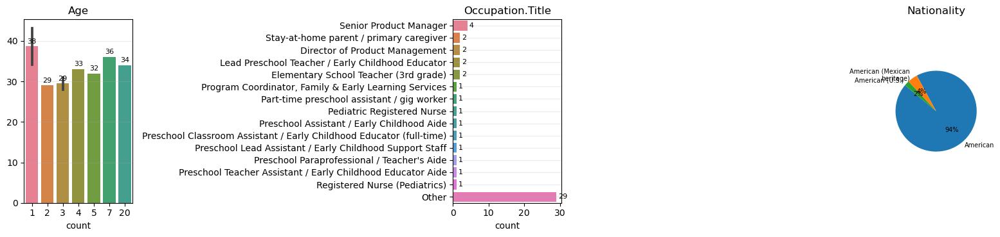

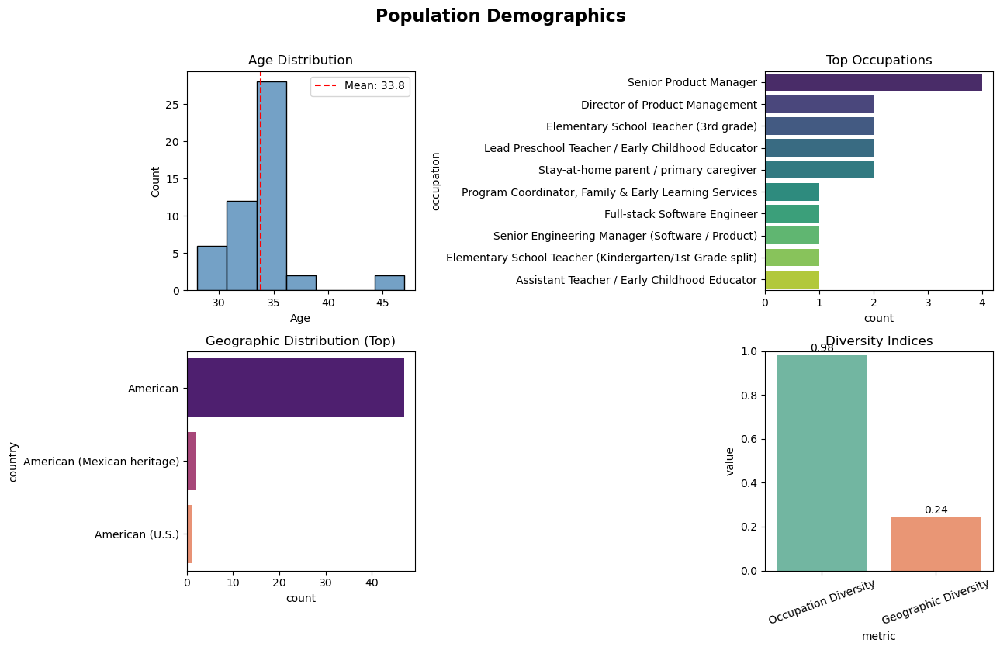

Persona composition keys found: ['interests', 'skills', 'beliefs', 'goals', 'likes_dislikes', 'routines', 'relationship_roles', 'communication_style', 'health', 'personality_traits']
[DEBUG persona_plot] facet 'interests' empty -> hidden
[DEBUG persona_plot] facet 'goals' empty -> hidden
[DEBUG persona_plot] facet 'likes_dislikes' empty -> hidden
[DEBUG persona_plot] facet 'relationship_roles' empty -> hidden
[DEBUG persona_plot] facet 'health' empty -> hidden


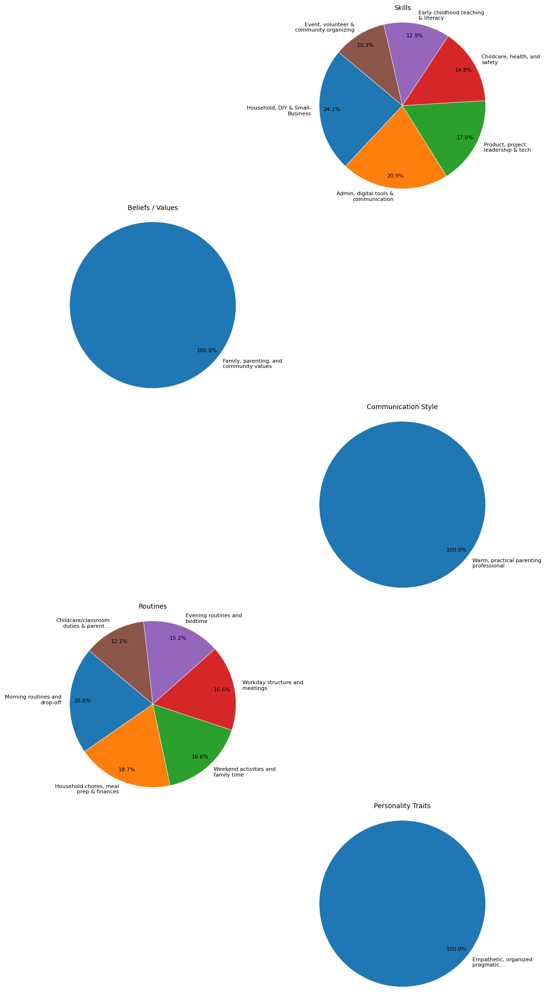

{'age': 28     3
 29     2
 30     1
 31     3
 32     5
 33     4
 34    20
 35     1
 36     7
 37     1
 38     1
 45     1
 47     1
 Name: count, dtype: int64,
 'occupation.title': Assistant Store Manager / Floor Supervisor                                                                       1
 Assistant Teacher / Early Childhood Educator                                                                     1
 Director of Product Management                                                                                   2
 Early Childhood Educator / Teacher Assistant                                                                     1
 Elementary School Teacher (1st-2nd grade)                                                                        1
 Elementary School Teacher (2nd Grade)                                                                            1
 Elementary School Teacher (2nd grade); part-time curriculum consultant for a local nonprofit literacy program    1
 El

In [13]:
profiler = Profiler()
profiler.profile(people)

Checkpoint the simulation state to disk, to avoid having to re-run the expensive agent sampling process, unless really necessary.

In [14]:
control.checkpoint()

2025-09-19 23:09:55,487 - tinytroupe - DEBUG - Checkpointing simulation state...
2025-09-19 23:09:55,488 - tinytroupe - DEBUG - No unsaved cache changes to save to file.


Now let's enclose the audience in an environment, to make it easier to interact with. Note that we set `broadcast_if_no_target` to `False`, which instructs the environment to **do not** broadcast what specific agents say to the others (unless the agent deliberately specify the target). We are not simulating a focus group, so we don't want discussions.


In [15]:
market = TinyWorld(f"Target audience ({target_nationality})", people, broadcast_if_no_target=False)

2025-09-19 23:09:55,524 - tinytroupe - DEBUG - Adding agent Jasmine Patrice Carter to the environment.
2025-09-19 23:09:55,526 - tinytroupe - DEBUG - Adding agent Ava Mei Lin to the environment.
2025-09-19 23:09:55,529 - tinytroupe - DEBUG - Adding agent Evan Thomas Harper to the environment.
2025-09-19 23:09:55,530 - tinytroupe - DEBUG - Adding agent Claire Elizabeth Martin to the environment.
2025-09-19 23:09:55,531 - tinytroupe - DEBUG - Adding agent Camila Elena Torres to the environment.
2025-09-19 23:09:55,533 - tinytroupe - DEBUG - Adding agent Caroline Elise Hart to the environment.
2025-09-19 23:09:55,536 - tinytroupe - DEBUG - Adding agent Caitlin Emerson Price to the environment.
2025-09-19 23:09:55,538 - tinytroupe - DEBUG - Adding agent Alejandra Maribel Hernandez to the environment.
2025-09-19 23:09:55,539 - tinytroupe - DEBUG - Adding agent Lucia Elena Martinez to the environment.
2025-09-19 23:09:55,542 - tinytroupe - DEBUG - Adding agent Olivia Kate Reynolds to the env

## Perform the research

Now we actually ask agents about their opinion. Note that we are asking for specific answers (Yes, No, Maybe), both to convey the granularity of preference we seek, and to make it easier to extract the results later. In general, a coarser granuarity is likely to have higher quality, since it requires less information to be computed accurately.

In [16]:
market.broadcast(interviewer_introduction)
market.broadcast(interviewer_main_question)
market.broadcast_thought(inner_monologue)

2025-09-19 23:09:55,620 - tinytroupe - DEBUG - -----------------------------------------> Transaction: broadcast with args ('\n   Artificial Intelligence (AI) can now create compelling stories for young children, tell them aloud and \n   even generate illustrations of the scenes, like a regular book. We are considering creating a "digital story-teller" to leverage \n   this, and would like the opinion of parents. The key idea is that that the child would be able to independently talk to the AI \n   story-teller and request specific stories, anything the child can imagine. Our main doubt is HOW to deliver this technology to \n   the children.\n   \n   Your task is to order the options based on your preferences. The first option is the one you like the most, and the last option \n   is the one you like the least. So, for example, if you respond with "B, A, C, D, E", it means you prefer option B the most and \n   option E the least.\n    ',) and kwargs {} under simulation None, parallel=F

USER --> Caitlin Emerson Price: [CONVERSATION] 
          >     Artificial Intelligence (AI) can now create compelling stories for young children,
          > tell them aloud and     even generate illustrations of the scenes, like a regular book.
          > We are considering creating a "digital story-teller" to leverage     this, and would
          > like the opinion of parents. The key idea is that that the child would be able to
          > independently talk to the AI     story-teller and request specific stories, anything the
          > child can imagine. Our main doubt is HOW to deliver this technology to     the children.
          > Your task is to order the options based on your preferences. The first option is the one
          > you like the most, and the last option     is the one you like the least. So, for
          > example, if you respond with "B, A, C, D, E", it means you prefer option B the most and
          > option E the least.

       + --> Camila Elena Torres

       + --> Heather Lynn Montgomery

       + --> ...others...

2025-09-19 23:09:55,870 - tinytroupe - DEBUG - Will attempt to checkpoint simulation state after transaction execution.
2025-09-19 23:09:55,873 - tinytroupe - DEBUG - -----------------------------------------> Transaction: broadcast with args (' \n    So the main question for you to rank the options is this: what kind of AI-enabled story-telling device would you buy for your very young children (3 to 5 y.o.)? \n    \n    Pick from the options below (A, B, C, D, E) and please explain your choices. Here are the details about each option:\n\n\n     - (A) DEDICATED SINGLE-PURPOSE DEVICE (AUDIO + IMAGES): A single-purpose portable device, where there are no apps or anything else. There is just a single button to turn it ON or OFF, plus a screen, and when ON the child can talk to an animated story-teller, ask stories and the device then tells the requested stories aloud, including related story illustrations too shown on a screen, all on demand. The child can interrupt it at any time too. Th

USER --> Caitlin Emerson Price: [CONVERSATION] 
          >       So the main question for you to rank the options is this: what kind of AI-enabled
          > story-telling device would you buy for your very young children (3 to 5 y.o.)?
          > Pick from the options below (A, B, C, D, E) and please explain your choices. Here are
          > the details about each option:        - (A) DEDICATED SINGLE-PURPOSE DEVICE (AUDIO +
          > IMAGES): A single-purpose portable device, where there are no apps or anything else.
          > There is just a single button to turn it ON or OFF, plus a screen, and when ON the child
          > can talk to an animated story-teller, ask stories and the device then tells the
          > requested stories aloud, including related story illustrations too shown on a screen,
          > all on demand. The child can interrupt it at any time too. There is nothing else, no
          > other apps, no other info, nothing, it is just a story-teller device. The stories are
          > told aloud and include static images (like a book, but on the screen). No parent
          > supervision needed.            PRICE:  Would cost the same as a regular low-end smar
          > (...)

       + --> Camila Elena Torres

       + --> Heather Lynn Montgomery

       + --> ...others...

2025-09-19 23:09:56,240 - tinytroupe - DEBUG - Will attempt to checkpoint simulation state after transaction execution.
2025-09-19 23:09:56,245 - tinytroupe - DEBUG - -----------------------------------------> Transaction: broadcast_thought with args ('\n    I will be honest as I understand they are not here to judge me, but just to learn from me. \n    Such choices depend on many factors, but I will make my best guess, considering my current \n    situation in life, location, job and interests.\n\n    Now I **must** first THINK deeply about the question, consider all the factors that might influence my decision,\n    and only then I will TALK with my response to the question as best, as detailed and as honestly as I can.\n\n    I will respect the expected response format, giving first my ranked choices and then justifying that ranking. I MUST adhere to the format strictly,\n    saying "Ranking: ..." and "Justification: ...", otherwise my answer might be discarded. For the choices, I W

Caitlin Emerson Price --> Caitlin Emerson Price: [THOUGHT] 
                           >      I will be honest as I understand they are not here to judge me,
                           > but just to learn from me.      Such choices depend on many factors,
                           > but I will make my best guess, considering my current      situation in
                           > life, location, job and interests.      Now I **must** first THINK
                           > deeply about the question, consider all the factors that might
                           > influence my decision,     and only then I will TALK with my response
                           > to the question as best, as detailed and as honestly as I can.      I
                           > will respect the expected response format, giving first my ranked
                           > choices and then justifying that ranking. I MUST adhere to the format
                           > strictly,     saying "Ranking: ..." and "Justification: ...", otherwise
                           > my answer might be discarded. For the choices, I WILL USE LETTERS (A,
                           > B, C, D, E).

Camila Elena Torres --> Camila Elena Torres: [THOUGHT] 
                         >      I will be honest as I understand they are not here to judge me, but
                         > just to learn from me.      Such choices depend on many factors, but I
                         > will make my best guess, considering my current      situation in life,
                         > location, job and interests.      Now I **must** first THINK deeply about
                         > the question, consider all the factors that might influence my decision,
                         > and only then I will TALK with my response to the question as best, as
                         > detailed and as honestly as I can.      I will respect the expected
                         > response format, giving first my ranked choices and then justifying that
                         > ranking. I MUST adhere to the format strictly,     saying "Ranking: ..."
                         > and "Justification: ...", otherwise my answer might be discarded. For the
                         > choices, I WILL USE LETTERS (A, B, C, D, E).

Heather Lynn Montgomery --> Heather Lynn Montgomery: [THOUGHT] 
                             >      I will be honest as I understand they are not here to judge me,
                             > but just to learn from me.      Such choices depend on many factors,
                             > but I will make my best guess, considering my current      situation
                             > in life, location, job and interests.      Now I **must** first THINK
                             > deeply about the question, consider all the factors that might
                             > influence my decision,     and only then I will TALK with my response
                             > to the question as best, as detailed and as honestly as I can.      I
                             > will respect the expected response format, giving first my ranked
                             > choices and then justifying that ranking. I MUST adhere to the format
                             > strictly,     saying "Ranking: ..." and "Justification: ...",
                             > otherwise my answer might be discarded. For the choices, I WILL USE
                             > LETTERS (A, B, C, D, E).

Olivia Kate Reynolds --> Olivia Kate Reynolds: [THOUGHT] 
                          >      I will be honest as I understand they are not here to judge me, but
                          > just to learn from me.      Such choices depend on many factors, but I
                          > will make my best guess, considering my current      situation in life,
                          > location, job and interests.      Now I **must** first THINK deeply
                          > about the question, consider all the factors that might influence my
                          > decision,     and only then I will TALK with my response to the question
                          > as best, as detailed and as honestly as I can.      I will respect the
                          > expected response format, giving first my ranked choices and then
                          > justifying that ranking. I MUST adhere to the format strictly,
                          > saying "Ranking: ..." and "Justification: ...", otherwise my answer
                          > might be discarded. For the choices, I WILL USE LETTERS (A, B, C, D, E).

Caroline Elise Hart --> Caroline Elise Hart: [THOUGHT] 
                         >      I will be honest as I understand they are not here to judge me, but
                         > just to learn from me.      Such choices depend on many factors, but I
                         > will make my best guess, considering my current      situation in life,
                         > location, job and interests.      Now I **must** first THINK deeply about
                         > the question, consider all the factors that might influence my decision,
                         > and only then I will TALK with my response to the question as best, as
                         > detailed and as honestly as I can.      I will respect the expected
                         > response format, giving first my ranked choices and then justifying that
                         > ranking. I MUST adhere to the format strictly,     saying "Ranking: ..."
                         > and "Justification: ...", otherwise my answer might be discarded. For the
                         > choices, I WILL USE LETTERS (A, B, C, D, E).

Alejandra Maribel Hernandez --> Alejandra Maribel Hernandez: [THOUGHT] 
                                 >      I will be honest as I understand they are not here to judge
                                 > me, but just to learn from me.      Such choices depend on many
                                 > factors, but I will make my best guess, considering my current
                                 > situation in life, location, job and interests.      Now I
                                 > **must** first THINK deeply about the question, consider all the
                                 > factors that might influence my decision,     and only then I
                                 > will TALK with my response to the question as best, as detailed
                                 > and as honestly as I can.      I will respect the expected
                                 > response format, giving first my ranked choices and then
                                 > justifying that ranking. I MUST adhere to the format strictly,
                                 > saying "Ranking: ..." and "Justification: ...", otherwise my
                                 > answer might be discarded. For the choices, I WILL USE LETTERS
                                 > (A, B, C, D, E).

Leah Mariko Alvarez-Green --> Leah Mariko Alvarez-Green: [THOUGHT] 
                               >      I will be honest as I understand they are not here to judge
                               > me, but just to learn from me.      Such choices depend on many
                               > factors, but I will make my best guess, considering my current
                               > situation in life, location, job and interests.      Now I **must**
                               > first THINK deeply about the question, consider all the factors
                               > that might influence my decision,     and only then I will TALK
                               > with my response to the question as best, as detailed and as
                               > honestly as I can.      I will respect the expected response
                               > format, giving first my ranked choices and then justifying that
                               > ranking. I MUST adhere to the format strictly,     saying "Ranking:
                               > ..." and "Justification: ...", otherwise my answer might be
                               > discarded. For the choices, I WILL USE LETTERS (A, B, C, D, E).

Lucia Elena Martinez --> Lucia Elena Martinez: [THOUGHT] 
                          >      I will be honest as I understand they are not here to judge me, but
                          > just to learn from me.      Such choices depend on many factors, but I
                          > will make my best guess, considering my current      situation in life,
                          > location, job and interests.      Now I **must** first THINK deeply
                          > about the question, consider all the factors that might influence my
                          > decision,     and only then I will TALK with my response to the question
                          > as best, as detailed and as honestly as I can.      I will respect the
                          > expected response format, giving first my ranked choices and then
                          > justifying that ranking. I MUST adhere to the format strictly,
                          > saying "Ranking: ..." and "Justification: ...", otherwise my answer
                          > might be discarded. For the choices, I WILL USE LETTERS (A, B, C, D, E).

Jasmine Patrice Carter --> Jasmine Patrice Carter: [THOUGHT] 
                            >      I will be honest as I understand they are not here to judge me,
                            > but just to learn from me.      Such choices depend on many factors,
                            > but I will make my best guess, considering my current      situation
                            > in life, location, job and interests.      Now I **must** first THINK
                            > deeply about the question, consider all the factors that might
                            > influence my decision,     and only then I will TALK with my response
                            > to the question as best, as detailed and as honestly as I can.      I
                            > will respect the expected response format, giving first my ranked
                            > choices and then justifying that ranking. I MUST adhere to the format
                            > strictly,     saying "Ranking: ..." and "Justification: ...",
                            > otherwise my answer might be discarded. For the choices, I WILL USE
                            > LETTERS (A, B, C, D, E).

Ava Mei Lin --> Ava Mei Lin: [THOUGHT] 
                 >      I will be honest as I understand they are not here to judge me, but just to
                 > learn from me.      Such choices depend on many factors, but I will make my best
                 > guess, considering my current      situation in life, location, job and
                 > interests.      Now I **must** first THINK deeply about the question, consider
                 > all the factors that might influence my decision,     and only then I will TALK
                 > with my response to the question as best, as detailed and as honestly as I can.
                 > I will respect the expected response format, giving first my ranked choices and
                 > then justifying that ranking. I MUST adhere to the format strictly,     saying
                 > "Ranking: ..." and "Justification: ...", otherwise my answer might be discarded.
                 > For the choices, I WILL USE LETTERS (A, B, C, D, E).

Evan Thomas Harper --> Evan Thomas Harper: [THOUGHT] 
                        >      I will be honest as I understand they are not here to judge me, but
                        > just to learn from me.      Such choices depend on many factors, but I
                        > will make my best guess, considering my current      situation in life,
                        > location, job and interests.      Now I **must** first THINK deeply about
                        > the question, consider all the factors that might influence my decision,
                        > and only then I will TALK with my response to the question as best, as
                        > detailed and as honestly as I can.      I will respect the expected
                        > response format, giving first my ranked choices and then justifying that
                        > ranking. I MUST adhere to the format strictly,     saying "Ranking: ..."
                        > and "Justification: ...", otherwise my answer might be discarded. For the
                        > choices, I WILL USE LETTERS (A, B, C, D, E).

Claire Elizabeth Martin --> Claire Elizabeth Martin: [THOUGHT] 
                             >      I will be honest as I understand they are not here to judge me,
                             > but just to learn from me.      Such choices depend on many factors,
                             > but I will make my best guess, considering my current      situation
                             > in life, location, job and interests.      Now I **must** first THINK
                             > deeply about the question, consider all the factors that might
                             > influence my decision,     and only then I will TALK with my response
                             > to the question as best, as detailed and as honestly as I can.      I
                             > will respect the expected response format, giving first my ranked
                             > choices and then justifying that ranking. I MUST adhere to the format
                             > strictly,     saying "Ranking: ..." and "Justification: ...",
                             > otherwise my answer might be discarded. For the choices, I WILL USE
                             > LETTERS (A, B, C, D, E).

Natalia Brooks --> Natalia Brooks: [THOUGHT] 
                    >      I will be honest as I understand they are not here to judge me, but just
                    > to learn from me.      Such choices depend on many factors, but I will make my
                    > best guess, considering my current      situation in life, location, job and
                    > interests.      Now I **must** first THINK deeply about the question, consider
                    > all the factors that might influence my decision,     and only then I will
                    > TALK with my response to the question as best, as detailed and as honestly as
                    > I can.      I will respect the expected response format, giving first my
                    > ranked choices and then justifying that ranking. I MUST adhere to the format
                    > strictly,     saying "Ranking: ..." and "Justification: ...", otherwise my
                    > answer might be discarded. For the choices, I WILL USE LETTERS (A, B, C, D,
                    > E).

Molly Grace Whitman --> Molly Grace Whitman: [THOUGHT] 
                         >      I will be honest as I understand they are not here to judge me, but
                         > just to learn from me.      Such choices depend on many factors, but I
                         > will make my best guess, considering my current      situation in life,
                         > location, job and interests.      Now I **must** first THINK deeply about
                         > the question, consider all the factors that might influence my decision,
                         > and only then I will TALK with my response to the question as best, as
                         > detailed and as honestly as I can.      I will respect the expected
                         > response format, giving first my ranked choices and then justifying that
                         > ranking. I MUST adhere to the format strictly,     saying "Ranking: ..."
                         > and "Justification: ...", otherwise my answer might be discarded. For the
                         > choices, I WILL USE LETTERS (A, B, C, D, E).

Ashley Marie Collins --> Ashley Marie Collins: [THOUGHT] 
                          >      I will be honest as I understand they are not here to judge me, but
                          > just to learn from me.      Such choices depend on many factors, but I
                          > will make my best guess, considering my current      situation in life,
                          > location, job and interests.      Now I **must** first THINK deeply
                          > about the question, consider all the factors that might influence my
                          > decision,     and only then I will TALK with my response to the question
                          > as best, as detailed and as honestly as I can.      I will respect the
                          > expected response format, giving first my ranked choices and then
                          > justifying that ranking. I MUST adhere to the format strictly,
                          > saying "Ranking: ..." and "Justification: ...", otherwise my answer
                          > might be discarded. For the choices, I WILL USE LETTERS (A, B, C, D, E).

Ananya Kapoor --> Ananya Kapoor: [THOUGHT] 
                   >      I will be honest as I understand they are not here to judge me, but just
                   > to learn from me.      Such choices depend on many factors, but I will make my
                   > best guess, considering my current      situation in life, location, job and
                   > interests.      Now I **must** first THINK deeply about the question, consider
                   > all the factors that might influence my decision,     and only then I will TALK
                   > with my response to the question as best, as detailed and as honestly as I can.
                   > I will respect the expected response format, giving first my ranked choices and
                   > then justifying that ranking. I MUST adhere to the format strictly,     saying
                   > "Ranking: ..." and "Justification: ...", otherwise my answer might be
                   > discarded. For the choices, I WILL USE LETTERS (A, B, C, D, E).

Abigail Meredith Coleman --> Abigail Meredith Coleman: [THOUGHT] 
                              >      I will be honest as I understand they are not here to judge me,
                              > but just to learn from me.      Such choices depend on many factors,
                              > but I will make my best guess, considering my current      situation
                              > in life, location, job and interests.      Now I **must** first
                              > THINK deeply about the question, consider all the factors that might
                              > influence my decision,     and only then I will TALK with my
                              > response to the question as best, as detailed and as honestly as I
                              > can.      I will respect the expected response format, giving first
                              > my ranked choices and then justifying that ranking. I MUST adhere to
                              > the format strictly,     saying "Ranking: ..." and "Justification:
                              > ...", otherwise my answer might be discarded. For the choices, I
                              > WILL USE LETTERS (A, B, C, D, E).

Margot Emerson Clarke --> Margot Emerson Clarke: [THOUGHT] 
                           >      I will be honest as I understand they are not here to judge me,
                           > but just to learn from me.      Such choices depend on many factors,
                           > but I will make my best guess, considering my current      situation in
                           > life, location, job and interests.      Now I **must** first THINK
                           > deeply about the question, consider all the factors that might
                           > influence my decision,     and only then I will TALK with my response
                           > to the question as best, as detailed and as honestly as I can.      I
                           > will respect the expected response format, giving first my ranked
                           > choices and then justifying that ranking. I MUST adhere to the format
                           > strictly,     saying "Ranking: ..." and "Justification: ...", otherwise
                           > my answer might be discarded. For the choices, I WILL USE LETTERS (A,
                           > B, C, D, E).

Jennifer Marie Brooks --> Jennifer Marie Brooks: [THOUGHT] 
                           >      I will be honest as I understand they are not here to judge me,
                           > but just to learn from me.      Such choices depend on many factors,
                           > but I will make my best guess, considering my current      situation in
                           > life, location, job and interests.      Now I **must** first THINK
                           > deeply about the question, consider all the factors that might
                           > influence my decision,     and only then I will TALK with my response
                           > to the question as best, as detailed and as honestly as I can.      I
                           > will respect the expected response format, giving first my ranked
                           > choices and then justifying that ranking. I MUST adhere to the format
                           > strictly,     saying "Ranking: ..." and "Justification: ...", otherwise
                           > my answer might be discarded. For the choices, I WILL USE LETTERS (A,
                           > B, C, D, E).

Holly Margaret Greene --> Holly Margaret Greene: [THOUGHT] 
                           >      I will be honest as I understand they are not here to judge me,
                           > but just to learn from me.      Such choices depend on many factors,
                           > but I will make my best guess, considering my current      situation in
                           > life, location, job and interests.      Now I **must** first THINK
                           > deeply about the question, consider all the factors that might
                           > influence my decision,     and only then I will TALK with my response
                           > to the question as best, as detailed and as honestly as I can.      I
                           > will respect the expected response format, giving first my ranked
                           > choices and then justifying that ranking. I MUST adhere to the format
                           > strictly,     saying "Ranking: ..." and "Justification: ...", otherwise
                           > my answer might be discarded. For the choices, I WILL USE LETTERS (A,
                           > B, C, D, E).

Rebecca Wallace --> Rebecca Wallace: [THOUGHT] 
                     >      I will be honest as I understand they are not here to judge me, but just
                     > to learn from me.      Such choices depend on many factors, but I will make
                     > my best guess, considering my current      situation in life, location, job
                     > and interests.      Now I **must** first THINK deeply about the question,
                     > consider all the factors that might influence my decision,     and only then
                     > I will TALK with my response to the question as best, as detailed and as
                     > honestly as I can.      I will respect the expected response format, giving
                     > first my ranked choices and then justifying that ranking. I MUST adhere to
                     > the format strictly,     saying "Ranking: ..." and "Justification: ...",
                     > otherwise my answer might be discarded. For the choices, I WILL USE LETTERS
                     > (A, B, C, D, E).

Maya Linh Torres-Khan --> Maya Linh Torres-Khan: [THOUGHT] 
                           >      I will be honest as I understand they are not here to judge me,
                           > but just to learn from me.      Such choices depend on many factors,
                           > but I will make my best guess, considering my current      situation in
                           > life, location, job and interests.      Now I **must** first THINK
                           > deeply about the question, consider all the factors that might
                           > influence my decision,     and only then I will TALK with my response
                           > to the question as best, as detailed and as honestly as I can.      I
                           > will respect the expected response format, giving first my ranked
                           > choices and then justifying that ranking. I MUST adhere to the format
                           > strictly,     saying "Ranking: ..." and "Justification: ...", otherwise
                           > my answer might be discarded. For the choices, I WILL USE LETTERS (A,
                           > B, C, D, E).

Hannah Mei Walker --> Hannah Mei Walker: [THOUGHT] 
                       >      I will be honest as I understand they are not here to judge me, but
                       > just to learn from me.      Such choices depend on many factors, but I will
                       > make my best guess, considering my current      situation in life,
                       > location, job and interests.      Now I **must** first THINK deeply about
                       > the question, consider all the factors that might influence my decision,
                       > and only then I will TALK with my response to the question as best, as
                       > detailed and as honestly as I can.      I will respect the expected
                       > response format, giving first my ranked choices and then justifying that
                       > ranking. I MUST adhere to the format strictly,     saying "Ranking: ..."
                       > and "Justification: ...", otherwise my answer might be discarded. For the
                       > choices, I WILL USE LETTERS (A, B, C, D, E).

Evelyn Jia Chen --> Evelyn Jia Chen: [THOUGHT] 
                     >      I will be honest as I understand they are not here to judge me, but just
                     > to learn from me.      Such choices depend on many factors, but I will make
                     > my best guess, considering my current      situation in life, location, job
                     > and interests.      Now I **must** first THINK deeply about the question,
                     > consider all the factors that might influence my decision,     and only then
                     > I will TALK with my response to the question as best, as detailed and as
                     > honestly as I can.      I will respect the expected response format, giving
                     > first my ranked choices and then justifying that ranking. I MUST adhere to
                     > the format strictly,     saying "Ranking: ..." and "Justification: ...",
                     > otherwise my answer might be discarded. For the choices, I WILL USE LETTERS
                     > (A, B, C, D, E).

Erin Katherine Miller --> Erin Katherine Miller: [THOUGHT] 
                           >      I will be honest as I understand they are not here to judge me,
                           > but just to learn from me.      Such choices depend on many factors,
                           > but I will make my best guess, considering my current      situation in
                           > life, location, job and interests.      Now I **must** first THINK
                           > deeply about the question, consider all the factors that might
                           > influence my decision,     and only then I will TALK with my response
                           > to the question as best, as detailed and as honestly as I can.      I
                           > will respect the expected response format, giving first my ranked
                           > choices and then justifying that ranking. I MUST adhere to the format
                           > strictly,     saying "Ranking: ..." and "Justification: ...", otherwise
                           > my answer might be discarded. For the choices, I WILL USE LETTERS (A,
                           > B, C, D, E).

Aisha Nicole Thompson --> Aisha Nicole Thompson: [THOUGHT] 
                           >      I will be honest as I understand they are not here to judge me,
                           > but just to learn from me.      Such choices depend on many factors,
                           > but I will make my best guess, considering my current      situation in
                           > life, location, job and interests.      Now I **must** first THINK
                           > deeply about the question, consider all the factors that might
                           > influence my decision,     and only then I will TALK with my response
                           > to the question as best, as detailed and as honestly as I can.      I
                           > will respect the expected response format, giving first my ranked
                           > choices and then justifying that ranking. I MUST adhere to the format
                           > strictly,     saying "Ranking: ..." and "Justification: ...", otherwise
                           > my answer might be discarded. For the choices, I WILL USE LETTERS (A,
                           > B, C, D, E).

Jessica Marie Little --> Jessica Marie Little: [THOUGHT] 
                          >      I will be honest as I understand they are not here to judge me, but
                          > just to learn from me.      Such choices depend on many factors, but I
                          > will make my best guess, considering my current      situation in life,
                          > location, job and interests.      Now I **must** first THINK deeply
                          > about the question, consider all the factors that might influence my
                          > decision,     and only then I will TALK with my response to the question
                          > as best, as detailed and as honestly as I can.      I will respect the
                          > expected response format, giving first my ranked choices and then
                          > justifying that ranking. I MUST adhere to the format strictly,
                          > saying "Ranking: ..." and "Justification: ...", otherwise my answer
                          > might be discarded. For the choices, I WILL USE LETTERS (A, B, C, D, E).

Leilani Yazzie --> Leilani Yazzie: [THOUGHT] 
                    >      I will be honest as I understand they are not here to judge me, but just
                    > to learn from me.      Such choices depend on many factors, but I will make my
                    > best guess, considering my current      situation in life, location, job and
                    > interests.      Now I **must** first THINK deeply about the question, consider
                    > all the factors that might influence my decision,     and only then I will
                    > TALK with my response to the question as best, as detailed and as honestly as
                    > I can.      I will respect the expected response format, giving first my
                    > ranked choices and then justifying that ranking. I MUST adhere to the format
                    > strictly,     saying "Ranking: ..." and "Justification: ...", otherwise my
                    > answer might be discarded. For the choices, I WILL USE LETTERS (A, B, C, D,
                    > E).

Sofia Elena Morales --> Sofia Elena Morales: [THOUGHT] 
                         >      I will be honest as I understand they are not here to judge me, but
                         > just to learn from me.      Such choices depend on many factors, but I
                         > will make my best guess, considering my current      situation in life,
                         > location, job and interests.      Now I **must** first THINK deeply about
                         > the question, consider all the factors that might influence my decision,
                         > and only then I will TALK with my response to the question as best, as
                         > detailed and as honestly as I can.      I will respect the expected
                         > response format, giving first my ranked choices and then justifying that
                         > ranking. I MUST adhere to the format strictly,     saying "Ranking: ..."
                         > and "Justification: ...", otherwise my answer might be discarded. For the
                         > choices, I WILL USE LETTERS (A, B, C, D, E).

Natalie Grace Anderson --> Natalie Grace Anderson: [THOUGHT] 
                            >      I will be honest as I understand they are not here to judge me,
                            > but just to learn from me.      Such choices depend on many factors,
                            > but I will make my best guess, considering my current      situation
                            > in life, location, job and interests.      Now I **must** first THINK
                            > deeply about the question, consider all the factors that might
                            > influence my decision,     and only then I will TALK with my response
                            > to the question as best, as detailed and as honestly as I can.      I
                            > will respect the expected response format, giving first my ranked
                            > choices and then justifying that ranking. I MUST adhere to the format
                            > strictly,     saying "Ranking: ..." and "Justification: ...",
                            > otherwise my answer might be discarded. For the choices, I WILL USE
                            > LETTERS (A, B, C, D, E).

Dominique Latrice Johnson --> Dominique Latrice Johnson: [THOUGHT] 
                               >      I will be honest as I understand they are not here to judge
                               > me, but just to learn from me.      Such choices depend on many
                               > factors, but I will make my best guess, considering my current
                               > situation in life, location, job and interests.      Now I **must**
                               > first THINK deeply about the question, consider all the factors
                               > that might influence my decision,     and only then I will TALK
                               > with my response to the question as best, as detailed and as
                               > honestly as I can.      I will respect the expected response
                               > format, giving first my ranked choices and then justifying that
                               > ranking. I MUST adhere to the format strictly,     saying "Ranking:
                               > ..." and "Justification: ...", otherwise my answer might be
                               > discarded. For the choices, I WILL USE LETTERS (A, B, C, D, E).

Maya Rivera-Johnson --> Maya Rivera-Johnson: [THOUGHT] 
                         >      I will be honest as I understand they are not here to judge me, but
                         > just to learn from me.      Such choices depend on many factors, but I
                         > will make my best guess, considering my current      situation in life,
                         > location, job and interests.      Now I **must** first THINK deeply about
                         > the question, consider all the factors that might influence my decision,
                         > and only then I will TALK with my response to the question as best, as
                         > detailed and as honestly as I can.      I will respect the expected
                         > response format, giving first my ranked choices and then justifying that
                         > ranking. I MUST adhere to the format strictly,     saying "Ranking: ..."
                         > and "Justification: ...", otherwise my answer might be discarded. For the
                         > choices, I WILL USE LETTERS (A, B, C, D, E).

Kendra Patrice Williams --> Kendra Patrice Williams: [THOUGHT] 
                             >      I will be honest as I understand they are not here to judge me,
                             > but just to learn from me.      Such choices depend on many factors,
                             > but I will make my best guess, considering my current      situation
                             > in life, location, job and interests.      Now I **must** first THINK
                             > deeply about the question, consider all the factors that might
                             > influence my decision,     and only then I will TALK with my response
                             > to the question as best, as detailed and as honestly as I can.      I
                             > will respect the expected response format, giving first my ranked
                             > choices and then justifying that ranking. I MUST adhere to the format
                             > strictly,     saying "Ranking: ..." and "Justification: ...",
                             > otherwise my answer might be discarded. For the choices, I WILL USE
                             > LETTERS (A, B, C, D, E).

Caroline Reid Whitman --> Caroline Reid Whitman: [THOUGHT] 
                           >      I will be honest as I understand they are not here to judge me,
                           > but just to learn from me.      Such choices depend on many factors,
                           > but I will make my best guess, considering my current      situation in
                           > life, location, job and interests.      Now I **must** first THINK
                           > deeply about the question, consider all the factors that might
                           > influence my decision,     and only then I will TALK with my response
                           > to the question as best, as detailed and as honestly as I can.      I
                           > will respect the expected response format, giving first my ranked
                           > choices and then justifying that ranking. I MUST adhere to the format
                           > strictly,     saying "Ranking: ..." and "Justification: ...", otherwise
                           > my answer might be discarded. For the choices, I WILL USE LETTERS (A,
                           > B, C, D, E).

Monique Danielle Harris --> Monique Danielle Harris: [THOUGHT] 
                             >      I will be honest as I understand they are not here to judge me,
                             > but just to learn from me.      Such choices depend on many factors,
                             > but I will make my best guess, considering my current      situation
                             > in life, location, job and interests.      Now I **must** first THINK
                             > deeply about the question, consider all the factors that might
                             > influence my decision,     and only then I will TALK with my response
                             > to the question as best, as detailed and as honestly as I can.      I
                             > will respect the expected response format, giving first my ranked
                             > choices and then justifying that ranking. I MUST adhere to the format
                             > strictly,     saying "Ranking: ..." and "Justification: ...",
                             > otherwise my answer might be discarded. For the choices, I WILL USE
                             > LETTERS (A, B, C, D, E).

Sarah Lynn Daniels --> Sarah Lynn Daniels: [THOUGHT] 
                        >      I will be honest as I understand they are not here to judge me, but
                        > just to learn from me.      Such choices depend on many factors, but I
                        > will make my best guess, considering my current      situation in life,
                        > location, job and interests.      Now I **must** first THINK deeply about
                        > the question, consider all the factors that might influence my decision,
                        > and only then I will TALK with my response to the question as best, as
                        > detailed and as honestly as I can.      I will respect the expected
                        > response format, giving first my ranked choices and then justifying that
                        > ranking. I MUST adhere to the format strictly,     saying "Ranking: ..."
                        > and "Justification: ...", otherwise my answer might be discarded. For the
                        > choices, I WILL USE LETTERS (A, B, C, D, E).

Rachel Morgan Ellis --> Rachel Morgan Ellis: [THOUGHT] 
                         >      I will be honest as I understand they are not here to judge me, but
                         > just to learn from me.      Such choices depend on many factors, but I
                         > will make my best guess, considering my current      situation in life,
                         > location, job and interests.      Now I **must** first THINK deeply about
                         > the question, consider all the factors that might influence my decision,
                         > and only then I will TALK with my response to the question as best, as
                         > detailed and as honestly as I can.      I will respect the expected
                         > response format, giving first my ranked choices and then justifying that
                         > ranking. I MUST adhere to the format strictly,     saying "Ranking: ..."
                         > and "Justification: ...", otherwise my answer might be discarded. For the
                         > choices, I WILL USE LETTERS (A, B, C, D, E).

Brianna Lopez-Jones --> Brianna Lopez-Jones: [THOUGHT] 
                         >      I will be honest as I understand they are not here to judge me, but
                         > just to learn from me.      Such choices depend on many factors, but I
                         > will make my best guess, considering my current      situation in life,
                         > location, job and interests.      Now I **must** first THINK deeply about
                         > the question, consider all the factors that might influence my decision,
                         > and only then I will TALK with my response to the question as best, as
                         > detailed and as honestly as I can.      I will respect the expected
                         > response format, giving first my ranked choices and then justifying that
                         > ranking. I MUST adhere to the format strictly,     saying "Ranking: ..."
                         > and "Justification: ...", otherwise my answer might be discarded. For the
                         > choices, I WILL USE LETTERS (A, B, C, D, E).

Claire Montgomery --> Claire Montgomery: [THOUGHT] 
                       >      I will be honest as I understand they are not here to judge me, but
                       > just to learn from me.      Such choices depend on many factors, but I will
                       > make my best guess, considering my current      situation in life,
                       > location, job and interests.      Now I **must** first THINK deeply about
                       > the question, consider all the factors that might influence my decision,
                       > and only then I will TALK with my response to the question as best, as
                       > detailed and as honestly as I can.      I will respect the expected
                       > response format, giving first my ranked choices and then justifying that
                       > ranking. I MUST adhere to the format strictly,     saying "Ranking: ..."
                       > and "Justification: ...", otherwise my answer might be discarded. For the
                       > choices, I WILL USE LETTERS (A, B, C, D, E).

Hannah Lucia Reynolds --> Hannah Lucia Reynolds: [THOUGHT] 
                           >      I will be honest as I understand they are not here to judge me,
                           > but just to learn from me.      Such choices depend on many factors,
                           > but I will make my best guess, considering my current      situation in
                           > life, location, job and interests.      Now I **must** first THINK
                           > deeply about the question, consider all the factors that might
                           > influence my decision,     and only then I will TALK with my response
                           > to the question as best, as detailed and as honestly as I can.      I
                           > will respect the expected response format, giving first my ranked
                           > choices and then justifying that ranking. I MUST adhere to the format
                           > strictly,     saying "Ranking: ..." and "Justification: ...", otherwise
                           > my answer might be discarded. For the choices, I WILL USE LETTERS (A,
                           > B, C, D, E).

Gabriela Marisol Rivera --> Gabriela Marisol Rivera: [THOUGHT] 
                             >      I will be honest as I understand they are not here to judge me,
                             > but just to learn from me.      Such choices depend on many factors,
                             > but I will make my best guess, considering my current      situation
                             > in life, location, job and interests.      Now I **must** first THINK
                             > deeply about the question, consider all the factors that might
                             > influence my decision,     and only then I will TALK with my response
                             > to the question as best, as detailed and as honestly as I can.      I
                             > will respect the expected response format, giving first my ranked
                             > choices and then justifying that ranking. I MUST adhere to the format
                             > strictly,     saying "Ranking: ..." and "Justification: ...",
                             > otherwise my answer might be discarded. For the choices, I WILL USE
                             > LETTERS (A, B, C, D, E).

Isabel Rosa Castillo --> Isabel Rosa Castillo: [THOUGHT] 
                          >      I will be honest as I understand they are not here to judge me, but
                          > just to learn from me.      Such choices depend on many factors, but I
                          > will make my best guess, considering my current      situation in life,
                          > location, job and interests.      Now I **must** first THINK deeply
                          > about the question, consider all the factors that might influence my
                          > decision,     and only then I will TALK with my response to the question
                          > as best, as detailed and as honestly as I can.      I will respect the
                          > expected response format, giving first my ranked choices and then
                          > justifying that ranking. I MUST adhere to the format strictly,
                          > saying "Ranking: ..." and "Justification: ...", otherwise my answer
                          > might be discarded. For the choices, I WILL USE LETTERS (A, B, C, D, E).

Anika Meera Shah --> Anika Meera Shah: [THOUGHT] 
                      >      I will be honest as I understand they are not here to judge me, but
                      > just to learn from me.      Such choices depend on many factors, but I will
                      > make my best guess, considering my current      situation in life, location,
                      > job and interests.      Now I **must** first THINK deeply about the
                      > question, consider all the factors that might influence my decision,     and
                      > only then I will TALK with my response to the question as best, as detailed
                      > and as honestly as I can.      I will respect the expected response format,
                      > giving first my ranked choices and then justifying that ranking. I MUST
                      > adhere to the format strictly,     saying "Ranking: ..." and "Justification:
                      > ...", otherwise my answer might be discarded. For the choices, I WILL USE
                      > LETTERS (A, B, C, D, E).

Malia Kealoha-Begay --> Malia Kealoha-Begay: [THOUGHT] 
                         >      I will be honest as I understand they are not here to judge me, but
                         > just to learn from me.      Such choices depend on many factors, but I
                         > will make my best guess, considering my current      situation in life,
                         > location, job and interests.      Now I **must** first THINK deeply about
                         > the question, consider all the factors that might influence my decision,
                         > and only then I will TALK with my response to the question as best, as
                         > detailed and as honestly as I can.      I will respect the expected
                         > response format, giving first my ranked choices and then justifying that
                         > ranking. I MUST adhere to the format strictly,     saying "Ranking: ..."
                         > and "Justification: ...", otherwise my answer might be discarded. For the
                         > choices, I WILL USE LETTERS (A, B, C, D, E).

Allison Claire Bennett --> Allison Claire Bennett: [THOUGHT] 
                            >      I will be honest as I understand they are not here to judge me,
                            > but just to learn from me.      Such choices depend on many factors,
                            > but I will make my best guess, considering my current      situation
                            > in life, location, job and interests.      Now I **must** first THINK
                            > deeply about the question, consider all the factors that might
                            > influence my decision,     and only then I will TALK with my response
                            > to the question as best, as detailed and as honestly as I can.      I
                            > will respect the expected response format, giving first my ranked
                            > choices and then justifying that ranking. I MUST adhere to the format
                            > strictly,     saying "Ranking: ..." and "Justification: ...",
                            > otherwise my answer might be discarded. For the choices, I WILL USE
                            > LETTERS (A, B, C, D, E).

Emily Jane Carter --> Emily Jane Carter: [THOUGHT] 
                       >      I will be honest as I understand they are not here to judge me, but
                       > just to learn from me.      Such choices depend on many factors, but I will
                       > make my best guess, considering my current      situation in life,
                       > location, job and interests.      Now I **must** first THINK deeply about
                       > the question, consider all the factors that might influence my decision,
                       > and only then I will TALK with my response to the question as best, as
                       > detailed and as honestly as I can.      I will respect the expected
                       > response format, giving first my ranked choices and then justifying that
                       > ranking. I MUST adhere to the format strictly,     saying "Ranking: ..."
                       > and "Justification: ...", otherwise my answer might be discarded. For the
                       > choices, I WILL USE LETTERS (A, B, C, D, E).

Ana Marie Collins --> Ana Marie Collins: [THOUGHT] 
                       >      I will be honest as I understand they are not here to judge me, but
                       > just to learn from me.      Such choices depend on many factors, but I will
                       > make my best guess, considering my current      situation in life,
                       > location, job and interests.      Now I **must** first THINK deeply about
                       > the question, consider all the factors that might influence my decision,
                       > and only then I will TALK with my response to the question as best, as
                       > detailed and as honestly as I can.      I will respect the expected
                       > response format, giving first my ranked choices and then justifying that
                       > ranking. I MUST adhere to the format strictly,     saying "Ranking: ..."
                       > and "Justification: ...", otherwise my answer might be discarded. For the
                       > choices, I WILL USE LETTERS (A, B, C, D, E).

Megan Elise Hartman --> Megan Elise Hartman: [THOUGHT] 
                         >      I will be honest as I understand they are not here to judge me, but
                         > just to learn from me.      Such choices depend on many factors, but I
                         > will make my best guess, considering my current      situation in life,
                         > location, job and interests.      Now I **must** first THINK deeply about
                         > the question, consider all the factors that might influence my decision,
                         > and only then I will TALK with my response to the question as best, as
                         > detailed and as honestly as I can.      I will respect the expected
                         > response format, giving first my ranked choices and then justifying that
                         > ranking. I MUST adhere to the format strictly,     saying "Ranking: ..."
                         > and "Justification: ...", otherwise my answer might be discarded. For the
                         > choices, I WILL USE LETTERS (A, B, C, D, E).

Mariana Alvarez --> Mariana Alvarez: [THOUGHT] 
                     >      I will be honest as I understand they are not here to judge me, but just
                     > to learn from me.      Such choices depend on many factors, but I will make
                     > my best guess, considering my current      situation in life, location, job
                     > and interests.      Now I **must** first THINK deeply about the question,
                     > consider all the factors that might influence my decision,     and only then
                     > I will TALK with my response to the question as best, as detailed and as
                     > honestly as I can.      I will respect the expected response format, giving
                     > first my ranked choices and then justifying that ranking. I MUST adhere to
                     > the format strictly,     saying "Ranking: ..." and "Justification: ...",
                     > otherwise my answer might be discarded. For the choices, I WILL USE LETTERS
                     > (A, B, C, D, E).

Sasha Nguyen --> Sasha Nguyen: [THOUGHT] 
                  >      I will be honest as I understand they are not here to judge me, but just to
                  > learn from me.      Such choices depend on many factors, but I will make my best
                  > guess, considering my current      situation in life, location, job and
                  > interests.      Now I **must** first THINK deeply about the question, consider
                  > all the factors that might influence my decision,     and only then I will TALK
                  > with my response to the question as best, as detailed and as honestly as I can.
                  > I will respect the expected response format, giving first my ranked choices and
                  > then justifying that ranking. I MUST adhere to the format strictly,     saying
                  > "Ranking: ..." and "Justification: ...", otherwise my answer might be discarded.
                  > For the choices, I WILL USE LETTERS (A, B, C, D, E).

2025-09-19 23:09:56,936 - tinytroupe - DEBUG - Will attempt to checkpoint simulation state after transaction execution.


In [17]:
market.run(1)

2025-09-19 23:09:56,966 - tinytroupe - DEBUG - -----------------------------------------> Transaction: run with args (1,) and kwargs {} under simulation default, parallel=False.
2025-09-19 23:09:56,967 - tinytroupe - DEBUG - >>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>> Object TinyWorld(name='Target audience (American)') is already captured by simulation default.
2025-09-19 23:09:56,969 - tinytroupe - INFO - [Target audience (American)] Running world simulation step 1 of 1.


───────────────────────────────────── Target audience (American) step 1 of 1 ──────────────────────────────────────

2025-09-19 23:09:56,974 - tinytroupe - DEBUG - -----------------------------------------> Transaction: _step with args () and kwargs {'timedelta_per_step': None, 'randomize_agents_order': True, 'parallelize': True} under simulation default, parallel=False.
2025-09-19 23:09:56,976 - tinytroupe - DEBUG - >>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>> Object TinyWorld(name='Target audience (American)') is already captured by simulation default.
2025-09-19 23:09:56,977 - tinytroupe - INFO - [Target audience (American)] No timedelta provided, so the datetime was not advanced.
2025-09-19 23:09:56,980 - tinytroupe - DEBUG - -----------------------------------------> Transaction: act with args () and kwargs {'return_actions': True} under simulation default, parallel=False.
2025-09-19 23:09:56,989 - tinytroupe - DEBUG - >>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>> Object TinyPerson(name='Caitlin Emerson Price') is already captured by simulation default.
2025-09-19 23:09:56,991 - tinytroupe - DEBUG - --------------------

Camila Elena Torres acts: [THINK] 
                         > Okay, pienso en voz alta: los niños de 3-5 necesitan algo seguro, fácil,
                         > y que no dependa de que yo esté pegada al teléfono todo el tiempo. Me
                         > preocupo por el presupuesto—no puedo gastar mucho—y por la privacidad y
                         > anuncios molestos. También quiero que sea bilingüe o que permita
                         > historias en español, que pueda pausarse cuando hay que cambiar pañales o
                         > atender a otro niño, y que no tenga apps que los distraigan o que los
                         > dejen ver cosas no apropiadas. Prefiero algo robusto, con control
                         > parental sencillo y offline si es posible. Ahora voy a responder en el
                         > formato pedido: ranking primero y luego la justificación clara y breve
                         > para cada opción.

2025-09-19 23:09:57,746 - tinytroupe - WARNING - Agent Anika Meera Shah is already in the environment.
2025-09-19 23:09:57,797 - tinytroupe - WARNING - Agent Malia Kealoha-Begay is already in the environment.


Camila Elena Torres acts: [TALK] 
                         > Ranking: A, D, C, B, E  Justification: A — Dedicated single-purpose
                         > device: Me encanta esta opción para mis niños en la clase y para casa. Es
                         > simple (un botón), no tiene apps ni distracciones, se puede pausar fácil,
                         > y si trae imágenes estáticas es como un libro digital. Es más seguro para
                         > niños pequeños, menos dependiente del Wi‑Fi, y normalmente más barato que
                         > un tablet bueno. Además, como maestra de Early Childhood, valoro que el
                         > dispositivo no reemplace a la maestra pero apoye la lectura
                         > independiente. Por eso A es mi primera elección.  D — (Device/toy with
                         > curated content): Poneo a D en segundo porque si es un juguete pensado
                         > para niños, con contenido curado y controles parentales, puede ser muy
                         > amigable y resistente al uso en la sala. Si tiene voces y algunas
                         > interacciones preprogramadas, entretiene sin abrir la puerta a internet
                         > peligrosa. Lo ubico segundo porque depende de cómo lo implementen—si
                         > tiene menos opciones bilingües o es caro, baja en preferencia.  C —
                         > (Smart speaker/voice assistant): Lo pong (...)

Camila Elena Torres acts: [DONE] 
                         > Finished ranking and justification; waiting for follow-up questions.

2025-09-19 23:09:57,802 - tinytroupe - WARNING - Agent Allison Claire Bennett is already in the environment.
2025-09-19 23:09:57,865 - tinytroupe - WARNING - Agent Emily Jane Carter is already in the environment.
2025-09-19 23:09:57,903 - tinytroupe - WARNING - Agent Ana Marie Collins is already in the environment.
2025-09-19 23:09:57,895 - tinytroupe - DEBUG - Will attempt to checkpoint simulation state after transaction execution.
2025-09-19 23:09:57,922 - tinytroupe - WARNING - Agent Megan Elise Hartman is already in the environment.
2025-09-19 23:09:57,924 - tinytroupe - DEBUG - -----------------------------------------> Transaction: act with args () and kwargs {'return_actions': True} under simulation default, parallel=False.
2025-09-19 23:09:57,926 - tinytroupe - WARNING - Agent Mariana Alvarez is already in the environment.
2025-09-19 23:09:57,927 - tinytroupe - DEBUG - >>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>> Object TinyPerson(name='Natalia Brooks') is already captured by simulation de

Lucia Elena Martinez acts: [THINK] 
                          > I should weigh what matters to me as a preschool assistant and mamá:
                          > safety for young children (3–5 y.o.), easy independent use, bilingual
                          > content (Spanish/English), limited distractions, cost, and how it fits
                          > in a busy family schedule. My classroom experience makes me wary of
                          > devices with many apps or ads — they invite distractions and hard-to-
                          > manage behavior. A single-purpose device that tells stories with simple
                          > pictures seems best for preschoolers: they can ask, listen, and not get
                          > lost in menus. A tablet with strong parental controls and downloadable
                          > bilingual stories is a good second choice because it is flexible for
                          > literacy activities at home and school, though more expensive and needs
                          > setup. A community/library delivery model is attractive because it
                          > supports families who can't buy devices and keeps it supervised by
                          > trusted staff; also it builds neighborhood access which I value. A
                          > subscription smartphone app or always-online assistant worries me
                          > because of recurring costs, ads, and lack of guarantee (...)

2025-09-19 23:09:57,973 - tinytroupe - DEBUG - Registered agents: {'Jasmine Patrice Carter': TinyPerson(name='Jasmine Patrice Carter'), 'Ava Mei Lin': TinyPerson(name='Ava Mei Lin'), 'Evan Thomas Harper': TinyPerson(name='Evan Thomas Harper'), 'Claire Elizabeth Martin': TinyPerson(name='Claire Elizabeth Martin'), 'Camila Elena Torres': TinyPerson(name='Camila Elena Torres'), 'Caroline Elise Hart': TinyPerson(name='Caroline Elise Hart'), 'Caitlin Emerson Price': TinyPerson(name='Caitlin Emerson Price'), 'Alejandra Maribel Hernandez': TinyPerson(name='Alejandra Maribel Hernandez'), 'Lucia Elena Martinez': TinyPerson(name='Lucia Elena Martinez'), 'Olivia Kate Reynolds': TinyPerson(name='Olivia Kate Reynolds'), 'Heather Lynn Montgomery': TinyPerson(name='Heather Lynn Montgomery'), 'Leah Mariko Alvarez-Green': TinyPerson(name='Leah Mariko Alvarez-Green'), 'Molly Grace Whitman': TinyPerson(name='Molly Grace Whitman'), 'Natalia Brooks': TinyPerson(name='Natalia Brooks'), 'Ashley Marie Collins

Lucia Elena Martinez acts: [TALK] 
                          > Ranking: A, C, E, B, D  Justification:  A — Dedicated single-purpose
                          > device is my top choice. It’s simple for little hands and ears, has no
                          > extra apps or ads to distract or confuse a preschooler, and the
                          > illustrations with read-aloud support are just like a picture book come
                          > to life. As a classroom assistant I see how children do best with
                          > predictable routines and limited choices — this device fits that. Also
                          > parents can feel comfortable leaving a child with it briefly without
                          > worrying about accidental purchases or unsafe content. If it includes
                          > bilingual stories (Spanish/English), even better.  C — A tablet with
                          > strong parental controls and an easy kids’ interface is my second pick.
                          > It’s more flexible for classroom or home use (you can preload stories,
                          > play songs, and use it for small-group literacy activities). Downsides:
                          > cost, the need to set up and manage controls, and the temptation to
                          > download other apps. Good for families who can invest time in setup and
                          > want multipurpose use.  E — A library/community- (...)

2025-09-19 23:09:58,034 - tinytroupe - DEBUG - Removing all agents from the environment.


Lucia Elena Martinez acts: [DONE] 
                          > Finished response; available for follow-up questions.

2025-09-19 23:09:58,042 - tinytroupe - DEBUG - Adding agent Caitlin Emerson Price to the environment.
2025-09-19 23:09:58,070 - tinytroupe - DEBUG - Adding agent Camila Elena Torres to the environment.
2025-09-19 23:09:58,082 - tinytroupe - DEBUG - Adding agent Heather Lynn Montgomery to the environment.
2025-09-19 23:09:58,124 - tinytroupe - DEBUG - Will attempt to checkpoint simulation state after transaction execution.
2025-09-19 23:09:58,126 - tinytroupe - DEBUG - Adding agent Olivia Kate Reynolds to the environment.
2025-09-19 23:09:58,130 - tinytroupe - DEBUG - -----------------------------------------> Transaction: act with args () and kwargs {'return_actions': True} under simulation default, parallel=False.
2025-09-19 23:09:58,133 - tinytroupe - DEBUG - Adding agent Caroline Elise Hart to the environment.
2025-09-19 23:09:58,134 - tinytroupe - DEBUG - >>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>> Object TinyPerson(name='Molly Grace Whitman') is already captured by simulation default.
2025-0

Natalia Brooks acts: [THINK] 
                    > I need to sort this out carefully. Think about what matters to me as a busy
                    > mom: safety for a 3–5-year-old, simplicity (so the child can use it alone),
                    > price (I can't pay much), parental controls or the ability to stop it quickly,
                    > durability (kids drop things), offline capability (no need for constant
                    > internet), and bilingual stories. Also consider screen time — I try to limit
                    > it — and whether the device replaces library story hour or supports it.
                    > Balance: I want something that encourages listening and imagination without
                    > extra apps or confusing settings. Okay, with those priorities, I can pick an
                    > order.

2025-09-19 23:09:58,521 - tinytroupe - WARNING - Agent Kendra Patrice Williams is already in the environment.
2025-09-19 23:09:58,525 - tinytroupe - WARNING - Agent Caroline Reid Whitman is already in the environment.


Natalia Brooks acts: [TALK] 
                    > Ranking: A, C, B, D, E  Justification:  A — Dedicated single-purpose device
                    > (top). Mira, this is my favorite because it s simple and safe: one purpose, no
                    > extra apps or distractions, and the child can ask for stories without getting
                    > lost in menus. For a preschooler, independence matters but so does not messing
                    > with settings — I wouldn t worry about accidental purchases or weird videos.
                    > If it s affordable and durable, it fits my budget and my routine (I could let
                    > Sofía use it while I run a quick shift). If it can do bilingual stories or at
                    > least Spanish options, even better.  C — Audio-only storyteller / smart
                    > speaker-style (second). I like audio because it avoids too much screen time
                    > and is often cheaper. If it s wellcontrolled by parents and can work offline
                    > or with limited connectivity, it s a good option. My only worry is privacy and
                    > that some smart speakers open you to other content unless there s tight
                    > parental control. Still, for bedtime or car rides it s great.  B — App on a
                    > parent smartphone / tablet  (...)

Natalia Brooks acts: [DONE] 
                    > Finished response; waiting for next stimulus.

2025-09-19 23:09:58,609 - tinytroupe - WARNING - Agent Monique Danielle Harris is already in the environment.
2025-09-19 23:09:58,631 - tinytroupe - DEBUG - Will attempt to checkpoint simulation state after transaction execution.
2025-09-19 23:09:58,634 - tinytroupe - WARNING - Agent Sarah Lynn Daniels is already in the environment.
2025-09-19 23:09:58,636 - tinytroupe - DEBUG - -----------------------------------------> Transaction: act with args () and kwargs {'return_actions': True} under simulation default, parallel=False.
2025-09-19 23:09:58,643 - tinytroupe - DEBUG - >>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>> Object TinyPerson(name='Ashley Marie Collins') is already captured by simulation default.
2025-09-19 23:09:58,642 - tinytroupe - WARNING - Agent Rachel Morgan Ellis is already in the environment.
2025-09-19 23:09:58,661 - tinytroupe - WARNING - Agent Brianna Lopez-Jones is already in the environment.
2025-09-19 23:09:58,664 - tinytroupe - WARNING - Agent Claire Montgomery is already i

Molly Grace Whitman acts: [THINK] 
                         > I need to weigh this as both a K-2 teacher and a mother of a 5-year-old.
                         > Key criteria: child safety and age-appropriate content, limiting passive
                         > screen time, encouraging language and interaction (dialogic reading),
                         > ease of use for a 3–5 year-old, parental control and privacy,
                         > durability/cost for a family budget, and whether the device supports
                         > independent play versus replacing shared read-aloud time. I should prefer
                         > options that are simple and safe, that promote language (audio + images
                         > or audio-only), and that avoid extraneous apps or data collection. I'll
                         > rank based on those priorities and then explain briefly why each option
                         > sits where it does.

2025-09-19 23:09:58,762 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:09:58,768 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:09:58,779 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:09:58,775 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:09:58,777 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.


Molly Grace Whitman acts: [TALK] 
                         > Ranking: A, C, B, D, E  Justification:  A — Top choice. A single-purpose
                         > story-teller device (audio + images) checks a lot of boxes for young
                         > kids: simple interface, predictable content, and limited functionality so
                         > it won't become a gateway to games or unrelated apps. As a teacher I like
                         > that it can offer quality stories on demand (good for independent
                         > listening practice) and the illustrations can support comprehension. As a
                         > parent I appreciate the safety and low need for constant supervision. It
                         > may not replace parent read-alouds, but it’s a practical, child-friendly
                         > tool for short stretches (car rides, waiting rooms).  C — Second. If C is
                         > an audio-first option (no or minimal screen), I’d put it close behind A
                         > because it minimizes screen time and encourages kids to build mental
                         > imagery and listening skills. Audio-only supports vocabulary and
                         > narrative understanding and is easier on eyes. The downside is a lost
                         > opportunity for picture cues for earliest readers, so it’s just behind A.
                         > B — Middle. A parent-co (...)

2025-09-19 23:09:58,772 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.


Molly Grace Whitman acts: [DONE] 
                         > Waiting for any follow-up questions.

2025-09-19 23:09:58,802 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:09:58,802 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=13125.
2025-09-19 23:09:58,809 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:09:58,826 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=14494.
2025-09-19 23:09:58,828 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:09:58,872 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:09:58,884 - tinytroupe - DEBUG - Calling LLM model (using .parse too) with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'timeout': 480.0, 'stream': False, 'n': 1, 'response_format': <class 'tinytroupe.agent.CognitiveActionsModel'>}. Not showing 'messages' parameter.
2025-09-19 23:09:58,879 - tinytroupe - DEBUG - Calling LLM m

Claire Elizabeth Martin acts: [THINK] 
                             > Okay — I need to be clear and practical. I’ll weigh this like a
                             > teacher and a parent: what’s best for emergent readers (3–5), what
                             > supports independence but limits harmful screen time/unsupervised
                             > access, what gives parents control and privacy, and what’s realistic
                             > for a neighborhood family budget. Key criteria: developmental
                             > appropriateness (narrative quality, vocabulary), safety/privacy,
                             > ease-of-use for a preschooler, need for parental oversight,
                             > durability/cost, and how well it supports read-aloud practices
                             > (dialogue, turn-taking, prompts to extend comprehension). I’ll rank
                             > from most to least preferred and justify each choice briefly.

2025-09-19 23:10:26,999 - tinytroupe - DEBUG - [Claire Elizabeth Martin] Current episode event count: 5.
2025-09-19 23:10:27,001 - tinytroupe - DEBUG - [Claire Elizabeth Martin] Cognitive state: {'goals': 'Provide a clear, parent- and teacher-informed ranking of AI storytelling device options and explain reasoning concisely.', 'context': ['Responding to a prompt about what storytelling device I would buy for 3–5 year olds.', 'Balancing teacher priorities (literacy development, age-appropriate interaction) with parent priorities (safety, privacy, ease-of-use).', 'Personal experience as a kindergarten/1st-grade teacher and parent of a preschooler.'], 'attention': 'Focused on developmental appropriateness, parental control/privacy, screen-time considerations, and practical classroom/household use.', 'emotions': 'Thoughtful and protective — cautious but open to new tools that clearly support early literacy.'}
2025-09-19 23:10:27,003 - tinytroupe - DEBUG - ----------------------------------

Claire Elizabeth Martin acts: [TALK] 
                             > Ranking: A, B, C, D, E  Justification: A — Dedicated single-purpose
                             > device (best): As a kindergarten/1st-grade teacher and a mom of a
                             > 4-year-old, I like that this device is simple, predictable, and
                             > designed only for stories. For preschoolers, fewer distractions and a
                             > clear single function encourage independent story time without
                             > opening other apps or the wider internet. It preserves the read-aloud
                             > experience (audio + illustrations), is easy for little hands, and is
                             > likely safer for privacy and content control. The ability to
                             > interrupt is important so the child can practice conversational turn-
                             > taking.  B — Parent-controlled tablet/kid tablet with curated apps
                             > (second): A curated tablet gives more content choices and stronger
                             > parental controls while still allowing higher-quality interactive
                             > story apps. I prefer this to open devices because parents can set
                             > limits and pick educational story apps. Downsides are that it’s more
                             > tempting to use non-story apps, and it requires more
                             > supervision/rules, but with good fil (...)

2025-09-19 23:10:27,080 - tinytroupe - DEBUG - [Claire Elizabeth Martin] Current episode event count: 6.
2025-09-19 23:10:27,081 - tinytroupe - DEBUG - [Claire Elizabeth Martin] Cognitive state: {'goals': 'Provide a clear, parent- and teacher-informed ranking of AI storytelling device options and explain reasoning concisely.', 'context': ['Responding to a prompt about what storytelling device I would buy for 3–5 year olds.', 'Balancing teacher priorities (literacy development, age-appropriate interaction) with parent priorities (safety, privacy, ease-of-use).', 'Personal experience as a kindergarten/1st-grade teacher and parent of a preschooler.'], 'attention': 'Focused on developmental appropriateness, parental control/privacy, screen-time considerations, and practical classroom/household use.', 'emotions': 'Thoughtful and protective — cautious but open to new tools that clearly support early literacy.'}
2025-09-19 23:10:27,084 - tinytroupe - DEBUG - ----------------------------------

Claire Elizabeth Martin acts: [DONE] 
                             > Finished: provided ranking and justification.

2025-09-19 23:10:27,765 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:10:28,165 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:10:28,205 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=457.
2025-09-19 23:10:28,207 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:10:28,209 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:10:28,234 - tinytroupe - DEBUG - Will attempt to checkpoint simulation state after transaction execution.
2025-09-19 23:10:28,237 - tinytroupe - DEBUG - -----------------------------------------> Transaction: act with args () and kwargs {'return_actions': True} under simulation default, parallel=False.
2025-09-19 23:10:28,239 - tinytroupe - DEB

Olivia Kate Reynolds acts: [THINK] 
                          > I should organize my response to match the required format: first the
                          > ranking (letters A–E), then a clear justification. I need to make my
                          > reasoning explicit so the researchers understand my priorities as a
                          > parent and product manager. Key evaluation criteria: child safety (no
                          > unexpected content, age-appropriate), privacy/data collection (minimal,
                          > local-first preferred), screen-time impact (favor audio or limited
                          > visuals), ease-of-use for a 3–5 year-old (single button, simple voice
                          > UI), content quality and variety (story quality, bilingual options),
                          > parental controls/oversight, durability/price and value. I will weigh
                          > those and produce a concise ranked list with a short justification for
                          > each choice.

2025-09-19 23:10:29,952 - tinytroupe - DEBUG - [Olivia Kate Reynolds] Current episode event count: 5.
2025-09-19 23:10:29,954 - tinytroupe - DEBUG - [Olivia Kate Reynolds] Cognitive state: {'goals': 'Provide a clear, parent- and product-minded ranking of AI storyteller device options (A–E) and justify choices concisely.', 'context': ['Responding to a research prompt about AI-enabled storytelling devices for 3–5 year-olds.', 'Balancing perspectives as a parent, product manager, and someone who values early-literacy and privacy.'], 'attention': 'Focusing on safety, privacy, screen-time impact, ease-of-use for young children, content quality, and parental controls.', 'emotions': 'Thoughtful and protective; pragmatic with a touch of anxiety about privacy and commercialization targeted at kids.'}
2025-09-19 23:10:29,955 - tinytroupe - DEBUG - -----------------------------------------> Transaction: _update_cognitive_state with args () and kwargs {'goals': 'Provide a clear, parent- and produc

Olivia Kate Reynolds acts: [TALK] 
                          > Ranking: A, B, C, D, E  Justification: A — Top choice. A dedicated
                          > single-purpose storyteller device (audio + static illustrations) matches
                          > what I’d buy for a 3–5 year-old: simple, low-friction, and designed only
                          > for stories so it minimizes distractions. Because it has no app store or
                          > extra features, it reduces the accidental slide into games, ads, or
                          > endless scrolling. If it can work offline or with strong local-first
                          > privacy guarantees and include good-quality, diverse stories (and
                          > bilingual options), it’s ideal for bedtime and independent play.
                          > Downsides to watch: content variety over time and update strategy — but
                          > those trade-offs are worth it for safety and predictable screen-time.  B
                          > — Second. If B is a voice-first speaker-like storyteller (audio only, or
                          > limited visual companion) it’s attractive because audio reduces screen
                          > exposure and supports imagination. A voice-only or primarily-audio
                          > device is great for car rides and calming bedtime routines. My caveat is
                          > privacy: I’d only be comfortable if it mi (...)

2025-09-19 23:10:29,974 - tinytroupe - DEBUG - [Olivia Kate Reynolds] Current episode event count: 6.
2025-09-19 23:10:29,975 - tinytroupe - DEBUG - [Olivia Kate Reynolds] Cognitive state: {'goals': 'Provide a clear, parent- and product-minded ranking of AI storyteller device options (A–E) and justify choices concisely.', 'context': ['Responding to a research prompt about AI-enabled storytelling devices for 3–5 year-olds.', 'Balancing perspectives as a parent, product manager, and someone who values early-literacy and privacy.'], 'attention': 'Focusing on safety, privacy, screen-time impact, ease-of-use for young children, content quality, and parental controls.', 'emotions': 'Thoughtful and protective; pragmatic with a touch of anxiety about privacy and commercialization targeted at kids.'}
2025-09-19 23:10:29,976 - tinytroupe - DEBUG - -----------------------------------------> Transaction: _update_cognitive_state with args () and kwargs {'goals': 'Provide a clear, parent- and produc

Olivia Kate Reynolds acts: [DONE] 
                          > Answered ranking prompt and provided justifications.

2025-09-19 23:10:30,463 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:10:30,508 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:10:30,505 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:10:30,512 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:10:30,513 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=457.
2025-09-19 23:10:30,517 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:10:30,519 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:10:30,538 - tinytroupe - DEBUG - Will attempt to checkpoint simulation state after transaction execution.
2025-09-19 

Ashley Marie Collins acts: [THINK] 
                          > Alright — take a breath and think it through. Kids 3–5 need pictures and
                          > repetition, but I worry about screens, internet reliability out here,
                          > and extra costs. My priorities: safety (no accidental access to
                          > inappropriate content), low cost, easy for a child to use on their own
                          > sometimes, offline capability (or low data needs), and something that
                          > still encourages listening and vocabulary — preferably with pictures,
                          > since I read picture books to them every night. Also consider durability
                          > (little hands), no in-app purchases, and minimal setup so Grandma or I
                          > can manage it without fuss. With that in mind I'll rank the options and
                          > explain why.

2025-09-19 23:10:32,700 - tinytroupe - DEBUG - [Ashley Marie Collins] Current episode event count: 5.
2025-09-19 23:10:32,702 - tinytroupe - DEBUG - [Ashley Marie Collins] Cognitive state: {'goals': 'Complete the ranking and justify choices clearly and honestly for the survey about AI storytelling devices for young children.', 'context': ['Responding as a parent and full-time assistant store manager in a rural Mississippi town.', 'Priorities: child safety, low cost, offline reliability, encouragement of reading and picture-based storytelling.'], 'attention': 'Weighing device simplicity, internet needs, cost/ongoing fees, child age and attention, supervision burden, and privacy concerns.', 'emotions': 'Thoughtful, protective, practical — cautious about costs and privacy but open to helpful, simple tools.'}
2025-09-19 23:10:32,704 - tinytroupe - DEBUG - -----------------------------------------> Transaction: _update_cognitive_state with args () and kwargs {'goals': 'Complete the ranking 

Ashley Marie Collins acts: [TALK] 
                          > Ranking: A, B, C, D, E  Justification: A — Dedicated single-purpose
                          > device (audio + images): My top pick. Simple, foolproof, and made just
                          > for storytelling — that’s exactly what I’d buy for a 3–5 year old. No
                          > apps to sneak into, fewer chances of accidental purchases or weird
                          > videos, and if it can work offline or with occasional syncing, it fits
                          > our spotty rural internet. Kids love pictures, and this keeps the
                          > experience close to a book. It’s affordable compared to a tablet or
                          > robot and Grandma can hand it to Nora without worrying. Helps encourage
                          > independent listening while still showing images like a book — I like
                          > that.  B — (Audio-only smart speaker / controlled audio device): Second
                          > place because it’s safe and usually cheap, and great at bedtime stories
                          > or when you’re hands-full at the stove. Fewer distractions means less
                          > screen time, which I appreciate. Downside: no pictures, and some smart
                          > speakers require accounts or internet, which can be a bother here. Still
                          > better than a full tablet if the main goal  (...)

2025-09-19 23:10:32,766 - tinytroupe - DEBUG - [Ashley Marie Collins] Current episode event count: 6.
2025-09-19 23:10:32,769 - tinytroupe - DEBUG - [Ashley Marie Collins] Cognitive state: {'goals': 'Complete the ranking and justify choices clearly and honestly for the survey about AI storytelling devices for young children.', 'context': ['Responding as a parent and full-time assistant store manager in a rural Mississippi town.', 'Priorities: child safety, low cost, offline reliability, encouragement of reading and picture-based storytelling.'], 'attention': 'Weighing device simplicity, internet needs, cost/ongoing fees, child age and attention, supervision burden, and privacy concerns.', 'emotions': 'Thoughtful, protective, practical — cautious about costs and privacy but open to helpful, simple tools.'}
2025-09-19 23:10:32,771 - tinytroupe - DEBUG - -----------------------------------------> Transaction: _update_cognitive_state with args () and kwargs {'goals': 'Complete the ranking 

Ashley Marie Collins acts: [DONE] 
                          > Finished — waiting for any follow-up questions.

2025-09-19 23:10:33,304 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhLNgLBSK5IdVqtO50JS5yQbwQOc', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='Score nine out of nine. Justification: the proposition is trivially true because its precondition is false. The proposition check is disabled and therefore assumed to have passed, and the similarity check is likewise disabled and assumed to have passed.', refusal=None, role='assistant', audio=None, function_call=None, tool_calls=None, annotations=[]))], created=1758334225, model='gpt-5-mini-2025-08-07', object='chat.completion', service_tier='default', system_fingerprint=None, usage=CompletionUsage(completion_tokens=632, prompt_tokens=459, total_tokens=1091, completion_tokens_details=CompletionTokensDetails(accepted_prediction_tokens=0, audio_tokens=0, reasoning_tokens=576, rejected_prediction_tokens=0), prompt_tokens_details=PromptTokensDetails(audio_tokens=

Ananya Kapoor acts: [THINK] 
                   > I should weigh this as a parent and as a kindergarten/1st-grade teacher. Key
                   > factors: child's age (3–5), our household rule to limit screens on weekdays,
                   > the value of read-aloud interactions and bilingual exposure, durability and
                   > simplicity for independent use, privacy/data concerns, and cost/access for
                   > diverse families. I prefer tactile, book-based learning but accept carefully
                   > designed tech when it supports language and imagination without replacing
                   > adult-child interaction. I will prepare a clear ranked answer (A–E) and justify
                   > each choice with those factors in mind.

2025-09-19 23:10:33,380 - tinytroupe - DEBUG - [Ananya Kapoor] Current episode event count: 5.
2025-09-19 23:10:33,385 - tinytroupe - DEBUG - [Ananya Kapoor] Cognitive state: {'goals': 'Provide a clear ranked recommendation of AI-enabled storytelling device options for young children, prioritizing safety, literacy, bilingual access, and parental control.', 'context': ['Task: Rank AI-enabled story-teller options A–E for 3–5 year-olds.', 'Constraints: household screen-time limits, emphasis on read-aloud and bilingual exposure, teacher perspective on early literacy.', 'Role: elementary teacher and parent balancing pedagogy and family routines.'], 'attention': "Focusing on child's developmental needs (oral language, emergent literacy), privacy/data concerns, ease-of-use, and equity/access for families.", 'emotions': 'Thoughtful and protective; cautious about privacy and screen exposure; committed to literacy-first choices.'}
2025-09-19 23:10:33,389 - tinytroupe - DEBUG - ------------------

Ananya Kapoor acts: [TALK] 
                   > Ranking: A, C, D, B, E  Justification: A — Dedicated single-purpose device
                   > (audio + images): My top pick. For 3–5 year olds, simplicity matters: a single
                   > button to turn on, a clear interface, and nothing else reduces confusion and
                   > temptation to browse. It supports independent storytime while avoiding exposure
                   > to unrelated apps or ads. If the stories are high-quality, culturally diverse
                   > (including bilingual options) and interruptible by the child, this device
                   > encourages listening skills, vocabulary growth, and imagination without
                   > replacing adult read-aloud when possible. Durability and offline capability are
                   > real pluses for families and classrooms.  C — Voice-only or limited-visual
                   > storyteller (e.g., speaker-first): I like this next because it minimizes screen
                   > fixation and supports oral language, which is so important at this age. A
                   > voice-first storyteller can model expressive read-aloud, encourage turn-taking,
                   > and be used during car rides or clean-up. My reservations are privacy (always-
                   > listening devices) and (...)

2025-09-19 23:10:33,437 - tinytroupe - DEBUG - [Ananya Kapoor] Current episode event count: 6.
2025-09-19 23:10:33,438 - tinytroupe - DEBUG - [Ananya Kapoor] Cognitive state: {'goals': 'Provide a clear ranked recommendation of AI-enabled storytelling device options for young children, prioritizing safety, literacy, bilingual access, and parental control.', 'context': ['Task: Rank AI-enabled story-teller options A–E for 3–5 year-olds.', 'Constraints: household screen-time limits, emphasis on read-aloud and bilingual exposure, teacher perspective on early literacy.', 'Role: elementary teacher and parent balancing pedagogy and family routines.'], 'attention': "Focusing on child's developmental needs (oral language, emergent literacy), privacy/data concerns, ease-of-use, and equity/access for families.", 'emotions': 'Thoughtful and protective; cautious about privacy and screen exposure; committed to literacy-first choices.'}
2025-09-19 23:10:33,441 - tinytroupe - DEBUG - ------------------

Ananya Kapoor acts: [DONE] 
                   > Finished response; waiting for next stimulus.

2025-09-19 23:10:34,039 - tinytroupe - DEBUG - Will attempt to checkpoint simulation state after transaction execution.
2025-09-19 23:10:34,042 - tinytroupe - DEBUG - -----------------------------------------> Transaction: act with args () and kwargs {'return_actions': True} under simulation default, parallel=False.
2025-09-19 23:10:34,044 - tinytroupe - DEBUG - >>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>> Object TinyPerson(name='Holly Margaret Greene') is already captured by simulation default.
2025-09-19 23:10:34,057 - tinytroupe - DEBUG - [Holly Margaret Greene] Sending messages to OpenAI API
2025-09-19 23:10:34,061 - tinytroupe - DEBUG - [Holly Margaret Greene] Last interaction: {'role': 'user', 'content': '{"stimuli": [{"type": "THOUGHT", "content": "\\n    I will be honest as I understand they are not here to judge me, but just to learn from me. \\n    Such choices depend on many factors, but I will make my best guess, considering my current \\n    situation in life, location, job and intere

Caroline Elise Hart acts: [THINK] 
                         > I should weigh this by what matters to me as a parent and as a product
                         > person: privacy and data practices, minimizing passive screen time, ease-
                         > of-use for a 3–5 y.o., bilingual and imaginative content, parental
                         > controls, durability/cost, and whether the device encourages open-ended
                         > play versus passive consumption. My daughter is 4.5 and responds well to
                         > read-aloud voice + simple illustrations; she benefits from choice but
                         > also needs limits. I prefer single-purpose tools that respect privacy and
                         > avoid ads, but I also value content variety and parental visibility. I'll
                         > rank keeping those trade-offs in mind and stick to the required output
                         > format.

2025-09-19 23:10:34,958 - tinytroupe - DEBUG - [Caroline Elise Hart] Current episode event count: 5.
2025-09-19 23:10:34,958 - tinytroupe - DEBUG - [Caroline Elise Hart] Cognitive state: {'goals': 'Provide a clear, format-compliant ranking and justification for AI storytelling device options.', 'context': ['Prompt asks to rank options A–E for a child-facing AI storyteller and to explain choices.', "Must use exact format: 'Ranking: ...' and 'Justification: ...'.", 'I value privacy, limited screen time, bilingual content, parental controls, and durable products.'], 'attention': 'Balancing privacy, screen time limits, usability for a 4–5 y.o., content quality/variety, and business-model incentives (ads/subscriptions).', 'emotions': 'Thoughtful and slightly anxious about being clear and honest; pragmatic and protective as a parent.'}
2025-09-19 23:10:34,960 - tinytroupe - DEBUG - -----------------------------------------> Transaction: _update_cognitive_state with args () and kwargs {'goals

Caroline Elise Hart acts: [TALK] 
                         > Ranking: A, C, B, D, E  Justification:  A (Dedicated single-purpose
                         > device): Top choice. A simple, child-facing storyteller device aligns
                         > best with my priorities — very easy for a 3–5 y.o. to use independently,
                         > low friction for caregivers, and (if implemented as described) limited
                         > surface for ads or distracting apps. It encourages listening and
                         > imagination with illustrations rather than endless app-hopping. From a
                         > privacy and safety perspective, a well-designed single-purpose device can
                         > minimize data collection and reduce exposure to dark-patterns. For our
                         > family this balances autonomy and limits well.  C (Curated tablet/app
                         > experience with strong parental controls): Second. A curated app can
                         > offer more content breadth (bilingual stories, updates, themed packs) and
                         > richer interactivity, which is great for variety and literacy
                         > development. I rank it below A because tablets inherently invite other
                         > apps and screen-time creep unless parental controls are very strict. If
                         > the app has excellent privacy, no ads, and  (...)

2025-09-19 23:10:34,982 - tinytroupe - DEBUG - [Caroline Elise Hart] Current episode event count: 6.
2025-09-19 23:10:34,983 - tinytroupe - DEBUG - [Caroline Elise Hart] Cognitive state: {'goals': 'Provide a clear, format-compliant ranking and justification for AI storytelling device options.', 'context': ['Prompt asks to rank options A–E for a child-facing AI storyteller and to explain choices.', "Must use exact format: 'Ranking: ...' and 'Justification: ...'.", 'I value privacy, limited screen time, bilingual content, parental controls, and durable products.'], 'attention': 'Balancing privacy, screen time limits, usability for a 4–5 y.o., content quality/variety, and business-model incentives (ads/subscriptions).', 'emotions': 'Thoughtful and slightly anxious about being clear and honest; pragmatic and protective as a parent.'}
2025-09-19 23:10:34,984 - tinytroupe - DEBUG - -----------------------------------------> Transaction: _update_cognitive_state with args () and kwargs {'goals

Caroline Elise Hart acts: [DONE] 
                         > Answered the ranking prompt and provided justification.

2025-09-19 23:10:35,465 - tinytroupe - DEBUG - Will attempt to checkpoint simulation state after transaction execution.
2025-09-19 23:10:35,467 - tinytroupe - DEBUG - -----------------------------------------> Transaction: act with args () and kwargs {'return_actions': True} under simulation default, parallel=False.
2025-09-19 23:10:35,468 - tinytroupe - DEBUG - >>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>> Object TinyPerson(name='Rebecca Wallace') is already captured by simulation default.
2025-09-19 23:10:35,475 - tinytroupe - DEBUG - [Rebecca Wallace] Sending messages to OpenAI API
2025-09-19 23:10:35,477 - tinytroupe - DEBUG - [Rebecca Wallace] Last interaction: {'role': 'user', 'content': '{"stimuli": [{"type": "THOUGHT", "content": "\\n    I will be honest as I understand they are not here to judge me, but just to learn from me. \\n    Such choices depend on many factors, but I will make my best guess, considering my current \\n    situation in life, location, job and interests.\\n\\n    Now 

Ava Mei Lin acts: [THINK] 
                 > Okay — I need to be deliberate here. As a parent of a 4.5‑year‑old (Luna), an
                 > engineer who cares about privacy-by-design, and someone who values bedtime
                 > reading rituals and limited screen time, I’ll weigh the key dimensions:
                 > privacy/data collection, parental control & mediation, offline vs cloud, screen-
                 > time and attention impact, bilingual/content quality, durability/usability for
                 > small kids, and cost.   Quick pros/cons in my head: - Privacy: anything
                 > cloud‑heavy or always‑listening raises flags; I prefer local or explicit opt‑in
                 > and transparent policies. At PulseHealth we obsess over privacy, so that skews me
                 > away from opaque data collection. - Parental control: I want content parents can
                 > curate and check; fully unsupervised experiences that claim “no parent
                 > supervision needed” worry me for content appropriateness and habit formation. -
                 > Screen time: static images + audio are better than fast animations; voice‑only
                 > can be okay for bedtime but may feel less like a shared ritual. - Bilingual &
                 > content quality:  (...)

2025-09-19 23:10:35,940 - tinytroupe - DEBUG - [Ava Mei Lin] Current episode event count: 5.
2025-09-19 23:10:35,941 - tinytroupe - DEBUG - [Ava Mei Lin] Cognitive state: {'goals': 'Provide a clear ranked preference and justification for AI storyteller delivery options from the perspective of a parent/engineer.', 'context': ['Evaluating AI storyteller devices for children aged 3–5 with emphasis on privacy, parental control, screen time, and bilingual support.', 'Persona: Ava Mei Lin — full‑stack engineer, parent of Luna (4.5), privacy‑minded and routine‑oriented.', 'Need to present ranking using letters and justify choices succinctly.'], 'attention': 'Privacy/data collection, parental controls, offline capability, screen time and routine fit, bilingual content quality, cost and durability.', 'emotions': 'Thoughtful, protective of child’s routines and data, pragmatic about tradeoffs, slightly cautious about cloud solutions.'}
2025-09-19 23:10:35,942 - tinytroupe - DEBUG - --------------

Ava Mei Lin acts: [TALK] 
                 > Ranking: D, A, C, B, E  Justification:  1) D — Parent‑supervised/parent‑curated
                 > experience (my top pick).  For Luna I want something parents set up and can
                 > approve: curated stories, parental dashboard (usage, recommendations), explicit
                 > privacy controls, and an easy bedtime mode. It preserves the ritual (we can
                 > review or pick stories together), supports bilingual content deliberately, and
                 > avoids opaque always‑on data collection. It also lets me limit sessions and
                 > integrate the device into family routines — high trust and high control.  2) A —
                 > Dedicated single‑purpose device (audio + images).  I like the simplicity and the
                 > lack of other apps — fewer distractions and a more book‑like experience (static
                 > images + spoken text) which is gentle for bedtime. My concern is: does it phone
                 > home? If it truly stores content locally or has strong privacy guarantees and a
                 > clear parental setup, it’s very attractive. I rank it second because some
                 > variants in the market advertise “no parent supervision needed,” which I’d change
                 > (...)

2025-09-19 23:10:35,966 - tinytroupe - DEBUG - [Ava Mei Lin] Current episode event count: 6.
2025-09-19 23:10:35,968 - tinytroupe - DEBUG - [Ava Mei Lin] Cognitive state: {'goals': 'Provide a clear ranked preference and justification for AI storyteller delivery options from the perspective of a parent/engineer.', 'context': ['Evaluating AI storyteller devices for children aged 3–5 with emphasis on privacy, parental control, screen time, and bilingual support.', 'Persona: Ava Mei Lin — full‑stack engineer, parent of Luna (4.5), privacy‑minded and routine‑oriented.', 'Need to present ranking using letters and justify choices succinctly.'], 'attention': 'Privacy/data collection, parental controls, offline capability, screen time and routine fit, bilingual content quality, cost and durability.', 'emotions': 'Thoughtful, protective of child’s routines and data, pragmatic about tradeoffs, slightly cautious about cloud solutions.'}
2025-09-19 23:10:35,969 - tinytroupe - DEBUG - --------------

Ava Mei Lin acts: [DONE] 
                 > Finished — answered ranking prompt and justification.

2025-09-19 23:10:36,432 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:10:36,460 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:10:36,472 - tinytroupe - DEBUG - Got response from API: ParsedChatCompletion[CognitiveActionsModel](id='chatcmpl-CHhKy8Bg408Mko4MxR4XnZqvsdkjv', choices=[ParsedChoice[CognitiveActionsModel](finish_reason='stop', index=0, logprobs=None, message=ParsedChatCompletionMessage[CognitiveActionsModel](content='{\n  "actions": [\n    {\n      "type": "THINK",\n      "content": "Okay — I need to be thoughtful here. I\\u0002m balancing two hats: a parent of a preschooler and a classroom teacher who cares about early-literacy and safe tech use. Factors that matter most to me: developmental appropriateness for 3\\u00025-year-olds (short attention spans, need for images and predictable language), independence (so a child can use it without constant parental hel

Caitlin Emerson Price acts: [THINK] 
                           > I need to be explicit about my rationale before I speak. Key criteria
                           > for a device I would buy for a 3–5 year old: 1) safety/privacy (no data
                           > collection or strong parental controls), 2) developmental
                           > appropriateness (encourages language, imagination, not passive screen
                           > time), 3) simplicity/usability for the child (low friction, single-
                           > purpose is ideal), 4) parent convenience (manageability, cost,
                           > updates), and 5) equity/access (affordable and durable). I’ll weigh
                           > those criteria and rank options accordingly. I should emphasize
                           > preference for offline or minimal-data experiences, clear parental
                           > controls, and content that supports read-aloud interaction rather than
                           > rote entertainment. Now form the ranking and succinct justifications in
                           > the requested format.

2025-09-19 23:10:36,675 - tinytroupe - DEBUG - [Caitlin Emerson Price] Current episode event count: 5.
2025-09-19 23:10:36,676 - tinytroupe - DEBUG - [Caitlin Emerson Price] Cognitive state: {'goals': 'Provide a clear ranking and justification for AI-enabled storyteller device options for 3–5 y.o., prioritizing child safety and developmental appropriateness.', 'context': ['Evaluating options for an AI-enabled story-telling device for very young children (3–5 y.o.).', 'Primary concerns: privacy, developmental value, simplicity, and parental control.'], 'attention': 'Focusing on safety/privacy, developmental appropriateness, and practical parenting trade-offs (convenience, cost, manageability).', 'emotions': 'Thoughtful and protective — balancing curiosity about the technology with caution as a parent.'}
2025-09-19 23:10:36,676 - tinytroupe - DEBUG - -----------------------------------------> Transaction: _update_cognitive_state with args () and kwargs {'goals': 'Provide a clear ranking 

Caitlin Emerson Price acts: [TALK] 
                           > Ranking: A, C, B, D, E  Justification:  A — Top choice. A dedicated,
                           > single-purpose storyteller is exactly the kind of device I’d be
                           > comfortable giving a 3–5 year old: simple UI, limited surface for
                           > distraction, and the opportunity for rich read-aloud interactions with
                           > illustrations. From a parenting perspective I value devices that reduce
                           > decision fatigue and don’t expose kids to apps, ads, or broad internet
                           > access. If the device can be configured to minimize data collection and
                           > provide offline story packs, that’s ideal for privacy and consistent
                           > developmental use.   C — Second. (Assuming this option is a parent-
                           > managed device or companion app with strong parental controls and
                           > curated content.) This balances child safety and flexibility: parents
                           > can tailor content and monitor usage, and the child still gets
                           > responsive storytelling. It’s a good compromise if it still limits
                           > third-party tracking and keeps the experience focused on story time
                           > rather than endless interaction.   B — Third. (Assuming a general tab
                           > (...)

2025-09-19 23:10:36,719 - tinytroupe - DEBUG - [Caitlin Emerson Price] Current episode event count: 6.
2025-09-19 23:10:36,719 - tinytroupe - DEBUG - [Caitlin Emerson Price] Cognitive state: {'goals': 'Provide a clear ranking and justification for AI-enabled storyteller device options for 3–5 y.o., prioritizing child safety and developmental appropriateness.', 'context': ['Evaluating options for an AI-enabled story-telling device for very young children (3–5 y.o.).', 'Primary concerns: privacy, developmental value, simplicity, and parental control.'], 'attention': 'Focusing on safety/privacy, developmental appropriateness, and practical parenting trade-offs (convenience, cost, manageability).', 'emotions': 'Thoughtful and protective — balancing curiosity about the technology with caution as a parent.'}
2025-09-19 23:10:36,722 - tinytroupe - DEBUG - -----------------------------------------> Transaction: _update_cognitive_state with args () and kwargs {'goals': 'Provide a clear ranking 

Caitlin Emerson Price acts: [DONE] 
                           > Finished response; waiting for follow-ups.

2025-09-19 23:10:37,138 - tinytroupe - DEBUG - Will attempt to checkpoint simulation state after transaction execution.
2025-09-19 23:10:37,140 - tinytroupe - DEBUG - -----------------------------------------> Transaction: act with args () and kwargs {'return_actions': True} under simulation default, parallel=False.
2025-09-19 23:10:37,141 - tinytroupe - DEBUG - >>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>> Object TinyPerson(name='Hannah Mei Walker') is already captured by simulation default.
2025-09-19 23:10:37,150 - tinytroupe - DEBUG - [Hannah Mei Walker] Sending messages to OpenAI API
2025-09-19 23:10:37,151 - tinytroupe - DEBUG - [Hannah Mei Walker] Last interaction: {'role': 'user', 'content': '{"stimuli": [{"type": "THOUGHT", "content": "\\n    I will be honest as I understand they are not here to judge me, but just to learn from me. \\n    Such choices depend on many factors, but I will make my best guess, considering my current \\n    situation in life, location, job and interests.\\n\\n  

Leah Mariko Alvarez-Green acts: [THINK] 
                               > I need to weigh the things that matter most to families and
                               > classrooms: child safety and privacy, limiting distracting
                               > apps/screens, bilingual content, ease of use for 3–5 year olds,
                               > durability and cost, and whether the device works at home and in
                               > group settings. Also thinking about my values as a preschool
                               > teacher: emergent literacy (audio + images help), predictable
                               > content, and tools that let parents and teachers control or guide
                               > use. Given those criteria, I should prefer devices that are single-
                               > purpose or low-screen, that can work offline or with strict
                               > parental controls, and that are affordable and durable. I'll rank
                               > accordingly and explain the trade-offs clearly.

2025-09-19 23:10:39,551 - tinytroupe - DEBUG - [Leah Mariko Alvarez-Green] Current episode event count: 5.
2025-09-19 23:10:39,555 - tinytroupe - DEBUG - [Leah Mariko Alvarez-Green] Cognitive state: {'goals': 'Provide a clear, format-compliant ranking and justification of the AI storyteller options, prioritizing child safety, bilingual support, and classroom/home usefulness.', 'context': ['Task: Rank options A–E for an AI-enabled storyteller for 3–5 year olds and justify choices in the exact format.', 'Considerations: safety/privacy, screen time, bilingual content, ease of use for preschoolers, affordability, classroom vs home use, parental control.', 'Persona context: lead preschool teacher, values emergent literacy, culturally responsive and family-centered tools.'], 'attention': 'Focusing on balancing child independence and emergent literacy benefits with safety, minimal distractions, and affordability for families and classroom settings.', 'emotions': 'Calm, pragmatic, protective o

Jasmine Patrice Carter acts: [THINK] 
                            > Look — I want to be straight with this. These choices depend on a lot:
                            > my kids' ages (3 and 5), how much supervision I can give during the
                            > day, cost, and whether the device supports real reading habits instead
                            > of just zoned-out screen time. I'm weighing these factors: 1) child
                            > safety/privacy and no ads, 2) simplicity (so a preschooler can use it
                            > without getting lost), 3) support for reading rituals (good audio +
                            > pictures, prompts that encourage talk-back), 4) parental controls and
                            > ability to update content, 5) durability/portability, and 6) price.
                            > Given my job working with families, I also think about access —
                            > whatever's easiest for low-income families and doesn't require
                            > constant adult tech support will be more useful. With that in mind I
                            > need to order A–E and explain why, using the format I promised.

2025-09-19 23:10:39,636 - tinytroupe - DEBUG - [Jasmine Patrice Carter] Current episode event count: 5.
2025-09-19 23:10:39,638 - tinytroupe - DEBUG - [Jasmine Patrice Carter] Cognitive state: {'goals': 'Provide an honest, practical ranking of AI story-telling device options that reflects my priorities as a parent and program coordinator.', 'context': ['Responding to a survey about what kind of AI-enabled story-telling device is best for 3–5 year olds.', 'Considering family access, literacy routines, and community program use.'], 'attention': 'Prioritizing child safety, simplicity, parental control, cost, and support for reading rituals.', 'emotions': 'Thoughtful and protective — cautious about technology but hopeful for tools that support families and literacy.'}
2025-09-19 23:10:39,638 - tinytroupe - DEBUG - -----------------------------------------> Transaction: _update_cognitive_state with args () and kwargs {'goals': 'Provide an honest, practical ranking of AI story-telling device

Leah Mariko Alvarez-Green acts: [TALK] 
                               > Ranking: A, C, D, B, E  Justification: A — My first choice. A
                               > single-purpose audio+image storyteller limits distractions, can
                               > mimic a real book (good for emergent literacy), and is easy for a
                               > 3–5-year-old to use independently. If it can operate offline or
                               > with strict parental controls, it protects privacy and reduces
                               > problematic screen time while still offering illustrated support
                               > for comprehension. Cost can be kept low if it’s single-purpose.  C
                               > — Second. An audio-only plush or simple speaker is comforting and
                               > very low-screen, which I like for bedtime and calming routines;
                               > it’s also great for bilingual story listening and songs. Downsides:
                               > less visual support for early readers and potential durability
                               > concerns depending on construction.  D — Third. A teacher- or
                               > classroom-centered device is strong for guided group storytime and
                               > equitable access in preschool, and teachers can scaffold vocabulary
                               > and discussion. It’s less useful for independent home use and
                               > depends on staffing and routines, so it’s not the sol (...)

2025-09-19 23:10:39,666 - tinytroupe - DEBUG - [Leah Mariko Alvarez-Green] Current episode event count: 6.
2025-09-19 23:10:39,667 - tinytroupe - DEBUG - [Leah Mariko Alvarez-Green] Cognitive state: {'goals': 'Provide a clear, format-compliant ranking and justification of the AI storyteller options, prioritizing child safety, bilingual support, and classroom/home usefulness.', 'context': ['Task: Rank options A–E for an AI-enabled storyteller for 3–5 year olds and justify choices in the exact format.', 'Considerations: safety/privacy, screen time, bilingual content, ease of use for preschoolers, affordability, classroom vs home use, parental control.', 'Persona context: lead preschool teacher, values emergent literacy, culturally responsive and family-centered tools.'], 'attention': 'Focusing on balancing child independence and emergent literacy benefits with safety, minimal distractions, and affordability for families and classroom settings.', 'emotions': 'Calm, pragmatic, protective o

Jasmine Patrice Carter acts: [TALK] 
                            > Ranking: A, D, B, C, E  Justification:  - A (Dedicated single-purpose
                            > device): My top pick. Child-proof, simple interface and nothing extra
                            > to distract a preschooler — that matters. If it tells stories with
                            > pictures and lets a child interrupt, it keeps the ritual of being read
                            > to but still lets little ones feel independent. For working parents
                            > and community programs, low fuss and no extra apps or in-app ads is a
                            > big win. Affordable pricing and portability would make it great for
                            > families and for lending through libraries or the center.   - D
                            > (Curated device with strong parental controls / curated updates):
                            > Second because it balances safety with the ability to refresh content.
                            > If parents or programs can add new books and control what the child
                            > sees, that helps literacy variety. It’s a bit more complex than A, so
                            > it needs clear instructions and good customer support, but I like the
                            > flexibility for classroom or home use.   - B (Parent-managed app or
                            > subscription on a family tablet/phone): Third. Lots of content  (...)

2025-09-19 23:10:39,693 - tinytroupe - DEBUG - [Jasmine Patrice Carter] Current episode event count: 6.
2025-09-19 23:10:39,697 - tinytroupe - DEBUG - [Jasmine Patrice Carter] Cognitive state: {'goals': 'Provide an honest, practical ranking of AI story-telling device options that reflects my priorities as a parent and program coordinator.', 'context': ['Responding to a survey about what kind of AI-enabled story-telling device is best for 3–5 year olds.', 'Considering family access, literacy routines, and community program use.'], 'attention': 'Prioritizing child safety, simplicity, parental control, cost, and support for reading rituals.', 'emotions': 'Thoughtful and protective — cautious about technology but hopeful for tools that support families and literacy.'}
2025-09-19 23:10:39,698 - tinytroupe - DEBUG - -----------------------------------------> Transaction: _update_cognitive_state with args () and kwargs {'goals': 'Provide an honest, practical ranking of AI story-telling device

Leah Mariko Alvarez-Green acts: [DONE] 
                               > Finished — provided ranking and justifications per requested
                               > format.

2025-09-19 23:10:39,699 - tinytroupe - DEBUG - >>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>> Object TinyPerson(name='Jasmine Patrice Carter') is already captured by simulation default.
2025-09-19 23:10:39,746 - tinytroupe - DEBUG - [Jasmine Patrice Carter] Retrieving relevant memories for contextual target: Current Context: ['Responding to a survey about what kind of AI-enabled story-telling device is best for 3–5 year olds.', 'Considering family access, literacy routines, and community program use.']
      Current Goals: Provide an honest, practical ranking of AI story-telling device options that reflects my priorities as a parent and program coordinator.
      Current Attention: Thoughtful and protective — cautious about technology but hopeful for tools that support families and literacy.
      Current Emotions: Thoughtful and protective — cautious about technology but hopeful for tools that support families and literacy.
      Selected Episodic Memories (from oldest to newest):
        - {'stimu

Jasmine Patrice Carter acts: [DONE] 
                            > Finished: submitted ranking and justification.

2025-09-19 23:10:40,138 - tinytroupe - DEBUG - Will attempt to checkpoint simulation state after transaction execution.
2025-09-19 23:10:40,185 - tinytroupe - DEBUG - -----------------------------------------> Transaction: act with args () and kwargs {'return_actions': True} under simulation default, parallel=False.
2025-09-19 23:10:40,186 - tinytroupe - DEBUG - >>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>> Object TinyPerson(name='Evelyn Jia Chen') is already captured by simulation default.
2025-09-19 23:10:40,608 - tinytroupe - DEBUG - [Evelyn Jia Chen] Sending messages to OpenAI API
2025-09-19 23:10:40,611 - tinytroupe - DEBUG - [Evelyn Jia Chen] Last interaction: {'role': 'user', 'content': '{"stimuli": [{"type": "THOUGHT", "content": "\\n    I will be honest as I understand they are not here to judge me, but just to learn from me. \\n    Such choices depend on many factors, but I will make my best guess, considering my current \\n    situation in life, location, job and interests.\\n\\n    Now 

Alejandra Maribel Hernandez acts: [THINK] 
                                 > Okay, voy a pensar como mamá y como maestra. Pienso en lo que más
                                 > importa para mis niños y para las familias que veo en Little
                                 > Roots: seguridad, control de pantallas, contenido en español y en
                                 > inglés, facilidad para que un niño de 3–5 años lo use solo,
                                 > durabilidad (los niños son rudos), y el precio. También pienso en
                                 > la realidad de muchas familias: horarios apretados, no siempre
                                 > hay supervisión, y a veces no hay buena conexión a internet.
                                 > Factores que peso: - Seguridad/privacidad: no quiero un aparato
                                 > que esté siempre conectado sin controles parentales.   - Tiempo
                                 > de pantalla y formato: prefiero audio o imágenes estáticas (como
                                 > un libro) a videos largos y brillantes que saturan.   -
                                 > Bilingüismo y calidad del lenguaje: debe ofrecer historias en
                                 > español y en inglés con buen vocabulario y refranes familiares.
                                 > - Facilidad de uso para niños: un solo botón o interfaz muy
                                 > simple es mejor; los tablets con muchas apps son peligrosos para
                                 > niños pequeños.   - Coste y mantenimiento: muchas familias no
                                 > pueden pagar sus (...)

2025-09-19 23:10:43,443 - tinytroupe - DEBUG - [Alejandra Maribel Hernandez] Current episode event count: 5.
2025-09-19 23:10:43,445 - tinytroupe - DEBUG - [Alejandra Maribel Hernandez] Cognitive state: {'goals': 'Responder claramente al estudio sobre dispositivos narradores, priorizando la seguridad y el bien de los niños.', 'context': ['Contestando una investigación sobre dispositivos de cuento con IA para niños 3–5 años.', 'Perspectiva de mamá y educadora en Little Roots (importancia del bilingüismo y control de pantallas).', 'Consideraciones prácticas: costo, conectividad, supervisión, y facilidad de uso para niños pequeños.'], 'attention': 'Enfocada en seguridad/privacidad, formato (audio vs video), control parental, bilingüismo, y costo/asequibilidad.', 'emotions': 'Pensativa y protectora; un poco ansiosa por el tema del tiempo de pantalla, pero esperanzada por el potencial educativo si se hace bien.'}
2025-09-19 23:10:43,448 - tinytroupe - DEBUG - -------------------------------

Alejandra Maribel Hernandez acts: [TALK] 
                                 > Ranking: A, C, D, E, B  Justification:   A — Me gusta más porque
                                 > es un dispositivo single-purpose: simple, fácil para un niño de
                                 > 3–5 años, sin apps que distraigan, y puede diseñarse para
                                 > funcionar offline o con controles parentales. Para una mamá
                                 > trabajadora como yo, eso significa que Sofi puede pedir un cuento
                                 > sin abrir una tienda de apps o ver videos que no quiero. Además,
                                 > si trae imágenes estáticas como un libro y voz clara en español e
                                 > inglés, es ideal para reforzar bilingüismo y la atención
                                 > narrativa. El precio comparado con un tablet puede ser más
                                 > accesible y no requiere suscripción constante.    C — Segundo
                                 > porque un altavoz inteligente (si esto es lo que representa)
                                 > puede ser bueno por ser manos libres y fomentar la imaginación
                                 > (solo audio), y muchos niños responden bien a la voz. Pero me
                                 > preocupa la privacidad, las respuestas impredecibles y la
                                 > necesidad de conexión a internet. Si tiene modo offline y buenos
                                 > controles parentales y contenido bilingüe curado, sube en mi
                                 > preferencia.    D — Tercero si e (...)

2025-09-19 23:10:43,481 - tinytroupe - DEBUG - [Alejandra Maribel Hernandez] Current episode event count: 6.
2025-09-19 23:10:43,483 - tinytroupe - DEBUG - [Alejandra Maribel Hernandez] Cognitive state: {'goals': 'Responder claramente al estudio sobre dispositivos narradores, priorizando la seguridad y el bien de los niños.', 'context': ['Contestando una investigación sobre dispositivos de cuento con IA para niños 3–5 años.', 'Perspectiva de mamá y educadora en Little Roots (importancia del bilingüismo y control de pantallas).', 'Consideraciones prácticas: costo, conectividad, supervisión, y facilidad de uso para niños pequeños.'], 'attention': 'Enfocada en seguridad/privacidad, formato (audio vs video), control parental, bilingüismo, y costo/asequibilidad.', 'emotions': 'Pensativa y protectora; un poco ansiosa por el tema del tiempo de pantalla, pero esperanzada por el potencial educativo si se hace bien.'}
2025-09-19 23:10:43,484 - tinytroupe - DEBUG - -------------------------------

Alejandra Maribel Hernandez acts: [DONE] 
                                 > Finished response.

2025-09-19 23:10:44,078 - tinytroupe - DEBUG - Will attempt to checkpoint simulation state after transaction execution.
2025-09-19 23:10:44,081 - tinytroupe - DEBUG - -----------------------------------------> Transaction: act with args () and kwargs {'return_actions': True} under simulation default, parallel=False.
2025-09-19 23:10:44,082 - tinytroupe - DEBUG - >>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>> Object TinyPerson(name='Aisha Nicole Thompson') is already captured by simulation default.
2025-09-19 23:10:44,095 - tinytroupe - DEBUG - [Aisha Nicole Thompson] Sending messages to OpenAI API
2025-09-19 23:10:44,098 - tinytroupe - DEBUG - [Aisha Nicole Thompson] Last interaction: {'role': 'user', 'content': '{"stimuli": [{"type": "THOUGHT", "content": "\\n    I will be honest as I understand they are not here to judge me, but just to learn from me. \\n    Such choices depend on many factors, but I will make my best guess, considering my current \\n    situation in life, location, job and intere

Heather Lynn Montgomery acts: [THINK] 
                             > Okay — I need to be thoughtful here. Im balancing two hats: a parent
                             > of a preschooler and a classroom teacher who cares about early-
                             > literacy and safe tech use. Factors that matter most to me:
                             > developmental appropriateness for 35-year-olds (short attention
                             > spans, need for images and predictable language), independence (so a
                             > child can use it without constant parental help), minimal
                             > distractions, privacy/data concerns, equity/cost for families, and
                             > ease of setup and supervision. Ill rank options by which best
                             > supports story listening and emergent literacy while limiting risks
                             > and caregiver burden.

2025-09-19 23:10:44,855 - tinytroupe - DEBUG - [Heather Lynn Montgomery] Current episode event count: 5.
2025-09-19 23:10:44,858 - tinytroupe - DEBUG - [Heather Lynn Montgomery] Cognitive state: {'goals': 'Provide a clear, honest ranking of A-E for an AI storyteller for 3-5 year olds and justify choices from both parent and teacher perspectives.', 'context': ['Responding to a survey about what kind of AI-enabled storytelling device I would choose for very young children (3-5 years).', 'I am a 36-year-old elementary teacher and parent in Minneapolis; I balance classroom literacy priorities with family screen-time limits.'], 'attention': 'Focused on developmental appropriateness, safety/privacy, independence for preschoolers, ease of parental setup and supervision, and equity/cost for families.', 'emotions': 'Thoughtful, protective, cautiously pragmatic (wanting to do right by kids and families).'}
2025-09-19 23:10:44,861 - tinytroupe - DEBUG - -----------------------------------------> 

Heather Lynn Montgomery acts: [TALK] 
                             > Ranking: A, C, B, D, E  Justification:   A — Dedicated single-purpose
                             > device (top): This is my first choice because its simple and
                             > predictable for little ones. A device that only tells stories with
                             > accompanying images feels developmentally appropriate: visuals help
                             > build vocabulary and comprehension, and the single-purpose design
                             > reduces distractions and app-hopping. As a teacher and parent, I like
                             > that a child could independently request a story without access to
                             > other content. Fewer privacy/data hooks and less need for constant
                             > parental troubleshooting make this the most practical pick for many
                             > families and for classroom use during quiet time.  C —
                             > Curated/parent-controlled tablet or device (second): Id pick this
                             > next because it offers helpful flexibility — parents can preload
                             > quality stories, language supports for ELL families, and set time
                             > limits. It still requires more setup and supervision than A, and
                             > theres more potential for distraction if not locked down well, but
                             > the ability to update content and (...)

2025-09-19 23:10:44,903 - tinytroupe - DEBUG - [Heather Lynn Montgomery] Current episode event count: 6.
2025-09-19 23:10:44,905 - tinytroupe - DEBUG - [Heather Lynn Montgomery] Cognitive state: {'goals': 'Provide a clear, honest ranking of A-E for an AI storyteller for 3-5 year olds and justify choices from both parent and teacher perspectives.', 'context': ['Responding to a survey about what kind of AI-enabled storytelling device I would choose for very young children (3-5 years).', 'I am a 36-year-old elementary teacher and parent in Minneapolis; I balance classroom literacy priorities with family screen-time limits.'], 'attention': 'Focused on developmental appropriateness, safety/privacy, independence for preschoolers, ease of parental setup and supervision, and equity/cost for families.', 'emotions': 'Thoughtful, protective, cautiously pragmatic (wanting to do right by kids and families).'}
2025-09-19 23:10:44,908 - tinytroupe - DEBUG - -----------------------------------------> 

Heather Lynn Montgomery acts: [DONE] 
                             > Finished response.

2025-09-19 23:10:45,427 - tinytroupe - DEBUG - Will attempt to checkpoint simulation state after transaction execution.
2025-09-19 23:10:45,428 - tinytroupe - DEBUG - -----------------------------------------> Transaction: act with args () and kwargs {'return_actions': True} under simulation default, parallel=False.
2025-09-19 23:10:45,429 - tinytroupe - DEBUG - >>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>> Object TinyPerson(name='Jessica Marie Little') is already captured by simulation default.
2025-09-19 23:10:45,433 - tinytroupe - DEBUG - [Jessica Marie Little] Sending messages to OpenAI API
2025-09-19 23:10:45,435 - tinytroupe - DEBUG - [Jessica Marie Little] Last interaction: {'role': 'user', 'content': '{"stimuli": [{"type": "THOUGHT", "content": "\\n    I will be honest as I understand they are not here to judge me, but just to learn from me. \\n    Such choices depend on many factors, but I will make my best guess, considering my current \\n    situation in life, location, job and interests

Evan Thomas Harper acts: [THINK] 
                        > I need to be explicit about the trade-offs: child age 3–5 (short attention
                        > span, benefit from audio+visual storytelling), parental priorities
                        > (privacy, limited screen time, durability, ease-of-use), and practical
                        > constraints (cost, ability to curate content, need for occasional
                        > supervision). Key factors I’ll weigh: 1) Safety & privacy (minimize data
                        > collection); 2) Low distraction & single-purpose focus; 3) Independent use
                        > by the child (simple UI); 4) Content quality & educational value; 5)
                        > Parental control/curation; 6) Durability & cost. Given those, I expect a
                        > dedicated, single-purpose storyteller that shows static illustrations and
                        > speaks aloud to be the top choice because it minimizes distractions and
                        > data sharing while letting a child independently request stories. A
                        > curated kid tablet with strong parental controls is useful as a second
                        > choice (more flexible, grows with the child) but introduces more
                        > complexity and potential for distraction. Audio-only smart speakers or
                        > cloud-first apps raise privacy con (...)

2025-09-19 23:10:46,855 - tinytroupe - DEBUG - [Evan Thomas Harper] Current episode event count: 5.
2025-09-19 23:10:46,857 - tinytroupe - DEBUG - [Evan Thomas Harper] Cognitive state: {'goals': 'Respond with a ranked preference and clear justification for AI-enabled storytelling device for a 3–5 year old, following the required format.', 'context': ['Evaluating device trade-offs: privacy, distraction, independence, cost, content quality.', 'Persona: parent of a 4-year-old, values privacy, structured routines, and curated educational content.'], 'attention': 'Focusing on safety/privacy, child independence, and minimizing distractions while preserving storytelling quality.', 'emotions': 'Thoughtful and protective—pragmatic about trade-offs and mildly cautious about data/attention risks.'}
2025-09-19 23:10:46,857 - tinytroupe - DEBUG - -----------------------------------------> Transaction: _update_cognitive_state with args () and kwargs {'goals': 'Respond with a ranked preference and cl

Evan Thomas Harper acts: [TALK] 
                        > Ranking: A, B, D, C, E  Justification: A (Dedicated single-purpose device)
                        > — My top pick. For a 3–5 year old I prioritize simplicity, low
                        > distraction, and privacy. A single-purpose storyteller that offers audio +
                        > static illustrations lets the child independently ask for stories without
                        > app stores, notifications, or tracking. It minimizes parental oversight
                        > friction and reduces data-sharing risks while still delivering a book-like
                        > experience that supports language and imagination.  B (Curated kid tablet
                        > / locked-down device) — Second. This is more flexible and can grow with
                        > the child (additional narratives, interactive features), and strong
                        > parental controls make it workable. I prefer it only if the vendor has
                        > transparent privacy policies and easy parental curation. The downside vs.
                        > A is greater complexity and a higher risk of distraction if controls fail
                        > or aren’t used consistently.  D (Audio-first smart speaker / toy) — Third.
                        > Good for hands-free storytelling and helpful for routine (bedtime) but
                        > often raise (...)

2025-09-19 23:10:46,876 - tinytroupe - DEBUG - [Evan Thomas Harper] Current episode event count: 6.
2025-09-19 23:10:46,877 - tinytroupe - DEBUG - [Evan Thomas Harper] Cognitive state: {'goals': 'Respond with a ranked preference and clear justification for AI-enabled storytelling device for a 3–5 year old, following the required format.', 'context': ['Evaluating device trade-offs: privacy, distraction, independence, cost, content quality.', 'Persona: parent of a 4-year-old, values privacy, structured routines, and curated educational content.'], 'attention': 'Focusing on safety/privacy, child independence, and minimizing distractions while preserving storytelling quality.', 'emotions': 'Thoughtful and protective—pragmatic about trade-offs and mildly cautious about data/attention risks.'}
2025-09-19 23:10:46,878 - tinytroupe - DEBUG - -----------------------------------------> Transaction: _update_cognitive_state with args () and kwargs {'goals': 'Respond with a ranked preference and cl

Evan Thomas Harper acts: [DONE] 
                        > Waiting for follow-up or the other options' exact descriptions if you'd
                        > like a revised ranking.

2025-09-19 23:10:47,459 - tinytroupe - DEBUG - Will attempt to checkpoint simulation state after transaction execution.
2025-09-19 23:10:47,461 - tinytroupe - DEBUG - -----------------------------------------> Transaction: act with args () and kwargs {'return_actions': True} under simulation default, parallel=False.
2025-09-19 23:10:47,464 - tinytroupe - DEBUG - >>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>> Object TinyPerson(name='Leilani Yazzie') is already captured by simulation default.
2025-09-19 23:10:47,476 - tinytroupe - DEBUG - [Leilani Yazzie] Sending messages to OpenAI API
2025-09-19 23:10:47,477 - tinytroupe - DEBUG - [Leilani Yazzie] Last interaction: {'role': 'user', 'content': '{"stimuli": [{"type": "THOUGHT", "content": "\\n    I will be honest as I understand they are not here to judge me, but just to learn from me. \\n    Such choices depend on many factors, but I will make my best guess, considering my current \\n    situation in life, location, job and interests.\\n\\n    Now I *

Margot Emerson Clarke acts: [THINK] 
                           > I need to be systematic: weigh child development values (limited screen
                           > time, imaginative play, language exposure), safety/privacy, ease-of-use
                           > for a 3–5 year old, and parental peace-of-mind. Also consider practical
                           > constraints we care about at home: a device that won’t become another
                           > flashy screen, that supports independent play without replacing adult
                           > reading, and that can handle occasional bilingual requests. I'll
                           > prioritize options that preserve a book-like, story-focused experience,
                           > minimize extraneous apps or ads, and give parents simple controls.

2025-09-19 23:11:03,425 - tinytroupe - DEBUG - [Margot Emerson Clarke] Current episode event count: 5.
2025-09-19 23:11:03,427 - tinytroupe - DEBUG - [Margot Emerson Clarke] Cognitive state: {'goals': 'Provide a clear, parent-informed ranking of the AI storyteller options that reflects child development priorities and household practicalities.', 'context': ['Responding as a parent of a preschooler evaluating AI-enabled storytelling devices.', 'Balancing values: limited screen time, safety/privacy, independent play, bilingual exposure, and ease-of-use.'], 'attention': 'Focusing on developmental appropriateness (imagination, language), device scope (single-purpose vs multi-app), and parental controls/privacy.', 'emotions': 'Thoughtful and protective — cautiously optimistic about helpful tech, but wary of features that increase screen time or compromise privacy.'}
2025-09-19 23:11:03,430 - tinytroupe - DEBUG - -----------------------------------------> Transaction: _update_cognitive_state

Margot Emerson Clarke acts: [TALK] 
                           > Ranking: A, B, C, D, E  Justification:   A — Top choice. A single-
                           > purpose storyteller device aligns best with our household values: it’s
                           > focused (so it’s less likely to morph into a distraction), simple for a
                           > preschooler to operate independently, and preserves the feeling of a
                           > shared story moment even when an adult isn’t available. If the
                           > illustrations are static and the voice is warm, it can complement
                           > nightly reading rather than replace it. Low friction for parents and
                           > predictable privacy/permission boundaries make this very appealing.  B
                           > — Second. If this option is a mostly-audio, limited-function speaker
                           > (or a heavily locked-down voice experience), it’s great for encouraging
                           > imagination and language without a big visual screen. It’s handy for
                           > car rides and quiet play. I dock it slightly relative to A only if it
                           > offers fewer visual book-like cues that my daughter enjoys, or if it’s
                           > built on a broader smart-speaker platform that could creep in other
                           > features.  C — Middle. A parent-controlled app or tablet e (...)

2025-09-19 23:11:03,476 - tinytroupe - DEBUG - [Margot Emerson Clarke] Current episode event count: 6.
2025-09-19 23:11:03,479 - tinytroupe - DEBUG - [Margot Emerson Clarke] Cognitive state: {'goals': 'Provide a clear, parent-informed ranking of the AI storyteller options that reflects child development priorities and household practicalities.', 'context': ['Responding as a parent of a preschooler evaluating AI-enabled storytelling devices.', 'Balancing values: limited screen time, safety/privacy, independent play, bilingual exposure, and ease-of-use.'], 'attention': 'Focusing on developmental appropriateness (imagination, language), device scope (single-purpose vs multi-app), and parental controls/privacy.', 'emotions': 'Thoughtful and protective — cautiously optimistic about helpful tech, but wary of features that increase screen time or compromise privacy.'}
2025-09-19 23:11:03,481 - tinytroupe - DEBUG - -----------------------------------------> Transaction: _update_cognitive_state

Margot Emerson Clarke acts: [DONE] 
                           > Finished response to ranking prompt.

2025-09-19 23:11:04,040 - tinytroupe - DEBUG - Will attempt to checkpoint simulation state after transaction execution.
2025-09-19 23:11:04,041 - tinytroupe - DEBUG - -----------------------------------------> Transaction: act with args () and kwargs {'return_actions': True} under simulation default, parallel=False.
2025-09-19 23:11:04,043 - tinytroupe - DEBUG - >>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>> Object TinyPerson(name='Sofia Elena Morales') is already captured by simulation default.
2025-09-19 23:11:04,050 - tinytroupe - DEBUG - [Sofia Elena Morales] Sending messages to OpenAI API
2025-09-19 23:11:04,052 - tinytroupe - DEBUG - [Sofia Elena Morales] Last interaction: {'role': 'user', 'content': '{"stimuli": [{"type": "THOUGHT", "content": "\\n    I will be honest as I understand they are not here to judge me, but just to learn from me. \\n    Such choices depend on many factors, but I will make my best guess, considering my current \\n    situation in life, location, job and interests.\\

Hannah Mei Walker acts: [THINK] 
                       > I should make my reasoning explicit: list the decision criteria
                       > (privacy/data collection, distraction/screen-time risk, independent use for
                       > a 3–5 y.o., bilingual support, durability/portability, cost, and ease of
                       > parental control). My parenting beliefs (limited, intentional screen time;
                       > bilingual exposure) and privacy values push me toward a simple, single-
                       > purpose device or a privacy-first voice device. I'll rank A–E and give a
                       > short justification for each, plus a couple of practical checks I'd use
                       > when choosing.

2025-09-19 23:11:07,347 - tinytroupe - DEBUG - [Hannah Mei Walker] Current episode event count: 5.
2025-09-19 23:11:07,349 - tinytroupe - DEBUG - [Hannah Mei Walker] Cognitive state: {'goals': 'Provide a clear ranked preference (A–E) for the AI story-teller options and justify choices based on parenting and privacy priorities.', 'context': ['Question: which AI-enabled story-telling device would I buy for 3–5 y.o. children (options A–E).', 'Priorities: minimize distractions/screen time, protect privacy, support bilingual content, durable and age-appropriate UX.'], 'attention': 'Weighing privacy, distraction risk, bilingual support, and independent usability for a preschooler.', 'emotions': 'Thoughtful, protective, pragmatic — leaning toward solutions that simplify parenting trade-offs.'}
2025-09-19 23:11:07,350 - tinytroupe - DEBUG - -----------------------------------------> Transaction: _update_cognitive_state with args () and kwargs {'goals': 'Provide a clear ranked preference (A–E) 

Hannah Mei Walker acts: [TALK] 
                       > Ranking: A, C, E, B, D  Justification: A — Top choice. A dedicated single-
                       > purpose device (audio + static images) aligns best with my priorities:
                       > minimal distractions, easier limits on screen time, simpler parental
                       > expectations, and lower risk of app-store creep or ads. For a 3–5 y.o. who
                       > wants to independently ask for stories, this feels age-appropriate and
                       > privacy-friendlier by design.  C — Second. A voice-first/smart-speaker
                       > style device with strong parental controls is convenient and natural for
                       > little kids (hands-free, great for bedtime). It can be very good if the
                       > vendor has transparent privacy policies, local processing options, and no
                       > targeted ads. My main caveat is verifying data collection practices.  E —
                       > Third. An interactive app that supports customization and bilingual options
                       > can be very engaging and educational, but it usually runs on a tablet/phone
                       > — higher screen-time risk and more opportunities for distraction. Works
                       > well if used co-viewing with a parent and if content is curated.  B —
                       > Fourth (...)

2025-09-19 23:11:07,373 - tinytroupe - DEBUG - [Hannah Mei Walker] Current episode event count: 6.
2025-09-19 23:11:07,374 - tinytroupe - DEBUG - [Hannah Mei Walker] Cognitive state: {'goals': 'Provide a clear ranked preference (A–E) for the AI story-teller options and justify choices based on parenting and privacy priorities.', 'context': ['Question: which AI-enabled story-telling device would I buy for 3–5 y.o. children (options A–E).', 'Priorities: minimize distractions/screen time, protect privacy, support bilingual content, durable and age-appropriate UX.'], 'attention': 'Weighing privacy, distraction risk, bilingual support, and independent usability for a preschooler.', 'emotions': 'Thoughtful, protective, pragmatic — leaning toward solutions that simplify parenting trade-offs.'}
2025-09-19 23:11:07,375 - tinytroupe - DEBUG - -----------------------------------------> Transaction: _update_cognitive_state with args () and kwargs {'goals': 'Provide a clear ranked preference (A–E) 

Hannah Mei Walker acts: [DONE] 
                       > Finished — waiting for next prompt.

2025-09-19 23:11:07,929 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:11:07,931 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:11:07,934 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=457.
2025-09-19 23:11:07,936 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:11:07,938 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:11:07,970 - tinytroupe - DEBUG - Will attempt to checkpoint simulation state after transaction execution.
2025-09-19 23:11:07,972 - tinytroupe - DEBUG - -----------------------------------------> Transaction: act with args () and kwargs {'return_actions': True} under simulation default, parallel=False.
2025-09-19 23:11:07,977 - tinytroupe - DEB

Evelyn Jia Chen acts: [THINK] 
                     > I need to be methodical: what matters most to me as a second-grade teacher
                     > and a parent of a 4-year-old? Criteria: developmental appropriateness
                     > (stories that invite interaction, not passive screen-zoning), safety/privacy
                     > (minimal data collection, limited internet exposure), bilingual support
                     > (Mandarin exposure is important), parental controls & ease of use,
                     > durability/cost, and portability. I should evaluate each option against those
                     > criteria.  Option A (single-purpose device with audio + static images):
                     > strong points — limited distractions, straightforward for a preschooler to
                     > use independently, likely safer/privacy-friendly if it’s offline or tightly
                     > controlled, and it models a book-ish experience (images + read-aloud).
                     > Potential downsides — may lack deep personalization or easy parental-
                     > dashboard features; content updates or bilingual selection depend on the
                     > vendor.  Hypothetical connected/cloud options (likely represented by B/D in
                     > many designs): offer personalization and breadth of stories, maybe adapta
                     > (...)

2025-09-19 23:11:09,683 - tinytroupe - DEBUG - [Evelyn Jia Chen] Current episode event count: 5.
2025-09-19 23:11:09,684 - tinytroupe - DEBUG - [Evelyn Jia Chen] Cognitive state: {'goals': 'Provide a clear, honest ranking of AI storyteller options prioritizing child safety, literacy, bilingual support, and practicality.', 'context': ['Responding to a prompt about AI-enabled storytelling devices for 3–5 y.o. children.', 'Balancing my professional focus on early literacy with my priorities as a parent (bilingual exposure, limited screen time).'], 'attention': 'Weighing safety/privacy, bilingual content, developmental appropriateness, parental control, and cost/equity concerns.', 'emotions': 'Thoughtful and slightly anxious to be helpful; warm and pragmatic in tone.'}
2025-09-19 23:11:09,685 - tinytroupe - DEBUG - -----------------------------------------> Transaction: _update_cognitive_state with args () and kwargs {'goals': 'Provide a clear, honest ranking of AI storyteller options prio

Evelyn Jia Chen acts: [TALK] 
                     > Ranking: A, C, B, E, D  Justification: A (single-purpose audio+images device)
                     > first — it best preserves a book-like read-aloud experience, minimizes
                     > distractions and privacy risk, and is easy for a preschooler to use
                     > independently. C (parent-curated device/app) second — I like strong parental
                     > controls and curated bilingual libraries even if it needs setup; it balances
                     > quality and oversight. B (personalized cloud-connected storyteller) third —
                     > attractive for variety and adaptability, but I worry about privacy,
                     > subscriptions, and too-much screen reliance. E (generic tablet/app) fourth —
                     > flexible but invites other apps/notifications and makes intentional,
                     > literacy-focused use harder. D (toy/novelty formats) last — may be engaging
                     > short-term, but often limited in story depth, longevity, and
                     > bilingual/educational rigor. Overall: prioritize safety, intentional literacy
                     > design, and bilingual support.

2025-09-19 23:11:09,700 - tinytroupe - DEBUG - [Evelyn Jia Chen] Current episode event count: 6.
2025-09-19 23:11:09,701 - tinytroupe - DEBUG - [Evelyn Jia Chen] Cognitive state: {'goals': 'Provide a clear, honest ranking of AI storyteller options prioritizing child safety, literacy, bilingual support, and practicality.', 'context': ['Responding to a prompt about AI-enabled storytelling devices for 3–5 y.o. children.', 'Balancing my professional focus on early literacy with my priorities as a parent (bilingual exposure, limited screen time).'], 'attention': 'Weighing safety/privacy, bilingual content, developmental appropriateness, parental control, and cost/equity concerns.', 'emotions': 'Thoughtful and slightly anxious to be helpful; warm and pragmatic in tone.'}
2025-09-19 23:11:09,702 - tinytroupe - DEBUG - -----------------------------------------> Transaction: _update_cognitive_state with args () and kwargs {'goals': 'Provide a clear, honest ranking of AI storyteller options prio

Evelyn Jia Chen acts: [DONE] 
                     > Finished ranking and justification; awaiting any follow-up questions.

2025-09-19 23:11:10,090 - tinytroupe - DEBUG - Will attempt to checkpoint simulation state after transaction execution.
2025-09-19 23:11:10,092 - tinytroupe - DEBUG - -----------------------------------------> Transaction: act with args () and kwargs {'return_actions': True} under simulation default, parallel=False.
2025-09-19 23:11:10,093 - tinytroupe - DEBUG - >>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>> Object TinyPerson(name='Dominique Latrice Johnson') is already captured by simulation default.
2025-09-19 23:11:10,100 - tinytroupe - DEBUG - [Dominique Latrice Johnson] Sending messages to OpenAI API
2025-09-19 23:11:10,102 - tinytroupe - DEBUG - [Dominique Latrice Johnson] Last interaction: {'role': 'user', 'content': '{"stimuli": [{"type": "THOUGHT", "content": "\\n    I will be honest as I understand they are not here to judge me, but just to learn from me. \\n    Such choices depend on many factors, but I will make my best guess, considering my current \\n    situation in life, location, jo

Jennifer Marie Brooks acts: [THINK] 
                           > Practically speaking, I need to weigh a few clear factors before
                           > answering: (1) developmental fit for 3–5 year-olds (dialogic reading,
                           > attention span, interactivity), (2) safety/privacy and parental
                           > control, (3) ease-of-use and durability for little hands, (4)
                           > encouragement of joint parent–child use versus purely passive
                           > consumption, and (5) cost and practicality for a typical family. My
                           > instincts as a preschool parent and a program manager who values play-
                           > based learning push me toward simple, limited, well-scoped devices that
                           > support dialogic interaction and protect privacy. I'm wary of always-
                           > on, internet-connected assistants that could pull unpredictable content
                           > or collect data; likewise, overly app-heavy tablet solutions invite too
                           > much screen time and temptation. A dedicated single-purpose device that
                           > presents narrated stories with images, clear limits, and an easy way
                           > for parents to guide or pause the experience scores well on most of
                           > those factors. I'll turn these thoughts into a concise ranking and ju
                           > (...)

2025-09-19 23:11:10,719 - tinytroupe - DEBUG - [Jennifer Marie Brooks] Current episode event count: 5.
2025-09-19 23:11:10,720 - tinytroupe - DEBUG - [Jennifer Marie Brooks] Cognitive state: {'goals': 'Provide a clear, parent-centered ranking (A-E) of AI storyteller device options with concise justification.', 'context': ['Received internal THOUGHT instructing to think first and then present ranking in required format.', 'Responding as a parent and Senior Program Manager with emphasis on early childhood appropriateness and privacy concerns.'], 'attention': 'Focusing on developmental fit (3–5 y.o.), parental control, privacy, simplicity, and cost/practicality.', 'emotions': "Calm, pragmatic, mildly protective of children's screen-time and privacy; solution-focused."}
2025-09-19 23:11:10,722 - tinytroupe - DEBUG - -----------------------------------------> Transaction: _update_cognitive_state with args () and kwargs {'goals': 'Provide a clear, parent-centered ranking (A-E) of AI storytel

Jennifer Marie Brooks acts: [TALK] 
                           > Ranking: A, C, B, D, E  Justification: 1) A — Dedicated single-purpose
                           > device: In my experience, this is my top pick because it's simple for
                           > preschoolers, limits distractions, and can be designed with offline or
                           > tightly controlled content. It supports the bedtime/read-aloud routine
                           > and keeps screen-time choices narrow. Practically speaking, less is
                           > more here. 2) C — (Mid-ranked) Presumably a curated/parent-dashboard
                           > solution: I value options that give parents a clear dashboard and
                           > curated, developmentally appropriate stories. If C means strong
                           > parental controls and dialogic prompts, it belongs high on the list. 3)
                           > B — (App-based with controls): Apps can be fine if they include
                           > parental locks, timer settings, and prompts for interactive questions,
                           > but they often run on multi-purpose devices that encourage extra screen
                           > use. Good as a middle option if well-designed. 4) D —
                           > (Subscription/service with broad online content): Useful for variety
                           > and updates, but I worry about ongoing cost, unexpected content
                           > changes, (...)

2025-09-19 23:11:10,744 - tinytroupe - DEBUG - [Jennifer Marie Brooks] Current episode event count: 6.
2025-09-19 23:11:10,746 - tinytroupe - DEBUG - [Jennifer Marie Brooks] Cognitive state: {'goals': 'Provide a clear, parent-centered ranking (A-E) of AI storyteller device options with concise justification.', 'context': ['Received internal THOUGHT instructing to think first and then present ranking in required format.', 'Responding as a parent and Senior Program Manager with emphasis on early childhood appropriateness and privacy concerns.'], 'attention': 'Focusing on developmental fit (3–5 y.o.), parental control, privacy, simplicity, and cost/practicality.', 'emotions': "Calm, pragmatic, mildly protective of children's screen-time and privacy; solution-focused."}
2025-09-19 23:11:10,747 - tinytroupe - DEBUG - -----------------------------------------> Transaction: _update_cognitive_state with args () and kwargs {'goals': 'Provide a clear, parent-centered ranking (A-E) of AI storytel

Jennifer Marie Brooks acts: [DONE] 
                           > Finished — waiting for follow-up or next stimulus.

2025-09-19 23:11:11,129 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:11:11,151 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:11:11,163 - tinytroupe - DEBUG - Will attempt to checkpoint simulation state after transaction execution.
2025-09-19 23:11:11,164 - tinytroupe - DEBUG - -----------------------------------------> Transaction: act with args () and kwargs {'return_actions': True} under simulation default, parallel=False.
2025-09-19 23:11:11,166 - tinytroupe - DEBUG - >>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>> Object TinyPerson(name='Maya Rivera-Johnson') is already captured by simulation default.
2025-09-19 23:11:11,172 - tinytroupe - DEBUG - [Maya Rivera-Johnson] Sending messages to OpenAI API
2025-09-19 23:11:11,173 - tinytroupe - DEBUG - [Maya Rivera-Johnson] Last interaction: {'role': 'user', 'content': '{"stimuli": [{"type": "THOUGHT", "content": "\\n    I will be honest

Abigail Meredith Coleman acts: [THINK] 
                              > Okay — I need to give a clear ranking and explain why, using the
                              > exact format requested. I'll weigh what matters most to me as a
                              > kindergarten teacher and a parent of a 4- and 8-year-old: child
                              > safety and privacy, simplicity for a 3–5-year-old to use
                              > independently, limits on distracting screen/app features, quality of
                              > spoken stories (language, pacing), durability/cost, and how much
                              > parental supervision or setup is required. I prefer solutions that
                              > encourage listening and language, minimize unsupervised internet
                              > access, are affordable or one-time cost, and that I could see using
                              > in the classroom or at home without extra fuss. I'll rank A–E
                              > accordingly and then justify each choice briefly but concretely.

2025-09-19 23:11:12,029 - tinytroupe - DEBUG - [Abigail Meredith Coleman] Current episode event count: 5.
2025-09-19 23:11:12,030 - tinytroupe - DEBUG - [Abigail Meredith Coleman] Cognitive state: {'goals': 'Provide a clear, parent- and teacher-informed ranking of the AI storytelling device options and justify the choices.', 'context': ['Prompt: Rank AI-enabled storytelling delivery options (A–E) for 3–5-year-old children.', "I must produce 'Ranking:' and 'Justification:' using letters A–E."], 'attention': 'Focusing on child safety/privacy, simplicity for preschoolers, content quality, supervision needs, durability and cost.', 'emotions': 'Thoughtful, protective, pragmatic — wanting a practical solution that supports language and is easy for busy parents/teachers.'}
2025-09-19 23:11:12,032 - tinytroupe - DEBUG - -----------------------------------------> Transaction: _update_cognitive_state with args () and kwargs {'goals': 'Provide a clear, parent- and teacher-informed ranking of the 

Abigail Meredith Coleman acts: [TALK] 
                              > Ranking: A, C, B, D, E  Justification:  A — Dedicated single-purpose
                              > device: This is my top pick. For 3–5-year-olds I want something
                              > simple, predictable, and limited so kids can ask for a story and
                              > listen without getting lost in apps or games. A device with only
                              > storytelling and static illustrations minimizes distractions,
                              > reduces accidental internet exposure, and is easy for caregivers and
                              > teachers to trust. If the stories are high quality (good language,
                              > clear narration, diverse characters), this fits well in both home
                              > and classroom routines and is inexpensive compared with a full
                              > tablet.  C — (Toy-like or limited interactive storyteller): I’d put
                              > a tactile or comforting storyteller toy second. These are engaging
                              > for little ones and can encourage pretend play alongside listening.
                              > My only worries are durability, limited content updates, and
                              > sometimes hidden connectivity or subscription costs — but as a close
                              > runner-up it’s great for comfort and engagement if it’s clearly
                              > child-safe.  B — App on a tablet/smar (...)

2025-09-19 23:11:12,054 - tinytroupe - DEBUG - [Abigail Meredith Coleman] Current episode event count: 6.
2025-09-19 23:11:12,055 - tinytroupe - DEBUG - [Abigail Meredith Coleman] Cognitive state: {'goals': 'Provide a clear, parent- and teacher-informed ranking of the AI storytelling device options and justify the choices.', 'context': ['Prompt: Rank AI-enabled storytelling delivery options (A–E) for 3–5-year-old children.', "I must produce 'Ranking:' and 'Justification:' using letters A–E."], 'attention': 'Focusing on child safety/privacy, simplicity for preschoolers, content quality, supervision needs, durability and cost.', 'emotions': 'Thoughtful, protective, pragmatic — wanting a practical solution that supports language and is easy for busy parents/teachers.'}
2025-09-19 23:11:12,057 - tinytroupe - DEBUG - -----------------------------------------> Transaction: _update_cognitive_state with args () and kwargs {'goals': 'Provide a clear, parent- and teacher-informed ranking of the 

Abigail Meredith Coleman acts: [DONE] 
                              > Finished — waiting for any follow-up questions.

2025-09-19 23:11:12,177 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhM3i6PApDikQnUfG0TAmyc1xC0x', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='Score 9 out of 9. Justification: the proposition is trivially true because the precondition is false. The proposition check is disabled and therefore assumed to have passed, and the similarity check is also disabled and assumed to have passed.', refusal=None, role='assistant', audio=None, function_call=None, tool_calls=None, annotations=[]))], created=1758334267, model='gpt-5-mini-2025-08-07', object='chat.completion', service_tier='default', system_fingerprint=None, usage=CompletionUsage(completion_tokens=314, prompt_tokens=459, total_tokens=773, completion_tokens_details=CompletionTokensDetails(accepted_prediction_tokens=0, audio_tokens=0, reasoning_tokens=256, rejected_prediction_tokens=0), prompt_tokens_details=PromptTokensDetails(audio_tokens=0, cached_t

Rebecca Wallace acts: [THINK] 
                     > Okay — I need to give a clear ranking (A–E) and justify it, thinking like a
                     > parent of a 4-year-old and someone who values practicality, safety, and
                     > developmental appropriateness. I should weigh: age-appropriateness for 3–5
                     > y.o., screen time and attention, simplicity/ease of use for a young child,
                     > durability/portability, parental controls and supervision, privacy/data
                     > concerns, and cost/value. I'm leaning toward single-purpose/simplified
                     > devices that limit distractions and protect privacy. I'll be concise and
                     > stick to the required format when I TALK.

2025-09-19 23:11:12,655 - tinytroupe - DEBUG - [Rebecca Wallace] Current episode event count: 5.
2025-09-19 23:11:12,657 - tinytroupe - DEBUG - [Rebecca Wallace] Cognitive state: {'goals': 'Provide a clear, parent-centered ranking and justification of AI-enabled storytelling devices for 3–5 year-olds in the required format.', 'context': ['Responding to a research question about AI story-teller devices for young children.', 'Considering perspective as a parent of a 4-year-old and as a pragmatic, safety-conscious professional.'], 'attention': 'Focusing on safety, developmental appropriateness, ease of use for preschoolers, parental control/privacy, durability, and cost/value.', 'emotions': 'Thoughtful, protective, pragmatic — cautious but open to useful technology.'}
2025-09-19 23:11:12,659 - tinytroupe - DEBUG - -----------------------------------------> Transaction: _update_cognitive_state with args () and kwargs {'goals': 'Provide a clear, parent-centered ranking and justification of 

Rebecca Wallace acts: [TALK] 
                     > Ranking: A, C, B, D, E  Justification:  A — I rank the dedicated single-
                     > purpose device first. For a 3–5 year-old I want something simple the child
                     > can use independently without wandering into apps or the wider internet. A
                     > device that only tells stories, shows static illustrations, and has a single
                     > on/off interaction reduces accidental exposure, limits screen-time creep, and
                     > feels more like a durable, child-friendly book substitute. Parents get
                     > predictability and fewer tech headaches — you bet that's important when
                     > juggling work and family.  C — Second because a mostly audio/curated option
                     > (or a device with strong parent-curated libraries and easy-to-use parental
                     > controls) keeps screen time lower and supports imagination through narration.
                     > If it allows parents to select content and review what’s available, it offers
                     > a good balance of engagement and oversight.  B — Third: a picture-rich, app-
                     > like device that's still single-purpose but allows more customization. It can
                     > be engaging, but the risk is feature creep  (...)

2025-09-19 23:11:12,684 - tinytroupe - DEBUG - [Rebecca Wallace] Current episode event count: 6.
2025-09-19 23:11:12,685 - tinytroupe - DEBUG - [Rebecca Wallace] Cognitive state: {'goals': 'Provide a clear, parent-centered ranking and justification of AI-enabled storytelling devices for 3–5 year-olds in the required format.', 'context': ['Responding to a research question about AI story-teller devices for young children.', 'Considering perspective as a parent of a 4-year-old and as a pragmatic, safety-conscious professional.'], 'attention': 'Focusing on safety, developmental appropriateness, ease of use for preschoolers, parental control/privacy, durability, and cost/value.', 'emotions': 'Thoughtful, protective, pragmatic — cautious but open to useful technology.'}
2025-09-19 23:11:12,687 - tinytroupe - DEBUG - -----------------------------------------> Transaction: _update_cognitive_state with args () and kwargs {'goals': 'Provide a clear, parent-centered ranking and justification of 

Rebecca Wallace acts: [DONE] 
                     > Finished — waiting for any follow-up questions or clarifications.

2025-09-19 23:11:12,800 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:11:12,815 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:11:13,242 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhM1NAEiHskZpGPOZLZa2RZt89DZ', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='Score: 9 out of 9. Justification: the proposition is trivially true because the precondition is false. The proposition check is disabled and therefore assumed to have passed, and the similarity check is also disabled and assumed to have passed.', refusal=None, role='assistant', audio=None, function_call=None, tool_calls=None, annotations=[]))], created=1758334265, model='gpt-5-mini-2025-08-07', object='chat.completion', service_tier='default', system_fingerprint=None, usage=CompletionUsage(completion_tokens=443, prompt_tokens=459, tot

Aisha Nicole Thompson acts: [THINK] 
                           > Okay, hon — time to think this through like I do at the preschool
                           > circle: slow, clear, and looking out for the kids. I’m picturing Maya
                           > (5) and a room full of 3–5 year olds: short attention spans, hands that
                           > grab things, and parents who worry about safety and screen time. Key
                           > things on my mind: price (we don’t have extra money for fancy gadgets),
                           > simplicity (kids need something they can use without getting lost in
                           > apps), durability, parental control/privacy, and educational value (is
                           > it promoting language and imagination or just passive watching?).  I’m
                           > leaning toward single-purpose, low-distraction devices because they fit
                           > our family budget, limit screentime temptations, and are easier to pass
                           > around in a classroom. But I also want parental controls and a way for
                           > a teacher to preview content. I’m cautious about anything that needs
                           > constant internet or recurring fees, and I’m uneasy about open tablets
                           > with lots of apps — too many distractions and more chance of unsafe
                           > content. Okay — that gives me the order I (...)

2025-09-19 23:11:13,332 - tinytroupe - DEBUG - [Aisha Nicole Thompson] Current episode event count: 5.
2025-09-19 23:11:13,341 - tinytroupe - DEBUG - [Aisha Nicole Thompson] Cognitive state: {'goals': 'Give an honest, practical ranking of AI storytelling device options based on family and preschool needs.', 'context': ['Deciding which AI story-telling device to buy for young children (3–5 y.o.)', 'Considering budget limits, screen time concerns, parental controls, classroom use, durability, and privacy'], 'attention': 'Focusing on balancing child-friendly simplicity, parental/teacher control, cost, and educational value.', 'emotions': 'Calm, thoughtful, protective — cautious about safety and costs but hopeful for useful tools.'}


Holly Margaret Greene acts: [THINK] 
                           > Okay — I need to be deliberate here. Who I'm thinking about: a 3–5 year
                           > old (my own kids and students), and what I value as a teacher and
                           > parent: shared read-aloud time, limited screen exposure, simple user
                           > interface a child can manage independently, no in-app purchases/ads,
                           > good content moderation, durability for classrooms/young hands,
                           > reasonable cost, and features that let parents supervise or get
                           > notified. From classroom experience, audio plus pictures can be very
                           > engaging, but anything with an app-store or lots of other functions
                           > invites accidental downloads or distracting content. Offline or single-
                           > purpose devices reduce those risks and let the child focus on the
                           > story. A pure audio device (if one of the options is that) would be
                           > great for bedtime and car rides because it avoids screen time. Devices
                           > that require constant cloud connectivity, collect a lot of personal
                           > data, or push subscriptions/ads are the least appealing. I’ll use those
                           > general criteria to rank the options and then explain my reasoning
                           > (...)

2025-09-19 23:11:13,343 - tinytroupe - DEBUG - [Holly Margaret Greene] Current episode event count: 5.
2025-09-19 23:11:13,343 - tinytroupe - DEBUG - -----------------------------------------> Transaction: _update_cognitive_state with args () and kwargs {'goals': 'Give an honest, practical ranking of AI storytelling device options based on family and preschool needs.', 'context': ['Deciding which AI story-telling device to buy for young children (3–5 y.o.)', 'Considering budget limits, screen time concerns, parental controls, classroom use, durability, and privacy'], 'attention': 'Calm, thoughtful, protective — cautious about safety and costs but hopeful for useful tools.', 'emotions': 'Calm, thoughtful, protective — cautious about safety and costs but hopeful for useful tools.'} under simulation default, parallel=False.
2025-09-19 23:11:13,344 - tinytroupe - DEBUG - [Holly Margaret Greene] Cognitive state: {'goals': 'Provide a clear, honest ranking of the AI-storyteller options that r

Aisha Nicole Thompson acts: [TALK] 
                           > Ranking: A, C, B, D, E  Justification: A (Dedicated single-purpose
                           > device) goes first for our family and for preschool use. It’s simple,
                           > low-cost compared with full tablets, and designed just for storytelling
                           > — that means fewer distractions, easier use by 3–5 year olds, and less
                           > need for constant parental tech know-how. For me at work, a device like
                           > this is handy: kids can request a story, illustrations show like a
                           > picture book, and it’s less likely to derail circle time. My main
                           > caveat would be wanting clear parental controls and content previews,
                           > but overall it fits our budget and my preference to limit random apps
                           > and screen temptations.  C (parent-managed / curated device or service)
                           > is second. If an option gives parents and teachers easy control over
                           > available stories, schedules, and privacy settings, that’s very
                           > attractive — you get safety plus flexibility. I like the idea of
                           > curated, educational content families trust, as long as it doesn’t
                           > require heavy subscriptions or complicated setup.  B (classroo (...)

2025-09-19 23:11:13,366 - tinytroupe - DEBUG - [Aisha Nicole Thompson] Current episode event count: 6.
2025-09-19 23:11:13,367 - tinytroupe - DEBUG - [Aisha Nicole Thompson] Cognitive state: {'goals': 'Give an honest, practical ranking of AI storytelling device options based on family and preschool needs.', 'context': ['Deciding which AI story-telling device to buy for young children (3–5 y.o.)', 'Considering budget limits, screen time concerns, parental controls, classroom use, durability, and privacy'], 'attention': 'Focusing on balancing child-friendly simplicity, parental/teacher control, cost, and educational value.', 'emotions': 'Calm, thoughtful, protective — cautious about safety and costs but hopeful for useful tools.'}
2025-09-19 23:11:13,368 - tinytroupe - DEBUG - -----------------------------------------> Transaction: _update_cognitive_state with args () and kwargs {'goals': 'Give an honest, practical ranking of AI storytelling device options based on family and preschool n

Holly Margaret Greene acts: [TALK] 
                           > Ranking: A, C, B, D, E  Justification:  A — Dedicated single-purpose
                           > device: My top choice. It matches what I want for a preschooler:
                           > simple, one-button-ish use, curated stories, and pictures to support
                           > comprehension. No extra apps means fewer accidental taps, no app-store
                           > risks, and less need for constant parent policing. For my classroom or
                           > toddler at home, that independence is huge — the child can ask for a
                           > story without me needing to set up a tablet, and I don’t worry about
                           > ads or in-app purchases.  C — (Audio-first or screen-minimal option):
                           > Second best. If the device tells stories with little or no interactive
                           > app store, even if it’s audio-only, it supports listening skills and
                           > bedtime routines while avoiding extra screen time. I like audio for car
                           > rides, nap time, and when I want the child to focus on language rather
                           > than flashy visuals.  B — (App-based or tablet solution with parental
                           > controls): Midline. I appreciate flexibility and the variety of titles,
                           > and strong parental controls would make this w (...)

2025-09-19 23:11:13,384 - tinytroupe - DEBUG - [Holly Margaret Greene] Current episode event count: 6.
2025-09-19 23:11:13,386 - tinytroupe - DEBUG - [Holly Margaret Greene] Cognitive state: {'goals': 'Provide a clear, honest ranking of the AI-storyteller options that reflects caregiver and teacher priorities; help researchers design a child-friendly product.', 'context': ['Responding to a prompt about AI-enabled story-telling devices for 3–5 year olds', 'Considering both home and classroom use', 'Prioritizing safety, literacy, limited screen time, cost, and parental control'], 'attention': 'Focusing on child safety (ads, purchases, privacy), simplicity for independent use, and literacy benefits of read-aloud + illustrations.', 'emotions': 'Thoughtful, protective, pragmatic — a little anxious to be helpful but confident from classroom and parenting experience.'}
2025-09-19 23:11:13,388 - tinytroupe - DEBUG - -----------------------------------------> Transaction: _update_cognitive_stat

Aisha Nicole Thompson acts: [DONE] 
                           > Waiting for any follow-up or if you want me to explain one of the
                           > rankings more, hon.

2025-09-19 23:11:13,485 - tinytroupe - DEBUG - Will attempt to checkpoint simulation state after transaction execution.
2025-09-19 23:11:13,488 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:11:13,885 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.


Holly Margaret Greene acts: [DONE] 
                           > Finished — awaiting any follow-up questions.

2025-09-19 23:11:13,918 - tinytroupe - DEBUG - Will attempt to checkpoint simulation state after transaction execution.
2025-09-19 23:11:13,949 - tinytroupe - DEBUG - -----------------------------------------> Transaction: act with args () and kwargs {'return_actions': True} under simulation default, parallel=False.
2025-09-19 23:11:13,963 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=12850.
2025-09-19 23:11:13,981 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:11:13,981 - tinytroupe - DEBUG - >>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>> Object TinyPerson(name='Monique Danielle Harris') is already captured by simulation default.
2025-09-19 23:11:14,352 - tinytroupe - DEBUG - Got response from API: ParsedChatCompletion[CognitiveActionsModel](id='chatcmpl-CHhLegkVj0rvgl0pQ3iSjTC69z0m8', choices=[ParsedChoice[CognitiveActionsModel](finish_reason='stop', index=0, logprobs=None, message=ParsedChatCompletionMessage[CognitiveActionsMode

Maya Linh Torres-Khan acts: [THINK] 
                           > I need to weigh what matters most for 3–5 year olds and for families
                           > like mine: developmental appropriateness (imagination, language,
                           > attention), bilingual support (Spanish/Vietnamese), limits on screen
                           > time, privacy and safety, ease of use for a preschooler, and
                           > cost/durability for families on modest budgets. As a lead preschool
                           > teacher and a parent, I favor solutions that support oral language and
                           > story comprehension, reduce passive screen-staring, and let caregivers
                           > stay informed without adding tech stress. I'll rank options by how well
                           > they balance these priorities.

2025-09-19 23:11:17,415 - tinytroupe - DEBUG - [Maya Linh Torres-Khan] Current episode event count: 5.
2025-09-19 23:11:17,416 - tinytroupe - DEBUG - [Maya Linh Torres-Khan] Cognitive state: {'goals': 'Provide a clear, practical ranking and rationale of AI-enabled story-telling options for 3–5 year olds that balances child development, bilingual exposure, safety, and family practicality.', 'context': ['Lead preschool teacher and parent in East Oakland experienced with bilingual classrooms.', 'Weighing trade-offs: screen time, imagination, privacy, cost, and ease-of-use for families.', 'Responding to a request to rank options A–E and justify choices.'], 'attention': 'Focusing on developmental appropriateness (listening and language), bilingual access (English/Spanish/Vietnamese), parental controls, and practical classroom/family constraints.', 'emotions': 'Thoughtful and protective — mildly anxious about screen-time and privacy risks but curious and hopeful about well-designed, cultural

Maya Linh Torres-Khan acts: [TALK] 
                           > Ranking: B, A, C, D, E  Justification:   1) B — Best: If B is an audio-
                           > first device (no or minimal screen), it’s my top pick. For
                           > preschoolers, audio storytelling supports imagination, listening
                           > skills, and oral language without the visual distraction that shortens
                           > attention spans. An audio device that’s single-purpose, offline or
                           > locally curated, and offers bilingual story sets
                           > (English/Spanish/Vietnamese) would let children request stories
                           > independently while keeping screen time low. It’s usually cheaper, more
                           > durable, and simpler for tired parents to manage. As a teacher, I see
                           > strong benefits when kids hear expressive read-alouds: they practice
                           > prediction, vocabulary, and narrative sequencing. Privacy and parental
                           > controls are easier to enforce on a closed audio device, too.    2) A —
                           > Second: A dedicated single-purpose device with audio plus static images
                           > is a good compromise. The pictures can help emergent readers make
                           > connections between words and images and support vocabulary when used
                           > sparingly. I’d c (...)

2025-09-19 23:11:17,445 - tinytroupe - DEBUG - [Maya Linh Torres-Khan] Current episode event count: 6.
2025-09-19 23:11:17,447 - tinytroupe - DEBUG - [Maya Linh Torres-Khan] Cognitive state: {'goals': 'Provide a clear, practical ranking and rationale of AI-enabled story-telling options for 3–5 year olds that balances child development, bilingual exposure, safety, and family practicality.', 'context': ['Lead preschool teacher and parent in East Oakland experienced with bilingual classrooms.', 'Weighing trade-offs: screen time, imagination, privacy, cost, and ease-of-use for families.', 'Responding to a request to rank options A–E and justify choices.'], 'attention': 'Focusing on developmental appropriateness (listening and language), bilingual access (English/Spanish/Vietnamese), parental controls, and practical classroom/family constraints.', 'emotions': 'Thoughtful and protective — mildly anxious about screen-time and privacy risks but curious and hopeful about well-designed, cultural

Maya Linh Torres-Khan acts: [DONE] 
                           > Finished — waiting for any follow-up questions about specific options
                           > or implementation in classrooms/families.

2025-09-19 23:11:17,982 - tinytroupe - DEBUG - Got response from API: ParsedChatCompletion[CognitiveActionsModel](id='chatcmpl-CHhLkHIjSbHhJPff2C1Le9UUOWIgo', choices=[ParsedChoice[CognitiveActionsModel](finish_reason='stop', index=0, logprobs=None, message=ParsedChatCompletionMessage[CognitiveActionsModel](content='{\n  "actions": [\n    {\n      "type": "THINK",\n      "content": "I will think through the practical things that matter for families here. Important factors: cost and affordability; durability for rural kids and travel; battery life and offline use because internet is spotty; simplicity so a 3–5-year-old can use it with little frustration; limited distractions and no ads; ability to include Navajo words or allow elders to record stories; parental control and privacy; encouraging read-aloud habits rather than replacing caregivers; cleaning/repair options locally; and whether it supports small-group use at the community center. I should keep examples short and concrete, lik

Jessica Marie Little acts: [THINK] 
                          > Right — I'm fixin' to think this through carefully. The children I know
                          > best are little ones: Lucy's three, so ease of use and safety are huge.
                          > I worry about too much screen time, and living out here means our
                          > internet can be spotty sometimes, so offline capability matters. Money's
                          > tight on our budget, so up-front cost and no surprise subscription fees
                          > are important. I also want something that supports early literacy — good
                          > storytelling, clear language, and illustrations or prompts that help a
                          > child follow along. Durability and a simple interface matter so a
                          > preschooler can use it without getting into apps or settings. Parental
                          > control and the ability to interrupt or stop a story quickly are
                          > important for transitions and for keeping routines. Privacy is a concern
                          > with always-listening devices. Balancing those: single-purpose, low-
                          > distraction devices that work offline and let the child request stories
                          > but don't offer a playground of other apps will be my top choice. Next
                          > best are options that give parents cont (...)

2025-09-19 23:11:18,690 - tinytroupe - DEBUG - [Jessica Marie Little] Current episode event count: 5.
2025-09-19 23:11:18,691 - tinytroupe - DEBUG - [Jessica Marie Little] Cognitive state: {'goals': 'Provide an honest, practical ranking of AI storytelling device options reflecting safety, literacy, limited screen time, budget, and rural connectivity.', 'context': ['Task: Rank options A–E for a storyteller device for 3–5 year olds.', "Considerations: child's age (Lucy, 3), limited internet in rural area, tight household budget, desire to limit screen time and encourage listening/early literacy.", 'Preference for parental control, durability, offline capability, and simple interfaces.'], 'attention': 'Focusing on safety, simplicity, cost, parental control, offline capability, and how the device supports early literacy without increasing screen time.', 'emotions': 'Thoughtful and protective; a bit anxious about screens and subscriptions but curious about tools that genuinely help children

Jessica Marie Little acts: [TALK] 
                          > Ranking: A, D, E, B, C  Justification:  - A (Dedicated single-purpose
                          > device): I like this best for our family. Simple, one-button, and just
                          > stories — that keeps the little ones from wandering into apps or videos
                          > that stretch screen time. If it shows static illustrations like a
                          > picture book and talks clearly, it supports listening skills and early
                          > literacy while still being child-friendly. The fact that there's nothing
                          > else on it, and it can be interrupted, makes transitions and safety
                          > easier. For a rural household with spotty internet and a tight budget, a
                          > durable, single-purpose device that works offline is the most practical
                          > and least stressful choice.  - D (Parent-controlled device with
                          > downloadable/story packs): Second place because I value parental control
                          > and the ability to preload stories. If parents can pick age-appropriate
                          > packs and it doesn't require constant streaming or subscriptions, that's
                          > nearly as good as a single-purpose device. It gives more control over
                          > content without exposing kids to a f (...)

2025-09-19 23:11:18,709 - tinytroupe - DEBUG - [Jessica Marie Little] Current episode event count: 6.
2025-09-19 23:11:18,711 - tinytroupe - DEBUG - [Jessica Marie Little] Cognitive state: {'goals': 'Provide an honest, practical ranking of AI storytelling device options reflecting safety, literacy, limited screen time, budget, and rural connectivity.', 'context': ['Task: Rank options A–E for a storyteller device for 3–5 year olds.', "Considerations: child's age (Lucy, 3), limited internet in rural area, tight household budget, desire to limit screen time and encourage listening/early literacy.", 'Preference for parental control, durability, offline capability, and simple interfaces.'], 'attention': 'Focusing on safety, simplicity, cost, parental control, offline capability, and how the device supports early literacy without increasing screen time.', 'emotions': 'Thoughtful and protective; a bit anxious about screens and subscriptions but curious about tools that genuinely help children

Jessica Marie Little acts: [DONE] 
                          > Finished ranking and explanation. Waiting for next question.

2025-09-19 23:11:19,063 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:11:19,065 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:11:19,090 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:11:19,091 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:11:19,094 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=457.
2025-09-19 23:11:19,095 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:11:19,096 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:11:19,112 - tinytroupe - DEBUG - Will attempt to checkpoint simulation state after transaction execution.
2025-09-19 

Erin Katherine Miller acts: [THINK] 
                           > I need to be thorough and honest. Key factors for me as a first/second-
                           > grade teacher and parent of a 4- and 6-year-old: safety/privacy,
                           > limiting mindless screen time, support for emergent literacy (dialogic
                           > reading, good language models), ease of use for a 3–5-year-old,
                           > affordability/durability, and how much parent involvement the device
                           > requires. I prefer things that are single-purpose or parent-controlled
                           > so devices don't become a gateway to apps or ads. I also value options
                           > that encourage shared reading or can be used in a bedtime routine
                           > without replacing family read-aloud time. I'll weigh those factors and
                           > produce a clear ranking (letters A–E) with justification.

2025-09-19 23:11:23,665 - tinytroupe - DEBUG - [Erin Katherine Miller] Current episode event count: 5.
2025-09-19 23:11:23,666 - tinytroupe - DEBUG - [Erin Katherine Miller] Cognitive state: {'goals': 'Provide an honest, teacher/parent-informed ranking of AI storytelling device options and justify choices clearly for the researchers.', 'context': ['Responding to a request to rank options A–E for AI-enabled storytelling devices for children aged 3–5.', 'Considering teacher/parent perspective: literacy goals, screen-time limits, safety, affordability.'], 'attention': 'Focusing on safety/privacy, emergent literacy support, parental control features, age-appropriateness, and how the device fits into family routines.', 'emotions': 'Thoughtful and protective—practical optimism mixed with caution about screen time and privacy for young children.'}
2025-09-19 23:11:23,667 - tinytroupe - DEBUG - -----------------------------------------> Transaction: _update_cognitive_state with args () and kwa

Erin Katherine Miller acts: [TALK] 
                           > Ranking: A, B, D, C, E  Justification:   A — Top choice. A single-
                           > purpose storyteller device is most appealing to me because it minimizes
                           > distractions and the temptation to install other apps or encounter ads.
                           > For young kids, a simple on/off experience with narrated stories and
                           > static illustrations fits our bedtime/read-aloud routines better than a
                           > multi-function tablet. It supports independent play when needed but
                           > doesn't have the endless scrolling problem. As a teacher I like that it
                           > can deliver consistent, developmentally-appropriate language models
                           > without pushing extra content. The lower need for constant parent
                           > supervision is useful for short moments when I need to prep dinner, but
                           > I’d still use it alongside family reading rather than replacing it.  B
                           > — Second. I’d place the presumably app-based or parent-linked option
                           > next if it offers strong parental controls and clear settings for
                           > content and time limits. I like flexibility if it means I can curate
                           > stories, add familiar voices, or get listening logs  (...)

2025-09-19 23:11:23,685 - tinytroupe - DEBUG - [Erin Katherine Miller] Current episode event count: 6.
2025-09-19 23:11:23,686 - tinytroupe - DEBUG - [Erin Katherine Miller] Cognitive state: {'goals': 'Provide an honest, teacher/parent-informed ranking of AI storytelling device options and justify choices clearly for the researchers.', 'context': ['Responding to a request to rank options A–E for AI-enabled storytelling devices for children aged 3–5.', 'Considering teacher/parent perspective: literacy goals, screen-time limits, safety, affordability.'], 'attention': 'Focusing on safety/privacy, emergent literacy support, parental control features, age-appropriateness, and how the device fits into family routines.', 'emotions': 'Thoughtful and protective—practical optimism mixed with caution about screen time and privacy for young children.'}
2025-09-19 23:11:23,687 - tinytroupe - DEBUG - -----------------------------------------> Transaction: _update_cognitive_state with args () and kwa

Erin Katherine Miller acts: [DONE] 
                           > Finished ranking and justification; waiting for next prompt.

2025-09-19 23:11:24,144 - tinytroupe - DEBUG - Will attempt to checkpoint simulation state after transaction execution.
2025-09-19 23:11:24,146 - tinytroupe - DEBUG - -----------------------------------------> Transaction: act with args () and kwargs {'return_actions': True} under simulation default, parallel=False.
2025-09-19 23:11:24,147 - tinytroupe - DEBUG - >>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>> Object TinyPerson(name='Claire Montgomery') is already captured by simulation default.
2025-09-19 23:11:24,153 - tinytroupe - DEBUG - [Claire Montgomery] Sending messages to OpenAI API
2025-09-19 23:11:24,154 - tinytroupe - DEBUG - [Claire Montgomery] Last interaction: {'role': 'user', 'content': '{"stimuli": [{"type": "THOUGHT", "content": "\\n    I will be honest as I understand they are not here to judge me, but just to learn from me. \\n    Such choices depend on many factors, but I will make my best guess, considering my current \\n    situation in life, location, job and interests.\\n\\n  

Leilani Yazzie acts: [THINK] 
                    > I will think through the practical things that matter for families here.
                    > Important factors: cost and affordability; durability for rural kids and
                    > travel; battery life and offline use because internet is spotty; simplicity so
                    > a 3–5-year-old can use it with little frustration; limited distractions and no
                    > ads; ability to include Navajo words or allow elders to record stories;
                    > parental control and privacy; encouraging read-aloud habits rather than
                    > replacing caregivers; cleaning/repair options locally; and whether it supports
                    > small-group use at the community center. I should keep examples short and
                    > concrete, like when grandmama used to tell the same story at supper —
                    > repetition matters for toddlers. I will base my ranking on these priorities
                    > and be clear about why each option is higher or lower.

2025-09-19 23:11:24,372 - tinytroupe - DEBUG - [Leilani Yazzie] Current episode event count: 5.
2025-09-19 23:11:24,373 - tinytroupe - DEBUG - [Leilani Yazzie] Cognitive state: {'goals': 'Provide a clear ranking and justification of AI storyteller device options that reflect the needs of local families and young children (3–5 y.o.).', 'context': ['Responding to a survey about AI-enabled storytelling devices for young children.', 'Role: Family Support Coordinator at the Navajo Nation Community Family Center — thinking about rural connectivity, bilingual needs, and family use.', 'Priorities: child safety, low cost, offline capability, Navajo language inclusion, and community-sharing potential.'], 'attention': 'Focusing on affordability, durability, offline use, bilingual/cultural content, minimal distractions, and how caregivers and elders will use the device.', 'emotions': "Calm and thoughtful; a little anxious about being precise for my community's needs, but caring and hopeful about u

Leilani Yazzie acts: [TALK] 
                    > Ranking: A, C, B, D, E  Justification: A — I prefer the dedicated single-
                    > purpose device. It matches what I worry about most: simplicity, safety, and
                    > few distractions. A child can press one button and get a story; there’s less
                    > chance of accidental ads or other apps. For our families with spotty internet
                    > and busy caregivers, a device that works offline or with preloaded bilingual
                    > stories (Navajo + English) would be best. It’s like giving a child a book that
                    > talks back — familiar and predictable. Also easier for elders to record a
                    > story once and have it played for grandchildren.  C — My second choice is a
                    > simple audio-only or low-feature storyteller (if that’s what C is). Audio is
                    > great for language and imagination, and it’s easier on eyes and screen-time
                    > concerns. If it’s rugged and affordable, it’s useful for car rides, naptime,
                    > or the story corner at the center. I like devices that encourage listening and
                    > repeating Navajo phrases with the child.  B — Third place goes to an app or
                    > something that runs on parent (...)

2025-09-19 23:11:24,413 - tinytroupe - DEBUG - [Leilani Yazzie] Current episode event count: 6.
2025-09-19 23:11:24,417 - tinytroupe - DEBUG - [Leilani Yazzie] Cognitive state: {'goals': 'Provide a clear ranking and justification of AI storyteller device options that reflect the needs of local families and young children (3–5 y.o.).', 'context': ['Responding to a survey about AI-enabled storytelling devices for young children.', 'Role: Family Support Coordinator at the Navajo Nation Community Family Center — thinking about rural connectivity, bilingual needs, and family use.', 'Priorities: child safety, low cost, offline capability, Navajo language inclusion, and community-sharing potential.'], 'attention': 'Focusing on affordability, durability, offline use, bilingual/cultural content, minimal distractions, and how caregivers and elders will use the device.', 'emotions': "Calm and thoughtful; a little anxious about being precise for my community's needs, but caring and hopeful about u

Leilani Yazzie acts: [DONE] 
                    > Finished ranking and justification; waiting for follow-up or next question.

2025-09-19 23:11:24,935 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:11:24,959 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:11:24,973 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=12745.
2025-09-19 23:11:24,975 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:11:24,978 - tinytroupe - DEBUG - Calling LLM model (using .parse too) with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'timeout': 480.0, 'stream': False, 'n': 1, 'response_format': <class 'tinytroupe.agent.CognitiveActionsModel'>}. Not showing 'messages' parameter.
2025-09-19 23:11:24,979 - tinytroupe - DEBUG -    --> Complete messages sent to LLM: [{'role': 'system', 'content': '"# Agent specification\\n\\nYou are a simulation of a person who:\\n  - Believes they are a real person and never mentions being a simulation.\\n  - Foll

Sofia Elena Morales acts: [THINK] 
                         > I need to be clear and practical. Think about a 3–5 year old: they need
                         > something simple to use by themselves sometimes, but safe. My priorities:
                         > safety (no unexpected internet or ads), bilingual content (Spanish and
                         > English), durability/portability (kids drop things), low cost, and
                         > minimal screen time or at least content that is audio-first so it doesn't
                         > turn into long passive watching. Also consider parental control: I want
                         > to be able to check what my child listened to. If a device needs constant
                         > supervision or has lots of apps, it will be distracting and invite screen
                         > hovering. A single-purpose device with a good library and offline
                         > capability sounds best. If a device has smart online features but strong
                         > parental controls and filters and is bilingual, that could be second.
                         > Tablets or phones with many apps are lowest because of ads and
                         > multitasking. I also worry about subscriptions that cost monthly; our
                         > budget is tight. Okay — now say the ranking and explain why in the
                         > required format.

2025-09-19 23:11:41,061 - tinytroupe - DEBUG - [Sofia Elena Morales] Current episode event count: 5.
2025-09-19 23:11:41,063 - tinytroupe - DEBUG - [Sofia Elena Morales] Cognitive state: {'goals': "Give an honest, practical ranking of AI storytelling devices that protects children's learning, safety, and family budget.", 'context': ['Part-time preschool assistant who works with 4–5 year olds and cares about early literacy.', 'Mother of two (5 and 2); worried about screen time and values bilingual content.', 'Budget-conscious household that prefers durable, low-cost options and minimal subscriptions.'], 'attention': 'Focusing on safety (no ads/unsafe web), bilingual content, parental controls, cost, and whether a device supports independent but appropriate use by 3–5 y.o.', 'emotions': 'Protective and practical; slightly anxious about too much screen time but curious about helpful, simple tech that supports reading and language.'}
2025-09-19 23:11:41,064 - tinytroupe - DEBUG - ---------

Sofia Elena Morales acts: [TALK] 
                         > Ranking: A, D, C, B, E  Justification:   A first because a dedicated
                         > single-purpose device is simple, safe, and predictable. Para un niño
                         > pequeño, that means no surprises, no other apps, no ads — just stories
                         > and pictures. If it has good bilingual content and an easy button
                         > interface, the child can use it independently and I can trust what they
                         > hear. Battery life and sturdiness matter too; low cost is important for
                         > families like mine.    D second if it represents a device with strong
                         > parental controls and offline story libraries (so parents decide language
                         > and content). I like options that let me review what my child listens to
                         > and limit screen time.    C third for a smart speaker/voice assistant
                         > that can tell stories on request but stays mostly audio — useful but I
                         > worry about accidental web access or unexpected answers unless it’s
                         > tightly filtered and bilingual.    B fourth if it’s a full tablet-like
                         > device or app store: useful for many things but too distracting for this
                         > age and risk of ads, unrelated game (...)

2025-09-19 23:11:41,083 - tinytroupe - DEBUG - [Sofia Elena Morales] Current episode event count: 6.
2025-09-19 23:11:41,084 - tinytroupe - DEBUG - [Sofia Elena Morales] Cognitive state: {'goals': "Give an honest, practical ranking of AI storytelling devices that protects children's learning, safety, and family budget.", 'context': ['Part-time preschool assistant who works with 4–5 year olds and cares about early literacy.', 'Mother of two (5 and 2); worried about screen time and values bilingual content.', 'Budget-conscious household that prefers durable, low-cost options and minimal subscriptions.'], 'attention': 'Focusing on safety (no ads/unsafe web), bilingual content, parental controls, cost, and whether a device supports independent but appropriate use by 3–5 y.o.', 'emotions': 'Protective and practical; slightly anxious about too much screen time but curious about helpful, simple tech that supports reading and language.'}
2025-09-19 23:11:41,085 - tinytroupe - DEBUG - ---------

Sofia Elena Morales acts: [DONE] 
                         > Finished response.

2025-09-19 23:11:41,185 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:11:41,199 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:11:41,485 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=457.
2025-09-19 23:11:41,486 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:11:41,486 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:11:41,497 - tinytroupe - DEBUG - Will attempt to checkpoint simulation state after transaction execution.
2025-09-19 23:11:41,498 - tinytroupe - DEBUG - -----------------------------------------> Transaction: act with args () and kwargs {'return_actions': True} under simulation default, parallel=False.
2025-09-19 23:11:41,498 - tinytroupe - DEB

Natalie Grace Anderson acts: [THINK] 
                            > Okay — I need to weigh this from a parent's and pediatric nurse's
                            > perspective. Important criteria: safety/privacy for 3–5 y.o., ease of
                            > independent use by a preschooler, minimal distractions/screen-time
                            > creep, clear parental controls, content quality (age-appropriate
                            > language and illustrations), durability and cost. I favor predictable
                            > routines and devices that support reading habits without replacing
                            > human interaction. I'll keep those points in mind and then give the
                            > required "Ranking: ..." and "Justification: ..." format.

2025-09-19 23:11:41,892 - tinytroupe - DEBUG - [Natalie Grace Anderson] Current episode event count: 5.
2025-09-19 23:11:41,892 - tinytroupe - DEBUG - [Natalie Grace Anderson] Cognitive state: {'goals': 'Provide an honest, parent- and clinician-informed ranking of AI storyteller options that emphasizes child safety, simplicity, and usability.', 'context': ["Responding to a prompt about which AI-enabled storytelling device I'd buy for 3–5 y.o. children.", 'Balancing priorities: child safety/privacy, screen time limits, independent use by preschoolers, parental controls, cost and durability.', 'My perspective: pediatric nurse + parent of a 4-year-old (Clara) and a 7-year-old (Eli).'], 'attention': 'Focusing on privacy, ease of use for preschoolers, minimizing distractions, and ensuring content quality appropriate for bedtime and routines.', 'emotions': 'Thoughtful, protective, practical — slightly cautious about devices that increase parental burden or compromise privacy.'}
2025-09-19 23

Natalie Grace Anderson acts: [TALK] 
                            > Ranking: A, D, C, B, E  Justification: A — Dedicated single-purpose
                            > device (top pick). For little ones I like simplicity: a device that
                            > does one thing (storytelling with accompanying images) minimizes
                            > distractions and temptation to wander into other apps. It supports
                            > independent use — Clara (my 4-year-old) could ask for a story and get
                            > a book-like experience without me worrying about ads, in-app
                            > purchases, or accidental tapping to something inappropriate. As a
                            > pediatric nurse I also value predictable, calming routines; a
                            > dedicated storyteller feels like a modern picture book and is less
                            > likely to disrupt bedtime or story rituals. Cost-wise, if priced
                            > similar to a low-end tablet but without extra subscription traps, it's
                            > a good trade-off.  D — Second. If this option is a durable, toy-like
                            > device with limited/controllable connectivity and strong parental
                            > controls (ability to preload content, set time limits, approve new
                            > stories), it’s a very good compromise: child-friendly form, lower
                            > privacy risk than always-o (...)

2025-09-19 23:11:41,914 - tinytroupe - DEBUG - [Natalie Grace Anderson] Current episode event count: 6.
2025-09-19 23:11:41,915 - tinytroupe - DEBUG - [Natalie Grace Anderson] Cognitive state: {'goals': 'Provide an honest, parent- and clinician-informed ranking of AI storyteller options that emphasizes child safety, simplicity, and usability.', 'context': ["Responding to a prompt about which AI-enabled storytelling device I'd buy for 3–5 y.o. children.", 'Balancing priorities: child safety/privacy, screen time limits, independent use by preschoolers, parental controls, cost and durability.', 'My perspective: pediatric nurse + parent of a 4-year-old (Clara) and a 7-year-old (Eli).'], 'attention': 'Focusing on privacy, ease of use for preschoolers, minimizing distractions, and ensuring content quality appropriate for bedtime and routines.', 'emotions': 'Thoughtful, protective, practical — slightly cautious about devices that increase parental burden or compromise privacy.'}
2025-09-19 23

Natalie Grace Anderson acts: [DONE] 
                            > Finished response.

2025-09-19 23:11:42,432 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:11:42,488 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:11:42,493 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhMX1h2PhVB8gBAHgBpNzlZeJJmE', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='Score 9 out of 9. Justification: the proposition is trivially true because its precondition is false. The proposition check was disabled and is therefore assumed to have passed, and the similarity check was also disabled and assumed to have passed.', refusal=None, role='assistant', audio=None, function_call=None, tool_calls=None, annotations=[]))], created=1758334297, model='gpt-5-mini-2025-08-07', object='chat.completion', service_tier='default', system_fingerprint=None, usage=CompletionUsage(completion_tokens=315, prompt_tokens=459,

Sarah Lynn Daniels acts: [THINK] 
                        > Okay — take a breath and walk through this like I would in a family
                        > meeting. Key factors: kids are 3–5 so devices must be very simple to use
                        > independently, limit screen time, and be safe (no ads, no unexpected
                        > content). Portability and durability matter (we bring things to preschool,
                        > the park). Language access and accessibility (Spanish translations, large
                        > text or audio) matter for families I work with. Privacy and data-sharing
                        > are big worries for parents — devices that require less constant
                        > internet/cloud sharing feel safer. Cost and ease of replacing or repairing
                        > matter for modest budgets. Finally, parental oversight: I prefer options
                        > that let parents set boundaries without needing to be tech wizards. With
                        > those priorities in mind I'll give a clear ranking and explain why, using
                        > plain language and examples from family feedback I’ve collected.

2025-09-19 23:11:42,552 - tinytroupe - DEBUG - [Sarah Lynn Daniels] Current episode event count: 5.
2025-09-19 23:11:42,568 - tinytroupe - DEBUG - [Sarah Lynn Daniels] Cognitive state: {'goals': 'Provide a clear, parent-centered ranking and justification of AI storytelling device options for preschool children.', 'context': ["Responding to a prompt about what kind of AI-enabled storyteller I'd buy for 3–5 year olds.", 'Considering factors from my work (patient & family experience) and home life as a parent.'], 'attention': 'Focusing on safety, ease-of-use for young children, screen-time limits, privacy/data concerns, language access (Spanish), durability, cost, and parental control features.', 'emotions': 'Calm, practical, and slightly protective — thinking as both a parent and a community program manager.'}
2025-09-19 23:11:42,570 - tinytroupe - DEBUG - -----------------------------------------> Transaction: _update_cognitive_state with args () and kwargs {'goals': 'Provide a clear, p

Sarah Lynn Daniels acts: [TALK] 
                        > Ranking: A, C, B, D, E  Justification: In my experience working with
                        > families of preschoolers, simplicity and safety trump bells-and-whistles.
                        > Option A (the dedicated single-purpose storyteller with audio + images) is
                        > my top pick because it does one job well: tells stories on demand without
                        > extra apps or open web access. That lowers the chance of accidental
                        > exposure to inappropriate content, keeps screen interaction limited (the
                        > images are like a picture book), and makes it easy for a 3–5 year old to
                        > use independently. It’s also the kind of device grandparents or childcare
                        > providers can feel comfortable handing to a child.  Second, I’d place C
                        > (the audio-forward/limited-interaction device). Audio-first solutions are
                        > great for limiting screen time and encourage imagination and listening
                        > skills, which I value as a parent and program manager. If the device
                        > offers robust parental controls, offline story libraries, and Spanish
                        > options, it’s a close second.  Third is B (an app/tablet-based
                        > storyteller). Tablets can (...)

2025-09-19 23:11:42,601 - tinytroupe - DEBUG - [Sarah Lynn Daniels] Current episode event count: 6.
2025-09-19 23:11:42,602 - tinytroupe - DEBUG - [Sarah Lynn Daniels] Cognitive state: {'goals': 'Provide a clear, parent-centered ranking and justification of AI storytelling device options for preschool children.', 'context': ["Responding to a prompt about what kind of AI-enabled storyteller I'd buy for 3–5 year olds.", 'Considering factors from my work (patient & family experience) and home life as a parent.'], 'attention': 'Focusing on safety, ease-of-use for young children, screen-time limits, privacy/data concerns, language access (Spanish), durability, cost, and parental control features.', 'emotions': 'Calm, practical, and slightly protective — thinking as both a parent and a community program manager.'}
2025-09-19 23:11:42,603 - tinytroupe - DEBUG - -----------------------------------------> Transaction: _update_cognitive_state with args () and kwargs {'goals': 'Provide a clear, p

Sarah Lynn Daniels acts: [DONE] 
                        > Finished — provided ranking and justification.

2025-09-19 23:11:43,048 - tinytroupe - DEBUG - Got response from API: ParsedChatCompletion[CognitiveActionsModel](id='chatcmpl-CHhM8dhvHM90FHCprVi7BbW57BROQ', choices=[ParsedChoice[CognitiveActionsModel](finish_reason='stop', index=0, logprobs=None, message=ParsedChatCompletionMessage[CognitiveActionsModel](content='{\n  "actions": [\n    {\n      "type": "THINK",\n      "content": "Okay—I\'m Maya, thinking like a busy mom. I need to weigh safety, cost, ease-of-use for a 3–5 y.o., bilingual options, whether the device needs internet or subscriptions, and how independent the child can use it (so I can get small breaks or do work). Also I worry about screen time and privacy (no creepy data collection), and about durability and replaceability if it gets dropped or lost. Given my budget limits and trust in simple things (library books, storytime), I lean toward something single-purpose and offline or low-network so it doesn\'t become another app/ads/subscription trap. Step-by-step: 1) Prio

Dominique Latrice Johnson acts: [THINK] 
                               > Alright — I gotta think this through like a mama and a preschool
                               > aide. What matters most: safety (no weird internet stuff),
                               > durability (kids drop things), cost (we on a budget), ease of use
                               > for 3–5 year olds, independence (so a child can ask for a story by
                               > themself), and representation (stories that reflect Black kids and
                               > families). I also weigh parent control (I wanna be able to check
                               > what's played), offline availability (so we don't need data at
                               > pick-up/picnic), and whether staff at daycare or library can use
                               > it. With that in mind, I’ll pick my order and explain why, plain
                               > and honest.

2025-09-19 23:11:46,309 - tinytroupe - DEBUG - [Dominique Latrice Johnson] Current episode event count: 5.
2025-09-19 23:11:46,312 - tinytroupe - DEBUG - [Dominique Latrice Johnson] Cognitive state: {'goals': 'Respond clearly to the ranking task: order the options and justify them from the perspective of a preschool aide and mom.', 'context': ['Question: Which AI-enabled storytelling device would I buy for very young children (3–5 y.o.)?', 'I am Dominique, a preschool assistant, mother of two young children, and budget-conscious caregiver.', 'Priorities: safety, durability, parental control, offline availability, cultural representation, ease of use for preschoolers.'], 'attention': 'Focusing on safety (no open internet), cost, ease-of-use for kids, teacher/parent control, and representation in stories.', 'emotions': 'Practical, protective, thoughtful, warm — I want what’s best and safest for the kids.'}
2025-09-19 23:11:46,314 - tinytroupe - DEBUG - -----------------------------------

Dominique Latrice Johnson acts: [TALK] 
                               > Ranking: A, D, B, C, E  Justification: A — I like the dedicated
                               > single-purpose device best. For my kids and the preschool crew,
                               > something that only tells stories (audio + pictures) and has no
                               > extra apps is gold. It's simple for a 3–5 year old to use, harder
                               > to break with accidental taps on other apps, and safer because
                               > there's no open internet to wander into. If it’s priced like a low-
                               > end smart device and built sturdy, it’s something I could see
                               > keeping in the classroom or in the car for calm-down time. Also, I
                               > value diverse, offline story libraries — nobody needs screen ads or
                               > trackers around my little ones.  D — I’m putting the option that
                               > gives parents strong controls and curated content second (assuming
                               > D is the parental-managed/curated solution). I like being able to
                               > pick books, schedule usage, and make sure stories reflect our
                               > culture. If parents and teachers can manage what’s on there and it
                               > works offline when needed, that’s a close second because it
                               > balances safety with customization.  B — A shared ta (...)

2025-09-19 23:11:46,354 - tinytroupe - DEBUG - [Dominique Latrice Johnson] Current episode event count: 6.
2025-09-19 23:11:46,356 - tinytroupe - DEBUG - [Dominique Latrice Johnson] Cognitive state: {'goals': 'Respond clearly to the ranking task: order the options and justify them from the perspective of a preschool aide and mom.', 'context': ['Question: Which AI-enabled storytelling device would I buy for very young children (3–5 y.o.)?', 'I am Dominique, a preschool assistant, mother of two young children, and budget-conscious caregiver.', 'Priorities: safety, durability, parental control, offline availability, cultural representation, ease of use for preschoolers.'], 'attention': 'Focusing on safety (no open internet), cost, ease-of-use for kids, teacher/parent control, and representation in stories.', 'emotions': 'Practical, protective, thoughtful, warm — I want what’s best and safest for the kids.'}
2025-09-19 23:11:46,358 - tinytroupe - DEBUG - -----------------------------------

Dominique Latrice Johnson acts: [DONE] 
                               > Finished — waiting for any follow-up or the other options' details
                               > if you want me to refine my ranking.

2025-09-19 23:11:46,894 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhMbJbKWC5zpnLuJkl1nywYmkFYH', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='Score: 9 out of 9. Justification: the proposition is trivially true because the precondition is false. The proposition check is disabled and therefore assumed to have passed, and the similarity check is likewise disabled and assumed to have passed.', refusal=None, role='assistant', audio=None, function_call=None, tool_calls=None, annotations=[]))], created=1758334301, model='gpt-5-mini-2025-08-07', object='chat.completion', service_tier='default', system_fingerprint=None, usage=CompletionUsage(completion_tokens=315, prompt_tokens=459, total_tokens=774, completion_tokens_details=CompletionTokensDetails(accepted_prediction_tokens=0, audio_tokens=0, reasoning_tokens=256, rejected_prediction_tokens=0), prompt_tokens_details=PromptTokensDetails(audio_tokens=0, cac

Monique Danielle Harris acts: [THINK] 
                             > Okay — I need to be honest and practical. I care about safety,
                             > limited screen time, developmental value (early literacy), cost, and
                             > ease-of-use for a 3–5 year old. Aaliyah likes pictures and
                             > interactive read-alouds, but I also worry about too much unsupervised
                             > screen time and ads or internet access. As a lead teacher assistant I
                             > prefer things that are durable, simple, and put learning first. I
                             > will rank the options with those priorities in mind and then give
                             > short reasons for each choice.

2025-09-19 23:11:46,932 - tinytroupe - DEBUG - [Monique Danielle Harris] Current episode event count: 5.
2025-09-19 23:11:46,933 - tinytroupe - DEBUG - [Malia Kealoha-Begay] Last interaction: {'role': 'user', 'content': '{"stimuli": [{"type": "THOUGHT", "content": "\\n    I will be honest as I understand they are not here to judge me, but just to learn from me. \\n    Such choices depend on many factors, but I will make my best guess, considering my current \\n    situation in life, location, job and interests.\\n\\n    Now I **must** first THINK deeply about the question, consider all the factors that might influence my decision,\\n    and only then I will TALK with my response to the question as best, as detailed and as honestly as I can.\\n\\n    I will respect the expected response format, giving first my ranked choices and then justifying that ranking. I MUST adhere to the format strictly,\\n    saying \\"Ranking: ...\\" and \\"Justification: ...\\", otherwise my answer might be d

Monique Danielle Harris acts: [TALK] 
                             > Ranking: A, C, B, D, E  Justification:  A — Dedicated single-purpose
                             > device: I put this first because its simple and focused on stories
                             > only. For busy families and preschoolers, fewer buttons and no other
                             > apps means fewer distractions and less chance of stumbling on
                             > something inappropriate. If the stories are high-quality, include
                             > diverse characters, and the images are like a picture book, this
                             > would get a lot of use at home and in car rides. Cost-wise it should
                             > be affordable and replaceable, and I like that its easy for a child
                             > to operate.  C — Parent-controlled/library-style app or device with
                             > offline mode: Second place because I value parental control and the
                             > ability to limit screen time. If it lets parents preload a curated
                             > set of stories (including diverse titles) and turn off online
                             > features, its flexible and developmentally appropriate. It requires
                             > a little more setup, but thats fine for families who want oversight.
                             > B — Audio-only storyteller (speaker): I like this for eye safety and
                             > for encouragi (...)

2025-09-19 23:11:46,961 - tinytroupe - DEBUG - [Monique Danielle Harris] Current episode event count: 6.
2025-09-19 23:11:46,962 - tinytroupe - DEBUG - [Monique Danielle Harris] Cognitive state: {'goals': 'Give an honest, practical ranking of AI storyteller device options considering safety, developmental value, cost, and ease-of-use for preschoolers.', 'context': ['Responding to a research prompt about what AI-enabled storytelling device I would buy for 3-5 year olds.', 'I work with preschoolers daily and think about screen time, literacy, and parental controls when recommending tools.'], 'attention': 'Focusing on safety (no ads/internet), usability for young children, parental control features, cost, and whether the device supports early literacy (pictures, predictable refrains, diverse characters).', 'emotions': 'Thoughtful, protective, practical, warm.'}
2025-09-19 23:11:46,963 - tinytroupe - DEBUG - -----------------------------------------> Transaction: _update_cognitive_state wi

Monique Danielle Harris acts: [DONE] 
                             > Finished — provided ranking and justification.

2025-09-19 23:11:47,552 - tinytroupe - DEBUG - Got response from API: ParsedChatCompletion[CognitiveActionsModel](id='chatcmpl-CHhMBFSk9R3WHgOO8GtfqEWYxc5Xh', choices=[ParsedChoice[CognitiveActionsModel](finish_reason='stop', index=0, logprobs=None, message=ParsedChatCompletionMessage[CognitiveActionsModel](content='{\n  "actions": [\n    {\n      "type": "THINK",\n      "content": "I should be explicit about the factors shaping my ranking before I give the answer. Key constraints: Oliver is 4.5 — needs short, engaging stories with visuals and opportunities for parent discussion; privacy and data collection are high priorities given my beliefs about tech; simplicity and single-purpose design help limit distraction and make independent use more realistic for this age; parental controls and the ability to co-read or review history matter; cost and durability are practical concerns for a family device. Trade-offs: a dedicated device limits scope but is safer and easier for independent chi

Brianna Lopez-Jones acts: [THINK] 
                         > I need to be clear and practical. Factors that matter to me as a busy
                         > parent: child safety (no inappropriate content or ads), low screen time,
                         > bilingual support (Spanish/English), cost (one-time vs subscription),
                         > portability (for park/library), and ability for my 3–5 y.o. to use it
                         > independently without me constantly watching. Also: offline use is a big
                         > plus so it works on bus rides or library visits. Compare options
                         > mentally: A (single-purpose device) sounds simple and safe; an audio-only
                         > device (if one of the options) would reduce screens; a tablet-like
                         > multipurpose device risks distractions and extra apps; subscription/cloud
                         > options add monthly cost and need for internet; always-on internet
                         > devices that collect data/ads are worst for privacy and my budget. I'll
                         > rank accordingly and explain briefly, in the required format.

2025-09-19 23:11:49,009 - tinytroupe - DEBUG - [Brianna Lopez-Jones] Current episode event count: 5.
2025-09-19 23:11:49,011 - tinytroupe - DEBUG - [Brianna Lopez-Jones] Cognitive state: {'goals': 'Provide a clear ranking of the AI storyteller options that reflects child safety, low cost, bilingual needs, and practical use for a busy parent.', 'context': ['Asked to rank options A–E for an AI-enabled storyteller for 3–5 y.o. children.', 'Parent in Los Angeles balancing gigs, childcare, and limited budget; values library/offline use and bilingual content.', 'Concerned about screen time, ads, subscriptions, and privacy for young children.'], 'attention': 'Focusing on safety (no ads), screen time reduction, bilingual content, portability, and cost (one-time vs subscription).', 'emotions': 'Slightly hurried but confident — anxious about making the best practical choice for my children, proud to prioritize their safety and learning.'}
2025-09-19 23:11:49,013 - tinytroupe - DEBUG - ----------

Brianna Lopez-Jones acts: [TALK] 
                         > Ranking: A, D, B, C, E  Justification: A first — I like the dedicated
                         > single-purpose device because it's simple, no extra apps or ads, easy for
                         > a preschooler to use alone, probably cheaper long-term, and better for
                         > keeping screen time focused (story + pictures). Me gusta que sea directo:
                         > my kid can ask for a cuento and I don't have to worry about other stuff.
                         > D second — if D is an audio-only storyteller, that cuts screen time even
                         > more and is great for car rides or naps; less visual stimulation but very
                         > safe and portable. B third — a tablet/multi-app option with good parental
                         > controls can work, especially if it has bilingual stories, but I worry
                         > about distractions, accidental purchases, and higher upfront cost. C
                         > fourth — any option that needs constant internet or a subscription is
                         > harder for my budget and for use on the bus or at the library; monthly
                         > fees add up and it's less reliable. E last — anything always-connected
                         > with ads, lots of data collection, or many extra features is my least
                         > favorite: privacy c (...)

2025-09-19 23:11:49,054 - tinytroupe - DEBUG - [Brianna Lopez-Jones] Current episode event count: 6.
2025-09-19 23:11:49,057 - tinytroupe - DEBUG - [Brianna Lopez-Jones] Cognitive state: {'goals': 'Provide a clear ranking of the AI storyteller options that reflects child safety, low cost, bilingual needs, and practical use for a busy parent.', 'context': ['Asked to rank options A–E for an AI-enabled storyteller for 3–5 y.o. children.', 'Parent in Los Angeles balancing gigs, childcare, and limited budget; values library/offline use and bilingual content.', 'Concerned about screen time, ads, subscriptions, and privacy for young children.'], 'attention': 'Focusing on safety (no ads), screen time reduction, bilingual content, portability, and cost (one-time vs subscription).', 'emotions': 'Slightly hurried but confident — anxious about making the best practical choice for my children, proud to prioritize their safety and learning.'}
2025-09-19 23:11:49,058 - tinytroupe - DEBUG - ----------

Brianna Lopez-Jones acts: [DONE] 
                         > Finished — submitted ranking and justification.

2025-09-19 23:11:49,564 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhMeQMt4m5gSflDHwiAe6eTpjyjT', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='Score: 9 out of 9. Justification: the proposition is trivially true because its precondition is false. The proposition check is disabled and thus assumed to have passed, and the similarity check is also disabled and assumed to have passed.', refusal=None, role='assistant', audio=None, function_call=None, tool_calls=None, annotations=[]))], created=1758334304, model='gpt-5-mini-2025-08-07', object='chat.completion', service_tier='default', system_fingerprint=None, usage=CompletionUsage(completion_tokens=379, prompt_tokens=459, total_tokens=838, completion_tokens_details=CompletionTokensDetails(accepted_prediction_tokens=0, audio_tokens=0, reasoning_tokens=320, rejected_prediction_tokens=0), prompt_tokens_details=PromptTokensDetails(audio_tokens=0, cached_token

Maya Rivera-Johnson acts: [THINK] 
                         > Okay—I'm Maya, thinking like a busy mom. I need to weigh safety, cost,
                         > ease-of-use for a 3–5 y.o., bilingual options, whether the device needs
                         > internet or subscriptions, and how independent the child can use it (so I
                         > can get small breaks or do work). Also I worry about screen time and
                         > privacy (no creepy data collection), and about durability and
                         > replaceability if it gets dropped or lost. Given my budget limits and
                         > trust in simple things (library books, storytime), I lean toward
                         > something single-purpose and offline or low-network so it doesn't become
                         > another app/ads/subscription trap. Step-by-step: 1) Prioritize
                         > independent, safe use with minimal setup so the younger kid can press a
                         > button and listen; 2) Prefer bilingual content or easy switching to
                         > Spanish; 3) Avoid devices that need constant parental intervention,
                         > complex apps, or expensive subscriptions; 4) Consider
                         > portability/durability and price. From that, my gut ranking is: A first
                         > (simple dedicated device), then something voice-only or speaker-like th
                         > (...)

2025-09-19 23:11:49,607 - tinytroupe - DEBUG - [Maya Rivera-Johnson] Current episode event count: 5.
2025-09-19 23:11:49,609 - tinytroupe - DEBUG - [Maya Rivera-Johnson] Cognitive state: {'goals': "Short-term: Provide a clear ranking and honest justification for AI storyteller device options. Medium-term: Represent a parent's priorities (safety, bilingual content, affordability). Long-term: Advocate for practical tools that support early literacy without adding financial or privacy burdens.", 'context': ["Responding to a survey about what AI-enabled storytelling device I'd buy for a 3–5 y.o.", 'Balancing childcare realities, limited budget, bilingual needs, and privacy concerns.', 'Prefer simple, durable solutions that allow independent storytime and protect against subscriptions/ads.'], 'attention': 'Focusing on safety, cost, independent usability for a young child, bilingual content, parental controls, and privacy/data concerns.', 'emotions': "Thoughtful and protective (wanting what'

Maya Rivera-Johnson acts: [TALK] 
                         > Ranking: A, B, D, C, E  Justification: A — Dedicated single-purpose
                         > device (best for me): Simple, focused, and safe. If my 3–5 y.o. can turn
                         > it on, ask for a story, and see gentle illustrations without apps, ads,
                         > or extra menus, that’s perfect. It supports independent listening/reading
                         > time, is less likely to need my phone or constant supervision, and can
                         > include bilingual stories. Cost still matters, but a one-time purchase
                         > beats monthly fees.  B — Voice-only smart speaker / audio-first device:
                         > Close second if it’s well locked down (no shopping, no unknown skills).
                         > Good for hands-free use and bedtime stories, but I’d worry about
                         > accidental purchases, privacy, and background internet content. If it has
                         > parental controls and a good offline story library, I’d consider it.  D —
                         > Parent-controlled tablet / kid tablet with apps: Useful if it’s properly
                         > locked (no app store access, good parental controls) and has quality
                         > story content. I put it middle because tablets are versatile but easily
                         > become distractions with (...)

2025-09-19 23:11:49,640 - tinytroupe - DEBUG - [Maya Rivera-Johnson] Current episode event count: 6.
2025-09-19 23:11:49,641 - tinytroupe - DEBUG - [Maya Rivera-Johnson] Cognitive state: {'goals': "Short-term: Provide a clear ranking and honest justification for AI storyteller device options. Medium-term: Represent a parent's priorities (safety, bilingual content, affordability). Long-term: Advocate for practical tools that support early literacy without adding financial or privacy burdens.", 'context': ["Responding to a survey about what AI-enabled storytelling device I'd buy for a 3–5 y.o.", 'Balancing childcare realities, limited budget, bilingual needs, and privacy concerns.', 'Prefer simple, durable solutions that allow independent storytime and protect against subscriptions/ads.'], 'attention': 'Focusing on safety, cost, independent usability for a young child, bilingual content, parental controls, and privacy/data concerns.', 'emotions': "Thoughtful and protective (wanting what'

Maya Rivera-Johnson acts: [DONE] 
                         > Finished response.

2025-09-19 23:11:50,244 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhMe2zP5gLHqELbRnCBvlqelIww9', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='Score: 9 out of 9. Justification: the proposition is trivially true because its precondition is false. The proposition check is disabled and therefore assumed to have passed, and the similarity check is also disabled and assumed to have passed.', refusal=None, role='assistant', audio=None, function_call=None, tool_calls=None, annotations=[]))], created=1758334304, model='gpt-5-mini-2025-08-07', object='chat.completion', service_tier='default', system_fingerprint=None, usage=CompletionUsage(completion_tokens=379, prompt_tokens=459, total_tokens=838, completion_tokens_details=CompletionTokensDetails(accepted_prediction_tokens=0, audio_tokens=0, reasoning_tokens=320, rejected_prediction_tokens=0), prompt_tokens_details=PromptTokensDetails(audio_tokens=0, cached_

Rachel Morgan Ellis acts: [THINK] 
                         > I need to be methodical: the prompt requires a ranked list (A–E) and a
                         > short justification for each. Key factors for a 3–5 year old:
                         > developmental appropriateness (short attention spans, dialogic reading
                         > supports language), minimal distracting affordances, parental controls
                         > and observability, privacy/data minimization, bilingual support,
                         > durability/portability, and cost. I also want to weigh my beliefs about
                         > intentional screen time and high-quality storytelling (narration that
                         > invites interaction rather than passive autoplay). I'll favor solutions
                         > that are single-purpose or tightly sandboxed, that respect privacy, and
                         > that give parents clear controls and visibility. Now I'll produce the
                         > ranking and justify each choice clearly and concisely.

2025-09-19 23:11:50,311 - tinytroupe - DEBUG - [Rachel Morgan Ellis] Current episode event count: 5.
2025-09-19 23:11:50,313 - tinytroupe - DEBUG - [Rachel Morgan Ellis] Cognitive state: {'goals': 'Provide a clear, honest ranking (A–E) with concise justifications that reflect parenting priorities and the required format.', 'context': ['Asked to rank AI-enabled storytelling device options for 3–5 year-olds (options A–E).', 'I prefer solutions that are developmentally appropriate, privacy-forward, and minimally distracting.'], 'attention': 'Focusing on privacy, developmental appropriateness (dialogic reading), parental controls, screen-time implications, portability, and content quality.', 'emotions': 'Thoughtful and protective — pragmatic optimism with mild concern about privacy and attention-harvesting products.'}
2025-09-19 23:11:50,316 - tinytroupe - DEBUG - -----------------------------------------> Transaction: _update_cognitive_state with args () and kwargs {'goals': 'Provide a cl

Rachel Morgan Ellis acts: [TALK] 
                         > Ranking: A, C, B, D, E  Justification: A — I rank the dedicated single-
                         > purpose device highest because, as described, a device that only tells
                         > stories (with static illustrations) minimizes distracting apps, dark-
                         > pattern UX, and needless notifications. For a 3–5 year-old I value
                         > simple, predictable interactions that support dialogic reading and
                         > independent play. My remaining concerns (privacy, data collection, and
                         > parental controls) would need to be addressed by the vendor
                         > (local/offline content or clear data-minimization policies), but the
                         > single-purpose concept aligns best with our family rules around
                         > intentional screen use and predictable bedtime routines.  C — This option
                         > is my second choice if it represents a tightly sandboxed smart-speaker
                         > style storyteller or an integrated device that prioritizes audio-first
                         > interaction with strong parental controls and an explicit privacy model.
                         > Audio-first is developmentally appropriate for this age and better for
                         > bedtime/nap routines. It wins if it avoids open interne (...)

2025-09-19 23:11:50,932 - tinytroupe - DEBUG - [Rachel Morgan Ellis] Current episode event count: 6.
2025-09-19 23:11:50,935 - tinytroupe - DEBUG - Will attempt to checkpoint simulation state after transaction execution.
2025-09-19 23:11:50,938 - tinytroupe - DEBUG - [Rachel Morgan Ellis] Cognitive state: {'goals': 'Provide a clear, honest ranking (A–E) with concise justifications that reflect parenting priorities and the required format.', 'context': ['Asked to rank AI-enabled storytelling device options for 3–5 year-olds (options A–E).', 'I prefer solutions that are developmentally appropriate, privacy-forward, and minimally distracting.'], 'attention': 'Focusing on privacy, developmental appropriateness (dialogic reading), parental controls, screen-time implications, portability, and content quality.', 'emotions': 'Thoughtful and protective — pragmatic optimism with mild concern about privacy and attention-harvesting products.'}
2025-09-19 23:11:50,941 - tinytroupe - DEBUG - Sending

Rachel Morgan Ellis acts: [DONE] 
                         > Completed ranking and justification; waiting for follow-up questions.

2025-09-19 23:11:51,574 - tinytroupe - DEBUG - Will attempt to checkpoint simulation state after transaction execution.
2025-09-19 23:11:51,576 - tinytroupe - DEBUG - -----------------------------------------> Transaction: act with args () and kwargs {'return_actions': True} under simulation default, parallel=False.
2025-09-19 23:11:51,579 - tinytroupe - DEBUG - >>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>> Object TinyPerson(name='Megan Elise Hartman') is already captured by simulation default.
2025-09-19 23:11:51,589 - tinytroupe - DEBUG - [Megan Elise Hartman] Sending messages to OpenAI API
2025-09-19 23:11:51,592 - tinytroupe - DEBUG - [Megan Elise Hartman] Last interaction: {'role': 'user', 'content': '{"stimuli": [{"type": "THOUGHT", "content": "\\n    I will be honest as I understand they are not here to judge me, but just to learn from me. \\n    Such choices depend on many factors, but I will make my best guess, considering my current \\n    situation in life, location, job and interests.\\

Kendra Patrice Williams acts: [THINK] 
                             > Alright, hun — I need to walk through this careful-like. Thinkin'
                             > about my life as a mom of a 5- and 2-year-old, and also workin' with
                             > families every day: main things I care about are safety/privacy,
                             > ease-of-use for little ones, encouragement of read-aloud and language
                             > development, limiting unnecessary screen time, durability, and cost.
                             > I also want something that can work without me hoverin' all the time
                             > because folks I serve don't always have extra hours to babysit a
                             > device. So I'll weigh each option on: (1) child-safe/usability for
                             > 3–5 y.o., (2) supports literacy and imaginative play, (3) parental
                             > control/privacy, (4) affordability and durability, and (5) how much
                             > supervision it needs. With that in mind, I'll pick my ranking and
                             > then explain briefly why I put them in that order — plain and honest,
                             > you know?

2025-09-19 23:11:52,783 - tinytroupe - DEBUG - [Kendra Patrice Williams] Current episode event count: 5.
2025-09-19 23:11:52,785 - tinytroupe - DEBUG - [Kendra Patrice Williams] Cognitive state: {'goals': 'Provide a clear, honest ranking and justification of AI-enabled storytelling device options for young children, drawing on my experience as a parent and family services coordinator.', 'context': ['Asked to rank device options A–E for an AI storyteller for 3–5 year olds.', 'Considering my real-life priorities: child safety, literacy, limited supervision, cost, and privacy.', 'Role as Family Resource Coordinator informs concern for diverse family constraints and accessibility.'], 'attention': 'Focusing on safety/privacy, ease-of-use for preschoolers, literacy benefits, supervision burden, and cost/durability for families.', 'emotions': 'Thoughtful, protective, a bit cautious about privacy and costs, but optimistic about tools that support reading and imagination.'}
2025-09-19 23:11:52,

Kendra Patrice Williams acts: [TALK] 
                             > Ranking: A, C, B, D, E  Justification:   A — Dedicated single-purpose
                             > device (audio + images): This is my top pick. It sounds simple and
                             > respectful of little kids' needs — just a storyteller with pictures,
                             > no extra apps or distractions. I like that a 3–5 year old could use
                             > it independently without accidentally opening something they
                             > shouldn't, and it encourages listening and imagination (same benefits
                             > as a picture book). For busy parents or caregivers who can't
                             > supervise every minute, a single-purpose device feels safest. Cost
                             > matters, so if it truly is low-end-price comparable, that helps
                             > families on a budget.    C — Audio-first device / simple speaker (if
                             > this option is the audio-only storyteller): I put this second because
                             > less screen time is a win for preschoolers and caregivers who want
                             > stories without visuals competing for attention. Audio-only
                             > encourages listening skills and imagination. I do worry about privacy
                             > and microphones on always-listening devices, but it's still better
                             > than a full internet tab (...)

2025-09-19 23:11:52,834 - tinytroupe - DEBUG - [Kendra Patrice Williams] Current episode event count: 6.
2025-09-19 23:11:52,836 - tinytroupe - DEBUG - [Kendra Patrice Williams] Cognitive state: {'goals': 'Provide a clear, honest ranking and justification of AI-enabled storytelling device options for young children, drawing on my experience as a parent and family services coordinator.', 'context': ['Asked to rank device options A–E for an AI storyteller for 3–5 year olds.', 'Considering my real-life priorities: child safety, literacy, limited supervision, cost, and privacy.', 'Role as Family Resource Coordinator informs concern for diverse family constraints and accessibility.'], 'attention': 'Focusing on safety/privacy, ease-of-use for preschoolers, literacy benefits, supervision burden, and cost/durability for families.', 'emotions': 'Thoughtful, protective, a bit cautious about privacy and costs, but optimistic about tools that support reading and imagination.'}
2025-09-19 23:11:52,

Kendra Patrice Williams acts: [DONE] 
                             > Finished — waiting for any follow-up or clarifying questions.

2025-09-19 23:11:53,462 - tinytroupe - DEBUG - Will attempt to checkpoint simulation state after transaction execution.
2025-09-19 23:11:53,464 - tinytroupe - DEBUG - -----------------------------------------> Transaction: act with args () and kwargs {'return_actions': True} under simulation default, parallel=False.
2025-09-19 23:11:53,465 - tinytroupe - DEBUG - >>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>> Object TinyPerson(name='Mariana Alvarez') is already captured by simulation default.
2025-09-19 23:11:53,480 - tinytroupe - DEBUG - [Mariana Alvarez] Sending messages to OpenAI API
2025-09-19 23:11:53,483 - tinytroupe - DEBUG - [Mariana Alvarez] Last interaction: {'role': 'user', 'content': '{"stimuli": [{"type": "THOUGHT", "content": "\\n    I will be honest as I understand they are not here to judge me, but just to learn from me. \\n    Such choices depend on many factors, but I will make my best guess, considering my current \\n    situation in life, location, job and interests.\\n\\n    Now 

Caroline Reid Whitman acts: [THINK] 
                           > I should be explicit about the factors shaping my ranking before I give
                           > the answer. Key constraints: Oliver is 4.5 — needs short, engaging
                           > stories with visuals and opportunities for parent discussion; privacy
                           > and data collection are high priorities given my beliefs about tech;
                           > simplicity and single-purpose design help limit distraction and make
                           > independent use more realistic for this age; parental controls and the
                           > ability to co-read or review history matter; cost and durability are
                           > practical concerns for a family device. Trade-offs: a dedicated device
                           > limits scope but is safer and easier for independent child use; multi-
                           > purpose tablets are flexible but introduce app-store risks, attention
                           > fragmentation, and harder-to-manage privacy; always-on voice assistants
                           > can be convenient but raise privacy concerns and may lack the
                           > visual/interactive affordances of picture books; any cloud-dependent
                           > model needs clear parental consent and transparent data practices. I'll
                           > use those principles to rank A–E and then justify e (...)

2025-09-19 23:11:58,111 - tinytroupe - DEBUG - [Caroline Reid Whitman] Current episode event count: 5.
2025-09-19 23:11:58,114 - tinytroupe - DEBUG - [Caroline Reid Whitman] Cognitive state: {'goals': 'Provide a clear, evidence-informed ranking (A–E) of AI-enabled storytelling device options for 3–5 y.o., and justify choices according to parental and product priorities.', 'context': ["Evaluating an AI 'story-teller' device for young children (3–5 years).", 'Balancing developmental needs, parental involvement, privacy, distraction risk, and practicality (cost/durability).', 'Persona: parent of a 4.5-year-old, product manager with strong privacy and child-development concerns.'], 'attention': 'Focusing on child safety (privacy, data collection), developmental appropriateness (visuals + narrative), simplicity for independent use, and how the device fits into family reading rituals.', 'emotions': 'Thoughtful, protective, pragmatic — slightly cautious about tech that monetizes or over-colle

Caroline Reid Whitman acts: [TALK] 
                           > Ranking: A, C, B, D, E  Justification:  - A (top): A dedicated, single-
                           > purpose storyteller aligns best with my priorities. It minimizes
                           > distractions, is easier to vet for privacy and content, and mimics the
                           > structure of a picture book (audio+illustration) which supports
                           > literacy and parent-child rituals. For a 3–5 year old, independent use
                           > should be simple and safe — this design does that.  - C (second):
                           > Assuming C emphasizes parent engagement or supervised customization
                           > (co-reading modes, saved playlists, exportable transcripts), it’s the
                           > next-best option because it supports shared reading and language
                           > development. It’s slightly lower than A because it likely requires more
                           > parental setup or a companion device/app.  - B (third): A voice-first
                           > speaker can be good for imaginative play and hands-free interaction,
                           > but it often lacks the visual component that picture books provide and
                           > carries non-trivial privacy/always-listening risks. If strong local-
                           > processing and clear parental controls exist, it moves closer t (...)

2025-09-19 23:11:58,146 - tinytroupe - DEBUG - [Caroline Reid Whitman] Current episode event count: 6.
2025-09-19 23:11:58,148 - tinytroupe - DEBUG - [Caroline Reid Whitman] Cognitive state: {'goals': 'Provide a clear, evidence-informed ranking (A–E) of AI-enabled storytelling device options for 3–5 y.o., and justify choices according to parental and product priorities.', 'context': ["Evaluating an AI 'story-teller' device for young children (3–5 years).", 'Balancing developmental needs, parental involvement, privacy, distraction risk, and practicality (cost/durability).', 'Persona: parent of a 4.5-year-old, product manager with strong privacy and child-development concerns.'], 'attention': 'Focusing on child safety (privacy, data collection), developmental appropriateness (visuals + narrative), simplicity for independent use, and how the device fits into family reading rituals.', 'emotions': 'Thoughtful, protective, pragmatic — slightly cautious about tech that monetizes or over-colle

Caroline Reid Whitman acts: [DONE] 
                           > Answer delivered; waiting for follow-up or clarifying questions.

2025-09-19 23:11:58,681 - tinytroupe - DEBUG - Will attempt to checkpoint simulation state after transaction execution.
2025-09-19 23:11:58,683 - tinytroupe - DEBUG - -----------------------------------------> Transaction: act with args () and kwargs {'return_actions': True} under simulation default, parallel=False.
2025-09-19 23:11:58,685 - tinytroupe - DEBUG - >>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>> Object TinyPerson(name='Sasha Nguyen') is already captured by simulation default.
2025-09-19 23:11:58,692 - tinytroupe - DEBUG - [Sasha Nguyen] Sending messages to OpenAI API
2025-09-19 23:11:58,694 - tinytroupe - DEBUG - [Sasha Nguyen] Last interaction: {'role': 'user', 'content': '{"stimuli": [{"type": "THOUGHT", "content": "\\n    I will be honest as I understand they are not here to judge me, but just to learn from me. \\n    Such choices depend on many factors, but I will make my best guess, considering my current \\n    situation in life, location, job and interests.\\n\\n    Now I **must*

Hannah Lucia Reynolds acts: [THINK] 
                           > I need to be clear and practical. I will weigh what's best for little
                           > children (3–5): low screen time, safety/privacy, easy independent use,
                           > bilingual options, cost and durability, and how much parental
                           > supervision is required. I promised to answer in the exact format:
                           > "Ranking: ..." and then "Justification: ...". I'll keep my voice calm
                           > and focused — thinking as a parent who wants a secure, simple
                           > storyteller for Sofi and Matu.

2025-09-19 23:11:59,952 - tinytroupe - DEBUG - [Hannah Lucia Reynolds] Current episode event count: 5.
2025-09-19 23:11:59,952 - tinytroupe - DEBUG - [Hannah Lucia Reynolds] Cognitive state: {'goals': 'Short-term: Provide the requested ranked choices and clear justifications. Medium-term: Encourage safe, low-screen storytelling tools for young children. Long-term: Support bilingual, developmentally appropriate media for my kids.', 'context': ['Responding to a research question about AI-enabled storytelling devices for 3–5 year olds.', 'I value low screen time, bilingual content (English/Spanish), privacy, and simple independent use for preschoolers.'], 'attention': 'Focusing on safety/privacy, screen-time limits, bilingual support, durability/cost, and parental control needs when evaluating device options.', 'emotions': 'Thoughtful and protective — cautious about privacy and ads, hopeful for tools that support bedtime routines and bilingual development.'}
2025-09-19 23:11:59,954 - tiny

Hannah Lucia Reynolds acts: [TALK] 
                           > Ranking: A, C, B, D, E  Justification:  A — Best choice for my family.
                           > A single-purpose device that only tells stories (with simple images)
                           > sounds ideal: limited distractions, predictable content, and easier to
                           > manage for a 3–5 year old. I like that it can be used independently
                           > without opening apps, which helps keep screen time intentional. If it
                           > supports offline use and bilingual stories (English/Spanish) and has no
                           > ads, it fits my priorities for safety, privacy, and developmental
                           > appropriateness.  C — Second. If this option is an audio-first
                           > storyteller (voice-only or toy-like), I like it for reducing screen
                           > exposure and encouraging imagination. It can be very good for listening
                           > skills and bedtime routines. My caution is about privacy/connectivity
                           > and whether it offers bilingual or curated content; those would need to
                           > be clear.  B — Third. A tablet/app approach can offer lots of high-
                           > quality stories and bilingual choices, but it also brings more screen
                           > time risk, app distractions, and potential ads or in-ap (...)

2025-09-19 23:11:59,975 - tinytroupe - DEBUG - [Hannah Lucia Reynolds] Current episode event count: 6.
2025-09-19 23:11:59,976 - tinytroupe - DEBUG - [Hannah Lucia Reynolds] Cognitive state: {'goals': 'Short-term: Provide the requested ranked choices and clear justifications. Medium-term: Encourage safe, low-screen storytelling tools for young children. Long-term: Support bilingual, developmentally appropriate media for my kids.', 'context': ['Responding to a research question about AI-enabled storytelling devices for 3–5 year olds.', 'I value low screen time, bilingual content (English/Spanish), privacy, and simple independent use for preschoolers.'], 'attention': 'Focusing on safety/privacy, screen-time limits, bilingual support, durability/cost, and parental control needs when evaluating device options.', 'emotions': 'Thoughtful and protective — cautious about privacy and ads, hopeful for tools that support bedtime routines and bilingual development.'}
2025-09-19 23:11:59,977 - tiny

Hannah Lucia Reynolds acts: [DONE] 
                           > Answered ranking question; waiting for follow-up if needed.

2025-09-19 23:12:00,533 - tinytroupe - DEBUG - Will attempt to checkpoint simulation state after transaction execution.
2025-09-19 23:12:04,255 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhMrpaqbinnplaN6I0OUfQNZZ103', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='Score nine out of nine. Justification: the proposition is trivially true because its precondition is false. The proposition check was disabled and therefore assumed to have passed, and the similarity check was also disabled and assumed to have passed.', refusal=None, role='assistant', audio=None, function_call=None, tool_calls=None, annotations=[]))], created=1758334317, model='gpt-5-mini-2025-08-07', object='chat.completion', service_tier='default', system_fingerprint=None, usage=CompletionUsage(completion_tokens=632, prompt_tokens=459, total_tokens=1091, completion_tokens_details=CompletionTokensDetails(accepted_prediction_tokens=0, audio_

Claire Montgomery acts: [THINK] 
                       > Step-by-step: 1) Clarify constraints: target user = child 3–5 y.o., device
                       > should support independent use but be developmentally appropriate. 2) Key
                       > evaluation criteria: privacy/data collection, simplicity/low-friction for a
                       > preschooler, offline capability/durability, opportunity for co‑play or
                       > parent oversight, cost and maintainability, and whether illustrations/audio
                       > support language development. 3) Weigh trade-offs: single-purpose = minimal
                       > distraction and lower privacy risk; general-purpose/tablet apps = flexible
                       > but higher distraction and data collection risk; always-online, highly
                       > personalized cloud services may offer richness but increase data and cost.
                       > 4) Personal lens: as a parent of a 4.5‑yr‑old (Henry) I value simple
                       > rituals (reading at bedtime is non‑negotiable), low friction for
                       > independent use, and strong data/privacy guarantees. As a product person I
                       > also value sustainable pricing and clear parental controls. Conclusion:
                       > prefer single-purpose, offline-ish solutions with minimal data collection
                       > (...)

2025-09-19 23:12:04,307 - tinytroupe - DEBUG - [Claire Montgomery] Current episode event count: 5.
2025-09-19 23:12:04,309 - tinytroupe - DEBUG - [Claire Montgomery] Cognitive state: {'goals': 'Provide a clear, parent‑and‑product informed ranking of AI storyteller options and justify my choices; offer next steps if requested.', 'context': ['Evaluating AI-enabled storytelling options for children aged 3–5.', 'Balancing factors: child development, privacy, simplicity, cost, durability, parental controls.', 'Persona: Claire Montgomery — parent of a 4.5‑yr‑old and Director of Product Management.'], 'attention': 'Focused on privacy/data collection, low‑friction UX for preschoolers, and preserving family reading rituals while enabling independent use when appropriate.', 'emotions': 'Thoughtful and pragmatic, slightly anxious about data/privacy for children, motivated to be helpful and solution‑oriented.'}
2025-09-19 23:12:04,311 - tinytroupe - DEBUG - ----------------------------------------

Claire Montgomery acts: [TALK] 
                       > Ranking: A, B, C, D, E  Justification: 1) A (Dedicated single‑purpose
                       > device): My top choice. For a 3–5 year‑old I want something that feels like
                       > a book/storyteller — simple, robust, and low‑friction. A single‑purpose
                       > device minimizes distraction, supports independent use, and (if designed
                       > well) can limit data collection and ads. It preserves the bedtime ritual
                       > and lets kids request stories without opening a tablet. As a parent I worry
                       > less about attention fragmentation and privacy; as a PM I appreciate a
                       > clear, well‑scoped product that does one thing well.  2) B
                       > (curated/parent‑managed device or app with strong parental controls):
                       > Second choice if B offers explicit parental controls, local storage/offline
                       > modes, and clear transparency about data. This is a good compromise:
                       > personalization plus parental oversight. I rank it below A because it may
                       > introduce slightly more complexity or privacy surface area.  3) C
                       > (voice‑only assistant or speaker): Useful for hands‑free storytelling and
                       > usually lower screen time (...)

2025-09-19 23:12:04,335 - tinytroupe - DEBUG - [Claire Montgomery] Current episode event count: 6.
2025-09-19 23:12:04,337 - tinytroupe - DEBUG - [Claire Montgomery] Cognitive state: {'goals': 'Provide a clear, parent‑and‑product informed ranking of AI storyteller options and justify my choices; offer next steps if requested.', 'context': ['Evaluating AI-enabled storytelling options for children aged 3–5.', 'Balancing factors: child development, privacy, simplicity, cost, durability, parental controls.', 'Persona: Claire Montgomery — parent of a 4.5‑yr‑old and Director of Product Management.'], 'attention': 'Focused on privacy/data collection, low‑friction UX for preschoolers, and preserving family reading rituals while enabling independent use when appropriate.', 'emotions': 'Thoughtful and pragmatic, slightly anxious about data/privacy for children, motivated to be helpful and solution‑oriented.'}
2025-09-19 23:12:04,339 - tinytroupe - DEBUG - ----------------------------------------

Claire Montgomery acts: [DONE] 
                       > Finished — waiting for follow-up or to map priorities into design
                       > requirements.

2025-09-19 23:12:04,872 - tinytroupe - DEBUG - Will attempt to checkpoint simulation state after transaction execution.
2025-09-19 23:12:06,725 - tinytroupe - DEBUG - Got response from API: ParsedChatCompletion[CognitiveActionsModel](id='chatcmpl-CHhMeHILupialciNa8warHgYAo4KP', choices=[ParsedChoice[CognitiveActionsModel](finish_reason='stop', index=0, logprobs=None, message=ParsedChatCompletionMessage[CognitiveActionsModel](content='{\n  "actions": [\n    {\n      "type": "THINK",\n      "content": "Okay, pienso en voz baja — I need to be clear and follow the format they asked for. I remember the options are different kinds of AI story-tellers for 3–5 year olds. Important for me as a teacher and mamá: safety, low cost, bilingual support, limited screen harm, and something a niño can use without getting distracted. Also quiero que the device helps language skills (listening and picture support) and that parents can trust it. I\'ll rank A–E and then explain why, keeping it short and pra

Isabel Rosa Castillo acts: [THINK] 
                          > Okay, pienso en voz baja — I need to be clear and follow the format they
                          > asked for. I remember the options are different kinds of AI story-
                          > tellers for 3–5 year olds. Important for me as a teacher and mamá:
                          > safety, low cost, bilingual support, limited screen harm, and something
                          > a niño can use without getting distracted. Also quiero que the device
                          > helps language skills (listening and picture support) and that parents
                          > can trust it. I'll rank A–E and then explain why, keeping it short and
                          > practical.

2025-09-19 23:12:17,262 - tinytroupe - DEBUG - [Isabel Rosa Castillo] Current episode event count: 5.
2025-09-19 23:12:17,265 - tinytroupe - DEBUG - [Isabel Rosa Castillo] Cognitive state: {'goals': 'Give a clear, honest ranking of the storytelling device options that reflects safety, bilingual learning, low cost, and low screen-time for young children.', 'context': ['Received a THOUGHT prompting me to think then respond with a strict format (Ranking/Justification).', 'Options concern AI-enabled story-telling devices for 3–5 year olds; I must weigh practicality for working families and classroom experience.'], 'attention': "Balancing children's engagement, bilingual support, parental trust/safety, cost, and minimizing distracting screen time.", 'emotions': "Thoughtful and caring, a little anxious to follow the format exactly, practical and protective of children's needs."}
2025-09-19 23:12:17,268 - tinytroupe - DEBUG - -----------------------------------------> Transaction: _update_cog

Isabel Rosa Castillo acts: [TALK] 
                          > Ranking: A, C, B, D, E  Justification: A first because a single-purpose
                          > device with audio plus simple images sounds safest and most useful for
                          > little ones — no apps to distract, easier for parents to trust, supports
                          > read-aloud listening and bilingual prompts, and likely lower cost and
                          > simpler controls. C second because a voice-only storyteller (less
                          > screen) would be good for imagination and reduces screen time, though it
                          > may miss the visual book-like support some kids need. B third since
                          > multi-app/tablet-style solutions can be flexible and powerful but
                          > usually bring distractions, higher cost, and more parental setup. D
                          > fourth because options that require constant internet/live interaction
                          > or complex supervision add cost, privacy and reliability concerns for
                          > busy families. E last if it’s subscription-heavy, data-collecting, or
                          > expensive — those make it harder for working families to adopt and
                          > sustain.   En resumen: prefiero algo simple, seguro y bilingüe que los
                          > niños puedan usar sin que los padres tengan que  (...)

2025-09-19 23:12:17,303 - tinytroupe - DEBUG - [Isabel Rosa Castillo] Current episode event count: 6.
2025-09-19 23:12:17,306 - tinytroupe - DEBUG - [Isabel Rosa Castillo] Cognitive state: {'goals': 'Give a clear, honest ranking of the storytelling device options that reflects safety, bilingual learning, low cost, and low screen-time for young children.', 'context': ['Received a THOUGHT prompting me to think then respond with a strict format (Ranking/Justification).', 'Options concern AI-enabled story-telling devices for 3–5 year olds; I must weigh practicality for working families and classroom experience.'], 'attention': "Balancing children's engagement, bilingual support, parental trust/safety, cost, and minimizing distracting screen time.", 'emotions': "Thoughtful and caring, a little anxious to follow the format exactly, practical and protective of children's needs."}
2025-09-19 23:12:17,309 - tinytroupe - DEBUG - -----------------------------------------> Transaction: _update_cog

Isabel Rosa Castillo acts: [DONE] 
                          > Finished response; waiting for any follow-up questions.

2025-09-19 23:12:17,774 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhN7zYVEa4AH9Wk6DV37HeDs7bAp', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='Score = 9 out of 9. Justification: the proposition is trivially true because the precondition is false. The proposition check was disabled and therefore assumed to have passed, and the similarity check was also disabled and assumed to have passed.', refusal=None, role='assistant', audio=None, function_call=None, tool_calls=None, annotations=[]))], created=1758334333, model='gpt-5-mini-2025-08-07', object='chat.completion', service_tier='default', system_fingerprint=None, usage=CompletionUsage(completion_tokens=251, prompt_tokens=459, total_tokens=710, completion_tokens_details=CompletionTokensDetails(accepted_prediction_tokens=0, audio_tokens=0, reasoning_tokens=192, rejected_prediction_tokens=0), prompt_tokens_details=PromptTokensDetails(audio_tokens=0, cach

Anika Meera Shah acts: [THINK] 
                      > I will weigh the factors that matter most to me as a parent and early-
                      > learning engineer: does the device encourage adult-child co-play, protect
                      > child privacy, limit distracting features, support bilingual exposure, and
                      > align with classroom routines? I should give a clear ranking and then
                      > justify each choice succinctly, using the required format ("Ranking:" then
                      > "Justification:").

2025-09-19 23:12:17,797 - tinytroupe - DEBUG - [Anika Meera Shah] Current episode event count: 5.
2025-09-19 23:12:17,799 - tinytroupe - DEBUG - [Anika Meera Shah] Cognitive state: {'goals': 'Provide an honest, structured ranking and justification of AI storytelling device options that reflects priorities for early-learning, privacy, and co-play.', 'context': ['Task: Rank options for AI-enabled storytelling devices for 3–5 year olds.', "Constraint: Response must follow format: 'Ranking:' then 'Justification:'.", 'Persona: Parent and early-learning product engineer who values co-play, privacy, and evidence-based practices.'], 'attention': 'Balancing adult-child interaction (co-play), minimizing solo screen time, ensuring privacy and developmental appropriateness.', 'emotions': 'Thoughtful and protective—practical optimism about technology but cautious about unintended harms to young children.'}
2025-09-19 23:12:17,800 - tinytroupe - DEBUG - -----------------------------------------> Tra

Anika Meera Shah acts: [TALK] 
                      > Ranking: C, A, D, B, E  Justification: C — Top choice. Assuming C emphasizes
                      > parent-mediated use or co-play features (and offers strong parental controls
                      > and privacy), it best matches my beliefs: technology should augment—and not
                      > replace—caregiver-child interaction. Co-play supports dialogic reading,
                      > scaffolding, and bilingual exposure, and it helps me model vocabulary and
                      > ask open-ended questions the way teachers do in a classroom. If C also
                      > offers teacher-facing resources or classroom-aligned content, even better.
                      > A — Second. A single-purpose device that’s simple and low-distraction is
                      > appealing: it reduces app-store tangles and unintended content, and it’s
                      > easy for a preschooler to operate. It’s good for portability and predictable
                      > experiences and tends to be better for privacy than general-purpose tablets.
                      > My worry is the “no parent supervision needed” framing—I'd prefer it
                      > marketed for co-use or with optional parent controls so it doesn’t become a
                      > solitary screen habit.  D — Middle. If D is a flexible/s (...)

2025-09-19 23:12:17,815 - tinytroupe - DEBUG - [Anika Meera Shah] Current episode event count: 6.
2025-09-19 23:12:17,816 - tinytroupe - DEBUG - [Anika Meera Shah] Cognitive state: {'goals': 'Provide an honest, structured ranking and justification of AI storytelling device options that reflects priorities for early-learning, privacy, and co-play.', 'context': ['Task: Rank options for AI-enabled storytelling devices for 3–5 year olds.', "Constraint: Response must follow format: 'Ranking:' then 'Justification:'.", 'Persona: Parent and early-learning product engineer who values co-play, privacy, and evidence-based practices.'], 'attention': 'Balancing adult-child interaction (co-play), minimizing solo screen time, ensuring privacy and developmental appropriateness.', 'emotions': 'Thoughtful and protective—practical optimism about technology but cautious about unintended harms to young children.'}
2025-09-19 23:12:17,817 - tinytroupe - DEBUG - -----------------------------------------> Tra

Anika Meera Shah acts: [DONE] 
                      > Finished—waiting for any follow-up or the full option details to refine my
                      > ranking.

2025-09-19 23:12:18,381 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:12:18,428 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:12:18,431 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=457.
2025-09-19 23:12:18,432 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:12:18,433 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:12:18,452 - tinytroupe - DEBUG - Will attempt to checkpoint simulation state after transaction execution.
2025-09-19 23:12:18,973 - tinytroupe - DEBUG - Got response from API: ParsedChatCompletion[CognitiveActionsModel](id='chatcmpl-CHhMnrqAf61fdjIkY805qJXBdtehD', choices=[ParsedChoice[CognitiveActionsModel](finish_reason='stop', index=0, logpr

Gabriela Marisol Rivera acts: [THINK] 
                             > Okay, vamos a ver — I need to be honest and practical. Think about
                             > the kids (3–5 y.o.): they love pictures, short stories, and
                             > repetition. I care about bilingual content (Spanish/English),
                             > affordability, ease-of-use (so a tired mamá can let the child use it
                             > safely), limits on screen time, privacy (no open internet where they
                             > can wander), durability, and minimal parent supervision. Also
                             > consider clinic-parent families: many have limited data plans and
                             > shared devices, so a single-purpose device that won’t tempt kids into
                             > other apps is attractive. Voice-only devices reduce screens but may
                             > lose visual cues that help story comprehension for littler kids.
                             > Subscription or app ecosystems can be costly and distracting. I'll
                             > rank based on those priorities: safety/limited distraction, bilingual
                             > content availability, cost, and independent use for preschoolers.

2025-09-19 23:12:20,872 - tinytroupe - DEBUG - [Gabriela Marisol Rivera] Current episode event count: 5.
2025-09-19 23:12:20,874 - tinytroupe - DEBUG - [Gabriela Marisol Rivera] Cognitive state: {'goals': "Provide a clear, practical ranking and justification for which AI-enabled storytelling device I'd prefer for 3–5 y.o. children.", 'context': ['Responding to a research prompt about AI storyteller devices for young children (3–5 y.o.).', 'Considering family priorities: bilingual stories, affordability, safety, low supervision, and limited screen time.', 'My background: clinic receptionist and mamá who reads nightly and values simple, reliable tools for kids.'], 'attention': 'Focusing on balancing bilingual content, child safety/privacy, affordability, and ease-of-use for busy parents.', 'emotions': "Thoughtful and protective — practical concern for cost and privacy, hopeful about tools that truly help kids' reading routines."}
2025-09-19 23:12:20,876 - tinytroupe - DEBUG - -----------

Gabriela Marisol Rivera acts: [TALK] 
                             > Ranking: A, C, E, D, B  Justification: A — Dedicated single-purpose
                             > device: My top choice. Simple, no other apps, easy for a 3–5 year old
                             > to use by themselves, and less chance of accidental browsing or ads.
                             > If it includes good bilingual stories and pictures, it supports
                             > bedtime/storytime routines without extra parental setup. Affordable
                             > and durable devices that do one thing are exactly what busy families
                             > need — plug in, turn on, and the child can ask for a story. ¡Qué
                             > bien!  C — Voice-only speaker (assumed): Second best because it
                             > avoids screens and helps limit screen time. Good for toddlers who
                             > respond well to voice interaction and for families that want less
                             > visual stimulation. My worry is privacy and accidental internet
                             > access, so it would need strong parental controls and curated content
                             > in Spanish and English.  E — Curated/parent-mediated option
                             > (assumed): Middle. If it’s made with library/teacher input or
                             > requires a one-time parent setup, it can give high-quality,
                             > culturally relevant stories. It may nee (...)

2025-09-19 23:12:20,913 - tinytroupe - DEBUG - [Gabriela Marisol Rivera] Current episode event count: 6.
2025-09-19 23:12:20,915 - tinytroupe - DEBUG - [Gabriela Marisol Rivera] Cognitive state: {'goals': "Provide a clear, practical ranking and justification for which AI-enabled storytelling device I'd prefer for 3–5 y.o. children.", 'context': ['Responding to a research prompt about AI storyteller devices for young children (3–5 y.o.).', 'Considering family priorities: bilingual stories, affordability, safety, low supervision, and limited screen time.', 'My background: clinic receptionist and mamá who reads nightly and values simple, reliable tools for kids.'], 'attention': 'Focusing on balancing bilingual content, child safety/privacy, affordability, and ease-of-use for busy parents.', 'emotions': "Thoughtful and protective — practical concern for cost and privacy, hopeful about tools that truly help kids' reading routines."}
2025-09-19 23:12:20,919 - tinytroupe - DEBUG - -----------

Gabriela Marisol Rivera acts: [DONE] 
                             > Finished — submitted my ranking and reasons.

2025-09-19 23:12:21,558 - tinytroupe - DEBUG - Will attempt to checkpoint simulation state after transaction execution.
2025-09-19 23:12:21,663 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:12:21,667 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:12:21,670 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=457.
2025-09-19 23:12:21,673 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:12:21,675 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:12:22,984 - tinytroupe - DEBUG - Got response from API: ParsedChatCompletion[CognitiveActionsModel](id='chatcmpl-CHhMplOpB5waR37w7V2KIygr5uc1l', choices=[ParsedChoice[CognitiveActionsModel](finish_reason='stop', index=0, logpr

Malia Kealoha-Begay acts: [THINK] 
                         > Okay. I need to think this through like I would when choosing something
                         > for Noa or for my classroom. Kids 3–5 need simple things. I care about
                         > safety, durability, low cost, and that stories reflect our cultures
                         > (Hawaiian and Navajo words, or at least respectful content). I worry
                         > about too much screen time and about devices that open the whole internet
                         > or let stuff pop up that a child can't handle. I also think about who
                         > pays for it — families on the reservation and our program don't have big
                         > budgets, so something that can be shared or is single-purpose is easier
                         > to manage. Parental controls and offline use are important. Durability
                         > and a simple interface matter more than fancy extras. Privacy is a
                         > concern — devices that always listen or send data offsite make me uneasy.
                         > Given those factors, I should rank the options in order of what I'd
                         > actually buy or support for preschoolers: prioritize simple, safe,
                         > culturally appropriate, low-cost, and community-friendly choices. My
                         > tentative order: A first, then a commun (...)

2025-09-19 23:12:24,301 - tinytroupe - DEBUG - [Malia Kealoha-Begay] Current episode event count: 5.
2025-09-19 23:12:24,302 - tinytroupe - DEBUG - [Malia Kealoha-Begay] Cognitive state: {'goals': 'Complete the ranking question honestly and with the classroom/family context in mind.', 'context': ['Task: rank AI-enabled storyteller device options for 3–5 year olds (A–E).', 'Role: preschool assistant thinking about Noa and classroom use.', 'Considerations: child safety, cultural appropriateness, cost, durability, parental control, community sharing.'], 'attention': 'Focus on safety for young children, simple interfaces, cultural and language content, and affordability for families and the program.', 'emotions': 'Thoughtful and protective; a little anxious about screen-time and privacy, but hopeful about options that support language and community use.'}
2025-09-19 23:12:24,303 - tinytroupe - DEBUG - -----------------------------------------> Transaction: _update_cognitive_state with args

Malia Kealoha-Begay acts: [TALK] 
                         > Ranking: A, C, B, D, E  Justification: A is my top pick because a single-
                         > purpose storyteller is simple for a 3–5 year old to use, low-risk, and
                         > can be made durable and affordable. No extra apps means fewer surprises,
                         > and the pictures + audio format matches how I read aloud at circle time —
                         > kids can follow along without tapping through menus. It’s also easier for
                         > teachers and parents to trust and share in the classroom.  C comes second
                         > because anything that supports supervised, community or classroom use is
                         > close to my heart. If a device is meant to be shared at the library or
                         > preschool and is built for group use, it supports language and cultural
                         > storytelling the way our program tries to do. Supervision and adult
                         > mediation help keep stories appropriate and make it a learning moment.  B
                         > is third — a tablet-style option with good parental controls could work,
                         > but tablets are pricier and easier to break or to get sidetracked by
                         > other apps. For families on tight budgets, maintenance and app costs can
                         > be a barrier (...)

2025-09-19 23:12:24,325 - tinytroupe - DEBUG - [Malia Kealoha-Begay] Current episode event count: 6.
2025-09-19 23:12:24,327 - tinytroupe - DEBUG - [Malia Kealoha-Begay] Cognitive state: {'goals': 'Complete the ranking question honestly and with the classroom/family context in mind.', 'context': ['Task: rank AI-enabled storyteller device options for 3–5 year olds (A–E).', 'Role: preschool assistant thinking about Noa and classroom use.', 'Considerations: child safety, cultural appropriateness, cost, durability, parental control, community sharing.'], 'attention': 'Focus on safety for young children, simple interfaces, cultural and language content, and affordability for families and the program.', 'emotions': 'Thoughtful and protective; a little anxious about screen-time and privacy, but hopeful about options that support language and community use.'}
2025-09-19 23:12:24,329 - tinytroupe - DEBUG - -----------------------------------------> Transaction: _update_cognitive_state with args

Malia Kealoha-Begay acts: [DONE] 
                         > Finished response; waiting for next prompt.

2025-09-19 23:12:24,508 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:12:25,004 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:12:25,007 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=457.
2025-09-19 23:12:25,009 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:12:25,011 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:12:25,028 - tinytroupe - DEBUG - Will attempt to checkpoint simulation state after transaction execution.
2025-09-19 23:12:25,138 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhNEV8FHpYwnJ5PabCGKOElUXUqE', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='Score: 9 

Megan Elise Hartman acts: [THINK] 
                         > I need to weigh this from my perspective as a parent of a 4.5- and
                         > 8-year-old and as a pediatric nurse. Important factors: developmental
                         > appropriateness for 3–5 y.o. (short attention, benefit from dialogic
                         > reading and pictures), limits on screen time, need for joint attention
                         > (caregiver and child sharing the book), privacy and data collection risks
                         > (recorded voice data sent offsite), ease of use for a preschooler,
                         > durability and cost, parental controls (time limits, content vetting),
                         > offline capability (no constant internet dependence), and whether the
                         > device encourages imagination or passively entertains. I prefer solutions
                         > that support learning without replacing caregiver reading time, minimize
                         > ads/extra apps, and give parents control. With those criteria in mind
                         > I’ll rank the options A–E and justify each choice briefly and
                         > practically.

2025-09-19 23:12:25,164 - tinytroupe - DEBUG - [Megan Elise Hartman] Current episode event count: 5.
2025-09-19 23:12:25,165 - tinytroupe - DEBUG - [Megan Elise Hartman] Cognitive state: {'goals': 'Short-term: Provide a clear ranked response (A–E) and justification for a child storytelling device. Medium-term: Advocate for safe, developmentally appropriate technology for young children. Long-term: Promote parenting choices that prioritize joint reading, privacy, and healthy screen limits.', 'context': ['Responding to a prompt about which AI-enabled storytelling device I would buy for 3–5 year olds.', 'Speaking as a parent and pediatric RN with priorities: child development, privacy, and practical family use.', "Must use 'Ranking:' and 'Justification:' format per instructions."], 'attention': 'Focusing on child safety, developmental appropriateness, parental controls, privacy/data concerns, ease of use for preschoolers, and whether the device encourages joint attention with caregivers.'

Megan Elise Hartman acts: [TALK] 
                         > Ranking: A, C, B, D, E  Justification:  A (Dedicated single-purpose
                         > device — audio + images): Top choice. A device that does only
                         > storytelling, with a very simple child interface, matches my values: it
                         > limits distracting apps, reduces the temptation to browse, and is easier
                         > to supervise. Static illustrations with read‑aloud narration can support
                         > vocabulary and listening skills, and a well-designed device should
                         > include clear parental controls (time limits, content library choices)
                         > and an offline mode to reduce privacy risks. For 3–5 year olds I like
                         > things that are simple, durable, and predictable — this fits best.  C
                         > (Audio-only speaker with strong parental controls / vetted content):
                         > Second. Audio-only preserves imagination (no constant screen), is
                         > accessible for younger listeners, and can be great for car rides and
                         > bedtime. My caveat: I’d only pick this if the product has strong vetting
                         > of content, explicit parental controls, and explicit privacy protections
                         > (no persistent recordings uploaded without conse (...)

2025-09-19 23:12:25,183 - tinytroupe - DEBUG - [Megan Elise Hartman] Current episode event count: 6.
2025-09-19 23:12:25,185 - tinytroupe - DEBUG - [Megan Elise Hartman] Cognitive state: {'goals': 'Short-term: Provide a clear ranked response (A–E) and justification for a child storytelling device. Medium-term: Advocate for safe, developmentally appropriate technology for young children. Long-term: Promote parenting choices that prioritize joint reading, privacy, and healthy screen limits.', 'context': ['Responding to a prompt about which AI-enabled storytelling device I would buy for 3–5 year olds.', 'Speaking as a parent and pediatric RN with priorities: child development, privacy, and practical family use.', "Must use 'Ranking:' and 'Justification:' format per instructions."], 'attention': 'Focusing on child safety, developmental appropriateness, parental controls, privacy/data concerns, ease of use for preschoolers, and whether the device encourages joint attention with caregivers.'

Megan Elise Hartman acts: [DONE] 
                         > Finished — waiting for follow-up or questions.

2025-09-19 23:12:25,690 - tinytroupe - DEBUG - Will attempt to checkpoint simulation state after transaction execution.
2025-09-19 23:12:26,372 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhNC7q2sHZ70rlczVradEsgsgn8u', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='Score nine out of nine. Justification: the proposition is trivially true because the precondition is false. The proposition check has been disabled and is therefore assumed to have passed; likewise, the similarity check has been disabled and is assumed to have passed.', refusal=None, role='assistant', audio=None, function_call=None, tool_calls=None, annotations=[]))], created=1758334338, model='gpt-5-mini-2025-08-07', object='chat.completion', service_tier='default', system_fingerprint=None, usage=CompletionUsage(completion_tokens=636, prompt_tokens=459, total_tokens=1095, completion_tokens_details=CompletionTokensDetails(accepted_prediction

Emily Jane Carter acts: [THINK] 
                       > I'm going to run through the factors that matter to me as a K/1 teacher and
                       > a parent of a preschooler: age-appropriate interaction for 3–5 year olds,
                       > simplicity/ease of use (so a child can operate it independently),
                       > protection of privacy and minimal data collection, limits on screen-time
                       > and distractions, whether the device supports spoken language and shared
                       > reading (good for vocabulary), durability and cost, and the level of
                       > required parental supervision. I should weigh literacy benefits
                       > (encouraging listening, vocabulary, and back-and-forth conversation)
                       > against risks (overuse, privacy, ads, social features). With those in mind
                       > I'll choose a ranking and explain briefly why each option sits where it
                       > does.

2025-09-19 23:12:26,423 - tinytroupe - DEBUG - [Emily Jane Carter] Current episode event count: 5.
2025-09-19 23:12:26,426 - tinytroupe - DEBUG - [Emily Jane Carter] Cognitive state: {'goals': "Short-term: Provide a clear ranked response and justification. Medium-term: Offer input that favors early-literacy and safe, age-appropriate tech. Long-term: Support choices that help families build reading routines and protect children's privacy.", 'context': ['Responding to a request to rank AI-enabled storytelling device options for 3–5 year olds.', 'Perspective: kindergarten/1st-grade teacher and parent of a preschooler in Columbus, OH.', 'Priorities: literacy development, child safety, simplicity, and parental control.'], 'attention': 'Focused on tradeoffs between simplicity/offline use (good) and connectivity/feature creep/privacy risks (bad), and on how each option would work for independent preschool use and family reading routines.', 'emotions': 'Thoughtful, protective, and pragmatic — 

Emily Jane Carter acts: [TALK] 
                       > Ranking: A, D, B, C, E Justification: A (DEDICATED SINGLE-PURPOSE DEVICE) —
                       > My top pick. For little kids I want something simple, predictable and
                       > limited. A single-purpose storyteller that only does stories (audio +
                       > illustrations) reduces distractions, makes it easy for a child to use
                       > independently, and keeps the experience close to a read-aloud. From a
                       > teacher’s perspective it supports listening skills and vocabulary without
                       > tempting the child into games or endless screen browsing. It also likely
                       > minimizes data collection and ads compared with a multipurpose device,
                       > which I appreciate as a parent.  D — I’d put this second if D is an
                       > interactive toy/story companion with limited, offline functionality. An
                       > engaging plush or tactile storyteller can combine play and language,
                       > encourage pretend play and dialogic interaction, and feel more like a
                       > shared activity. It’s great if it’s intentionally limited (no open web or
                       > social features) and durable for preschool use.  B — This is middle-ranked
                       > because a parent-contr (...)

2025-09-19 23:12:26,467 - tinytroupe - DEBUG - [Emily Jane Carter] Current episode event count: 6.
2025-09-19 23:12:26,469 - tinytroupe - DEBUG - [Emily Jane Carter] Cognitive state: {'goals': "Short-term: Provide a clear ranked response and justification. Medium-term: Offer input that favors early-literacy and safe, age-appropriate tech. Long-term: Support choices that help families build reading routines and protect children's privacy.", 'context': ['Responding to a request to rank AI-enabled storytelling device options for 3–5 year olds.', 'Perspective: kindergarten/1st-grade teacher and parent of a preschooler in Columbus, OH.', 'Priorities: literacy development, child safety, simplicity, and parental control.'], 'attention': 'Focused on tradeoffs between simplicity/offline use (good) and connectivity/feature creep/privacy risks (bad), and on how each option would work for independent preschool use and family reading routines.', 'emotions': 'Thoughtful, protective, and pragmatic — 

Emily Jane Carter acts: [DONE] 
                       > Finished — waiting for any follow-up questions.

2025-09-19 23:12:27,005 - tinytroupe - DEBUG - Will attempt to checkpoint simulation state after transaction execution.
2025-09-19 23:12:28,837 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhNEFIFfuZl8x0TC9MXoJVOuFpRX', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='Score nine out of nine. The proposition is trivially true because its precondition is false. The proposition check was disabled and therefore assumed to have passed, and the similarity check was likewise disabled and assumed to have passed.', refusal=None, role='assistant', audio=None, function_call=None, tool_calls=None, annotations=[]))], created=1758334340, model='gpt-5-mini-2025-08-07', object='chat.completion', service_tier='default', system_fingerprint=None, usage=CompletionUsage(completion_tokens=629, prompt_tokens=459, total_tokens=1088, completion_tokens_details=CompletionTokensDetails(accepted_prediction_tokens=0, audio_tokens=0, r

Ana Marie Collins acts: [THINK] 
                       > I should consider what matters most for a parent of very young children:
                       > safety, limited distractions, ability for the child to use it
                       > independently, bilingual exposure, durability, and cost. For ages 3–5,
                       > pictures help comprehension but too many apps or internet access can lead
                       > to unwanted content or too much screen time. Subscriptions or devices that
                       > require constant parental supervision are less helpful for a busy
                       > caregiver. I will rank the options with those priorities in mind and
                       > explain briefly why each position fits my family values and practical
                       > needs.

2025-09-19 23:12:28,883 - tinytroupe - DEBUG - [Ana Marie Collins] Current episode event count: 5.
2025-09-19 23:12:28,885 - tinytroupe - DEBUG - [Ana Marie Collins] Cognitive state: {'goals': 'Provide an honest, parent-centered ranking of AI storyteller device options, emphasizing safety and practicality for young children.', 'context': ['Responding to a research prompt about AI-enabled story-telling devices for children aged 3–5.', 'Considering family priorities: bilingual exposure, limited screen time, safety, independent use, cost, and durability.', 'My experience as a primary caregiver with a 4-year-old and an 8-year-old informs my preferences.'], 'attention': 'Focusing on safety, ease of independent use by preschoolers, bilingual availability, and minimizing need for parental supervision or ongoing costs.', 'emotions': 'Thoughtful and protective—mild anxiety about choosing something that could increase screen time or expose children to unsuitable content, but confident that a sim

Ana Marie Collins acts: [TALK] 
                       > Ranking: A, C, B, D, E  Justification: A — Dedicated single-purpose device
                       > (audio + images): This is my top choice. It feels safest for little ones
                       > because there are no extra apps or open internet, so no accidental content
                       > or ads. The combination of spoken stories and simple illustrations is great
                       > for preschoolers who enjoy visuals but don't need a full tablet. I like
                       > that a child can use it independently and that parents don't have to
                       > supervise every click. For a bilingual home, I would want the device to
                       > include Spanish options — that would make it even better.  C — Voice-only
                       > storyteller (assumed): A close second because it removes screen temptation
                       > and can be very engaging through voice alone. For a younger child who
                       > listens well, a voice-only device is great for limiting screen time. I put
                       > it second because some kids (and some caregivers) benefit from pictures to
                       > follow along, especially for language learning and attention.  B — Tablet-
                       > like device with apps (assumed): Useful and flexible, with more conte (...)

2025-09-19 23:12:28,920 - tinytroupe - DEBUG - [Ana Marie Collins] Current episode event count: 6.
2025-09-19 23:12:28,922 - tinytroupe - DEBUG - [Ana Marie Collins] Cognitive state: {'goals': 'Provide an honest, parent-centered ranking of AI storyteller device options, emphasizing safety and practicality for young children.', 'context': ['Responding to a research prompt about AI-enabled story-telling devices for children aged 3–5.', 'Considering family priorities: bilingual exposure, limited screen time, safety, independent use, cost, and durability.', 'My experience as a primary caregiver with a 4-year-old and an 8-year-old informs my preferences.'], 'attention': 'Focusing on safety, ease of independent use by preschoolers, bilingual availability, and minimizing need for parental supervision or ongoing costs.', 'emotions': 'Thoughtful and protective—mild anxiety about choosing something that could increase screen time or expose children to unsuitable content, but confident that a sim

Ana Marie Collins acts: [DONE] 
                       > Finished response.

2025-09-19 23:12:29,454 - tinytroupe - DEBUG - Will attempt to checkpoint simulation state after transaction execution.
2025-09-19 23:12:30,954 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhNH9mjuui7niauWRD1eOiKkwt59', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='Score is nine out of nine. Justification: the proposition is trivially true because the precondition is false. The proposition check is disabled and therefore assumed to have passed, and the similarity check is likewise disabled and assumed to have passed.', refusal=None, role='assistant', audio=None, function_call=None, tool_calls=None, annotations=[]))], created=1758334343, model='gpt-5-mini-2025-08-07', object='chat.completion', service_tier='default', system_fingerprint=None, usage=CompletionUsage(completion_tokens=505, prompt_tokens=459, total_tokens=964, completion_tokens_details=CompletionTokensDetails(accepted_prediction_tokens=0, au

Mariana Alvarez acts: [THINK] 
                     > Okay, I need to be clear and honest. Think like I'm back in the classroom
                     > choosing something for my 3–5 year-olds and for families I work with.
                     > Important factors: seguridad (safety) — no stranger access or links;
                     > bilingual content (English/Spanish); durabilidad — can a toddler handle it;
                     > facilidad — simple for a child to use independently; coste — affordable for
                     > working families; control for parents/teachers; privacidad — no constant
                     > internet listening if possible. Also: I trust devices that behave like a book
                     > or puppet rather than a full tablet with many apps. Keep the answer in the
                     > required format: first the ranking line, then the justification for each
                     > letter in plain, parent-friendly language. Use warm, practical tone.

2025-09-19 23:12:31,006 - tinytroupe - DEBUG - [Mariana Alvarez] Current episode event count: 5.
2025-09-19 23:12:31,007 - tinytroupe - DEBUG - [Mariana Alvarez] Cognitive state: {'goals': 'Provide a clear, parent- and teacher-friendly ranking and justification for AI storyteller device options, emphasizing safety, bilingual access, affordability, and classroom suitability.', 'context': ["Responding to a research question about what AI-enabled storytelling device I'd choose for 3–5 year-olds.", 'I work as a Head Start preschool assistant and think about what families and classrooms can realistically use.'], 'attention': 'Focusing on safety/privacy, bilingual content, durability for young children, ease-of-use for independent play, and cost for working families.', 'emotions': "Thoughtful, protective, practical — I feel protective of the children and families and want a solution that's simple and fair."}
2025-09-19 23:12:31,010 - tinytroupe - DEBUG - -------------------------------------

Mariana Alvarez acts: [TALK] 
                     > Ranking: A, B, D, C, E  Justification: A — Dedicated single-purpose device
                     > (best): Me gusta mucho esta opción. For our preschoolers this is ideal:
                     > simple, like a storybook that talks back. No extra apps to distract or hidden
                     > content, so safe for little manos. It can be left for independent play
                     > without parents worrying about accidental purchases or internet exposure.
                     > Durability and a reasonable price make it realistic for families and
                     > classrooms. Bilingual story options and the ability to interrupt are perfect
                     > for circle time or nap transitions.  B — Controlled tablet/app with strong
                     > parental controls (second): This is useful if it can run offline and
                     > parents/teachers can lock it to the storyteller app only. It offers
                     > flexibility (more stories, updates) and can be bilingual, but I worry about
                     > distractions, accidental exits, and screen fragility. Good if families
                     > already have a tablet and the app is inexpensive and well-designed for kids.
                     > D — Teacher- or classroom-managed device (third): If a device is provid (...)

2025-09-19 23:12:31,055 - tinytroupe - DEBUG - [Mariana Alvarez] Current episode event count: 6.
2025-09-19 23:12:31,058 - tinytroupe - DEBUG - [Allison Claire Bennett] Cognitive state: {'goals': 'Short-term: Provide a clear, teacher- and parent-informed ranking of AI storyteller device options. Medium-term: Encourage safe, literacy-promoting tools for young children. Long-term: Advocate for equitable, developmentally appropriate reading resources in my community.', 'context': ['Responding to a survey about AI-enabled storytelling devices for 3–5 year-olds.', 'I am a 34-year-old second-grade teacher and parent weighing choices by literacy and child-safety priorities.', 'Considering factors: simplicity, parental control, screen time, cost, equity, and oral language development.'], 'attention': 'Focusing on safety, simplicity, encouraging oral language and imagination, and practical family constraints (cost, internet access).', 'emotions': "Calm, thoughtful, protective of children's well

Mariana Alvarez acts: [DONE] 
                     > Finished response; waiting for follow-up.

Allison Claire Bennett acts: [THINK] 
                            > Okay — I want to be honest and practical here. As a second-grade
                            > teacher and a parent of a preschooler, I'll weigh each option by how
                            > it supports early literacy (oral language, vocabulary, narrative
                            > structure), how safe and simple it is for a 3–5 year-old to use
                            > independently, how much it encourages imagination rather than passive
                            > screen-staring, and how realistic it is for busy families (cost,
                            > durability, parental control). I'm also mindful of equity (not
                            > assuming every family has lots of devices or constant internet) and of
                            > limiting extra screen time while still providing high-quality story
                            > experiences. With those priorities in mind I can make a clear ranking
                            > and explain why.

2025-09-19 23:12:31,269 - tinytroupe - DEBUG - [Allison Claire Bennett] Current episode event count: 5.
2025-09-19 23:12:31,271 - tinytroupe - DEBUG - [Allison Claire Bennett] Cognitive state: {'goals': 'Short-term: Provide a clear, teacher- and parent-informed ranking of AI storyteller device options. Medium-term: Encourage safe, literacy-promoting tools for young children. Long-term: Advocate for equitable, developmentally appropriate reading resources in my community.', 'context': ['Responding to a survey about AI-enabled storytelling devices for 3–5 year-olds.', 'I am a 34-year-old second-grade teacher and parent weighing choices by literacy and child-safety priorities.', 'Considering factors: simplicity, parental control, screen time, cost, equity, and oral language development.'], 'attention': 'Focusing on safety, simplicity, encouraging oral language and imagination, and practical family constraints (cost, internet access).', 'emotions': "Calm, thoughtful, protective of children

Allison Claire Bennett acts: [TALK] 
                            > Ranking: A, B, C, D, E  Justification:  A (top choice) — Dedicated
                            > single-purpose device (audio + images): I like this best because it's
                            > simple and predictable for young children. A single-purpose
                            > storyteller limits distractions and app-hopping, which helps preserve
                            > the story as the focus. The combination of spoken narrative with
                            > static illustrations supports oral language and visual vocabulary
                            > without encouraging long screen sessions of fast-paced animation. For
                            > busy parents, a device that a child can safely interact with on their
                            > own (minimal buttons, clear prompts) is a big plus. If the device has
                            > strong built-in content moderation and offline or preloaded stories,
                            > it's even better for equity and privacy.  B (second) — Audio-only
                            > smart speaker–style storyteller: Audio-first storytelling encourages
                            > imagination and listening skills (children picture scenes in their
                            > head), and it avoids the visual-screen issues I worry about. It's
                            > usually lower-cost and familiar for families who already use speakers.
                            > My cavea (...)

2025-09-19 23:12:31,738 - tinytroupe - DEBUG - [Allison Claire Bennett] Current episode event count: 6.
2025-09-19 23:12:31,738 - tinytroupe - DEBUG - [Allison Claire Bennett] Cognitive state: {'goals': 'Short-term: Provide a clear, teacher- and parent-informed ranking of AI storyteller device options. Medium-term: Encourage safe, literacy-promoting tools for young children. Long-term: Advocate for equitable, developmentally appropriate reading resources in my community.', 'context': ['Responding to a survey about AI-enabled storytelling devices for 3–5 year-olds.', 'I am a 34-year-old second-grade teacher and parent weighing choices by literacy and child-safety priorities.', 'Considering factors: simplicity, parental control, screen time, cost, equity, and oral language development.'], 'attention': 'Focusing on safety, simplicity, encouraging oral language and imagination, and practical family constraints (cost, internet access).', 'emotions': "Calm, thoughtful, protective of children

Allison Claire Bennett acts: [DONE] 
                            > Finished — waiting for any follow-up questions.

2025-09-19 23:12:32,268 - tinytroupe - DEBUG - Will attempt to checkpoint simulation state after transaction execution.
2025-09-19 23:12:32,473 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhNG84PMrUZ7Tof9multxOkWSXXY', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='Score: nine out of nine. Justification: the proposition is trivially true because its precondition is false. The proposition check is disabled and therefore assumed to have passed. The similarity check is also disabled and assumed to have passed.', refusal=None, role='assistant', audio=None, function_call=None, tool_calls=None, annotations=[]))], created=1758334342, model='gpt-5-mini-2025-08-07', object='chat.completion', service_tier='default', system_fingerprint=None, usage=CompletionUsage(completion_tokens=696, prompt_tokens=459, total_tokens=1155, completion_tokens_details=CompletionTokensDetails(accepted_prediction_tokens=0, audio_token

Sasha Nguyen acts: [THINK] 
                  > Okay — I need to be clear and honest. I'll weigh factors that matter to me as a
                  > parent and as someone who cares about evidence-based learning: the child is 3–5,
                  > so interactive, simple, play-based storytelling is best; bilingual exposure
                  > matters so the device should support language variety or at least not block
                  > parental language input; privacy and data minimization are big — I dislike
                  > devices that harvest lots of family data; parental controls and easy oversight
                  > are important (I want to know what my child is listening to and be able to
                  > curate it); limiting passive screen time and avoiding distracting apps or
                  > notifications is preferable. Cost and robustness matter for busy families. Given
                  > those priorities, I favor single-purpose, offline-or-locally-governed devices
                  > that make it easy for kids to request stories without opening a platform of
                  > apps. Next-best are solutions that combine strong parental curation and privacy
                  > protections. The least-favored are open app platforms or always-on/cloud-
                  > harvesting devices t (...)

2025-09-19 23:12:32,539 - tinytroupe - DEBUG - [Sasha Nguyen] Current episode event count: 5.
2025-09-19 23:12:32,542 - tinytroupe - DEBUG - [Sasha Nguyen] Cognitive state: {'goals': 'Provide a clear, parent-centered ranking and justification of AI-enabled story-telling device options.', 'context': ['Responding to a prompt about what device I would buy for 3–5 y.o. children.', 'I prioritize child development best practices, bilingual exposure, privacy, and parental controls.'], 'attention': 'Balancing developmental appropriateness (short, interactive, play-based use), privacy/data minimization, parental oversight, and ease-of-use for busy families.', 'emotions': 'Focused and protective; pragmatic about trade-offs; slightly wary of data-hungry solutions.'}
2025-09-19 23:12:32,545 - tinytroupe - DEBUG - -----------------------------------------> Transaction: _update_cognitive_state with args () and kwargs {'goals': 'Provide a clear, parent-centered ranking and justification of AI-enabled

Sasha Nguyen acts: [TALK] 
                  > Ranking: A, D, B, C, E  Justification: A (Dedicated single-purpose device) — My
                  > top pick. It minimizes distractions, is predictable for a 3–5 y.o., can be
                  > designed with clear parental controls and limited data collection, and feels
                  > most in line with play-based, short interactive sessions I endorse. It also
                  > makes bilingual parental input easier (no app store to navigate) and is lower
                  > risk for privacy and overuse. D (Curated/parent-supervised option) — I rank this
                  > second because curated content with explicit parental controls and research-
                  > backed stories keeps quality high while still allowing some flexibility; it’s a
                  > good compromise if it enforces privacy and time limits. B (App-like but with
                  > parental controls) — Useful if it’s evidence-based, but still opens the door to
                  > more apps and potential distraction; I’d only choose this if privacy settings
                  > are strong and content is curated. C (Full-featured tablet/platform) — Lower on
                  > my list: offers most flexibility but also most risk of distraction, in-app
                  > purchases,  (...)

2025-09-19 23:12:32,581 - tinytroupe - DEBUG - [Sasha Nguyen] Current episode event count: 6.
2025-09-19 23:12:32,582 - tinytroupe - DEBUG - [Sasha Nguyen] Cognitive state: {'goals': 'Provide a clear, parent-centered ranking and justification of AI-enabled story-telling device options.', 'context': ['Responding to a prompt about what device I would buy for 3–5 y.o. children.', 'I prioritize child development best practices, bilingual exposure, privacy, and parental controls.'], 'attention': 'Balancing developmental appropriateness (short, interactive, play-based use), privacy/data minimization, parental oversight, and ease-of-use for busy families.', 'emotions': 'Focused and protective; pragmatic about trade-offs; slightly wary of data-hungry solutions.'}
2025-09-19 23:12:32,583 - tinytroupe - DEBUG - -----------------------------------------> Transaction: _update_cognitive_state with args () and kwargs {'goals': 'Provide a clear, parent-centered ranking and justification of AI-enabled

Sasha Nguyen acts: [DONE] 
                  > Finished response.

2025-09-19 23:12:33,121 - tinytroupe - DEBUG - Will attempt to checkpoint simulation state after transaction execution.
2025-09-19 23:12:33,123 - tinytroupe - DEBUG - -----------------------------------------> Transaction: pop_latest_actions with args () and kwargs {} under simulation default, parallel=False.
2025-09-19 23:12:33,125 - tinytroupe - DEBUG - >>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>> Object TinyPerson(name='Caitlin Emerson Price') is already captured by simulation default.
2025-09-19 23:12:33,126 - tinytroupe - DEBUG - Will attempt to checkpoint simulation state after transaction execution.
2025-09-19 23:12:33,128 - tinytroupe - DEBUG - -----------------------------------------> Transaction: _handle_actions with args (TinyPerson(name='Caitlin Emerson Price'), [{'type': 'THINK', 'content': 'I need to be explicit about my rationale before I speak. Key criteria for a device I would buy for a 3–5 year old: 1) safety/privacy (no data collection or strong parental controls), 2) developme

In [18]:
control.checkpoint()

2025-09-19 23:12:34,635 - tinytroupe - DEBUG - Checkpointing simulation state...
2025-09-19 23:12:34,638 - tinytroupe - DEBUG - Now saving cache file to ai_enabled_children_story_telling.cache.json.


## Extract results and analyze

Now we can actually extract the results.

In [19]:
results = results_extractor.extract_results_from_agents(people)

2025-09-19 23:12:56,255 - tinytroupe - DEBUG - Using  API type openai.
2025-09-19 23:12:56,893 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:12:56,895 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:12:56,900 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2369.
2025-09-19 23:12:56,902 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:12:56,904 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:13:10,594 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhNpynEjv7zIPGR4jvWNhaiLc2W9', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name

Extraction raw result message: {'content': '{"name": "Jasmine Patrice Carter", "response": "A-D-B-C-E", "justification": " - A (Dedicated single-purpose device): My top pick. Child-proof, simple interface and nothing extra to distract a preschooler — that matters. If it tells stories with pictures and lets a child interrupt, it keeps the ritual of being read to but still lets little ones feel independent. For working parents and community programs, low fuss and no extra apps or in-app ads is a big win. Affordable pricing and portability would make it great for families and for lending through libraries or the center.   - D (Curated device with strong parental controls / curated updates): Second because it balances safety with the ability to refresh content. If parents or programs can add new books and control what the child sees, that helps literacy variety. It’s a bit more complex than A, so it needs clear instructions and good customer support, but I like the flexibility for classroo

2025-09-19 23:13:11,444 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:13:11,446 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:13:11,457 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2395.
2025-09-19 23:13:11,460 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:13:11,462 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:13:25,499 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhO3nnF56UQHy8FEtJfbucKipdML', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name":"Ava Mei Lin","response":"D-A-C-B-E","justification":"1) D — Parent‑s

Extraction raw result message: {'content': '{"name":"Ava Mei Lin","response":"D-A-C-B-E","justification":"1) D — Parent‑supervised/parent‑curated experience (my top pick).  For Luna I want something parents set up and can approve: curated stories, parental dashboard (usage, recommendations), explicit privacy controls, and an easy bedtime mode. It preserves the ritual (we can review or pick stories together), supports bilingual content deliberately, and avoids opaque always‑on data collection. It also lets me limit sessions and integrate the device into family routines — high trust and high control.  2) A — Dedicated single‑purpose device (audio + images).  I like the simplicity and the lack of other apps — fewer distractions and a more book‑like experience (static images + spoken text) which is gentle for bedtime. My concern is: does it phone home? If it truly stores content locally or has strong privacy guarantees and a clear parental setup, it’s very attractive. I rank it second beca

2025-09-19 23:13:26,081 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:13:26,083 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:13:26,091 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2395.
2025-09-19 23:13:26,092 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:13:26,093 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:13:40,675 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhOIXrOen9aL3aRA3d2wrOKGasu2', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name":"Evan Thomas Harper","response":"A-B-D-C-E","justification":"A (Dedic

Extraction raw result message: {'content': '{"name":"Evan Thomas Harper","response":"A-B-D-C-E","justification":"A (Dedicated single-purpose device) — My top pick. For a 3–5 year old I prioritize simplicity, low distraction, and privacy. A single-purpose storyteller that offers audio + static illustrations lets the child independently ask for stories without app stores, notifications, or tracking. It minimizes parental oversight friction and reduces data-sharing risks while still delivering a book-like experience that supports language and imagination.  B (Curated kid tablet / locked-down device) — Second. This is more flexible and can grow with the child (additional narratives, interactive features), and strong parental controls make it workable. I prefer it only if the vendor has transparent privacy policies and easy parental curation. The downside vs. A is greater complexity and a higher risk of distraction if controls fail or aren’t used consistently.  D (Audio-first smart speaker 

2025-09-19 23:13:41,461 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:13:41,464 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:13:41,473 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2294.
2025-09-19 23:13:41,476 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:13:41,478 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:13:51,426 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhOXADWLh7HUNdC4O3XdZohk5sSR', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name":"Claire Elizabeth Martin","response":"A-B-C-D-E","justification":"A —

Extraction raw result message: {'content': '{"name":"Claire Elizabeth Martin","response":"A-B-C-D-E","justification":"A — Dedicated single-purpose device (best): As a kindergarten/1st-grade teacher and a mom of a 4-year-old, I like that this device is simple, predictable, and designed only for stories. For preschoolers, fewer distractions and a clear single function encourage independent story time without opening other apps or the wider internet. It preserves the read-aloud experience (audio + illustrations), is easy for little hands, and is likely safer for privacy and content control. The ability to interrupt is important so the child can practice conversational turn-taking. B — Parent-controlled tablet/kid tablet with curated apps (second): A curated tablet gives more content choices and stronger parental controls while still allowing higher-quality interactive story apps. I prefer this to open devices because parents can set limits and pick educational story apps. Downsides are th

2025-09-19 23:13:52,092 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:13:52,093 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:13:52,097 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2390.
2025-09-19 23:13:52,099 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:13:52,101 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:14:09,796 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhOipC4CxonUxjjAC1dZAMgUH2jk', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name":"Camila Elena Torres","response":"A-D-C-B-E","justification":"A — Ded

Extraction raw result message: {'content': '{"name":"Camila Elena Torres","response":"A-D-C-B-E","justification":"A — Dedicated single-purpose device: Me encanta esta opción para mis niños en la clase y para casa. Es simple (un botón), no tiene apps ni distracciones, se puede pausar fácil, y si trae imágenes estáticas es como un libro digital. Es más seguro para niños pequeños, menos dependiente del Wi‑Fi, y normalmente más barato que un tablet bueno. Además, como maestra de Early Childhood, valoro que el dispositivo no reemplace a la maestra pero apoye la lectura independiente. Por eso A es mi primera elección.  D — (Device/toy with curated content): Poneo a D en segundo porque si es un juguete pensado para niños, con contenido curado y controles parentales, puede ser muy amigable y resistente al uso en la sala. Si tiene voces y algunas interacciones preprogramadas, entretiene sin abrir la puerta a internet peligrosa. Lo ubico segundo porque depende de cómo lo implementen—si tiene men

2025-09-19 23:14:10,332 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:14:10,334 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:14:10,338 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2301.
2025-09-19 23:14:10,341 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:14:10,342 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:14:25,697 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhP0fH5qcaotH6UKUNe6FKJ1oPKx', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name":"Caroline Elise Hart","response":"A-C-B-D-E","justification":"A (Dedi

Extraction raw result message: {'content': '{"name":"Caroline Elise Hart","response":"A-C-B-D-E","justification":"A (Dedicated single-purpose device): Top choice. A simple, child-facing storyteller device aligns best with my priorities — very easy for a 3–5 y.o. to use independently, low friction for caregivers, and (if implemented as described) limited surface for ads or distracting apps. It encourages listening and imagination with illustrations rather than endless app-hopping. From a privacy and safety perspective, a well-designed single-purpose device can minimize data collection and reduce exposure to dark-patterns. For our family this balances autonomy and limits well.  C (Curated tablet/app experience with strong parental controls): Second. A curated app can offer more content breadth (bilingual stories, updates, themed packs) and richer interactivity, which is great for variety and literacy development. I rank it below A because tablets inherently invite other apps and screen-t

2025-09-19 23:14:26,598 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:14:26,599 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:14:26,606 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2336.
2025-09-19 23:14:26,608 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:14:26,610 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:14:41,473 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhPGqDxkCArTyaC3NqZgGbSh90M6', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name": "Caitlin Emerson Price", "response": "A-C-B-D-E", "justification": "

Extraction raw result message: {'content': '{"name": "Caitlin Emerson Price", "response": "A-C-B-D-E", "justification": "A — Top choice. A dedicated, single-purpose storyteller is exactly the kind of device I’d be comfortable giving a 3–5 year old: simple UI, limited surface for distraction, and the opportunity for rich read-aloud interactions with illustrations. From a parenting perspective I value devices that reduce decision fatigue and don’t expose kids to apps, ads, or broad internet access. If the device can be configured to minimize data collection and provide offline story packs, that’s ideal for privacy and consistent developmental use.   C — Second. (Assuming this option is a parent-managed device or companion app with strong parental controls and curated content.) This balances child safety and flexibility: parents can tailor content and monitor usage, and the child still gets responsive storytelling. It’s a good compromise if it still limits third-party tracking and keeps t

2025-09-19 23:14:42,274 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:14:42,276 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:14:42,286 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2530.
2025-09-19 23:14:42,287 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:14:42,290 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:14:57,235 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhPWKRVmx64DJiAXk3kmbt82f4wv', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name": "Alejandra Maribel Hernandez", "response": "A-C-D-E-B", "justificati

Extraction raw result message: {'content': '{"name": "Alejandra Maribel Hernandez", "response": "A-C-D-E-B", "justification": "A — Me gusta más porque es un dispositivo single-purpose: simple, fácil para un niño de 3–5 años, sin apps que distraigan, y puede diseñarse para funcionar offline o con controles parentales. Para una mamá trabajadora como yo, eso significa que Sofi puede pedir un cuento sin abrir una tienda de apps o ver videos que no quiero. Además, si trae imágenes estáticas como un libro y voz clara en español e inglés, es ideal para reforzar bilingüismo y la atención narrativa. El precio comparado con un tablet puede ser más accesible y no requiere suscripción constante. C — Segundo porque un altavoz inteligente (si esto es lo que representa) puede ser bueno por ser manos libres y fomentar la imaginación (solo audio), y muchos niños responden bien a la voz. Pero me preocupa la privacidad, las respuestas impredecibles y la necesidad de conexión a internet. Si tiene modo off

2025-09-19 23:14:57,892 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:14:57,893 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:14:57,901 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2373.
2025-09-19 23:14:57,902 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:14:57,903 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:15:08,129 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhPmSGDTQRIzVkUKV0RMCoNGWwST', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name":"Lucia Elena Martinez","response":"A-C-E-B-D","justification":"A — De

Extraction raw result message: {'content': '{"name":"Lucia Elena Martinez","response":"A-C-E-B-D","justification":"A — Dedicated single-purpose device is my top choice. It’s simple for little hands and ears, has no extra apps or ads to distract or confuse a preschooler, and the illustrations with read-aloud support are just like a picture book come to life. As a classroom assistant I see how children do best with predictable routines and limited choices — this device fits that. Also parents can feel comfortable leaving a child with it briefly without worrying about accidental purchases or unsafe content. If it includes bilingual stories (Spanish/English), even better.  C — A tablet with strong parental controls and an easy kids’ interface is my second pick. It’s more flexible for classroom or home use (you can preload stories, play songs, and use it for small-group literacy activities). Downsides: cost, the need to set up and manage controls, and the temptation to download other apps. 

2025-09-19 23:15:08,866 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:15:08,868 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:15:08,875 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2309.
2025-09-19 23:15:08,877 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:15:08,879 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:15:24,661 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhPxfQZl2Vn2vZPj4AO5e6TuVDfR', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name":"Olivia Kate Reynolds","response":"A-B-C-D-E","justification":"A — To

Extraction raw result message: {'content': '{"name":"Olivia Kate Reynolds","response":"A-B-C-D-E","justification":"A — Top choice. A dedicated single-purpose storyteller device (audio + static illustrations) matches what I’d buy for a 3–5 year-old: simple, low-friction, and designed only for stories so it minimizes distractions. Because it has no app store or extra features, it reduces the accidental slide into games, ads, or endless scrolling. If it can work offline or with strong local-first privacy guarantees and include good-quality, diverse stories (and bilingual options), it’s ideal for bedtime and independent play. Downsides to watch: content variety over time and update strategy — but those trade-offs are worth it for safety and predictable screen-time.  B — Second. If B is a voice-first speaker-like storyteller (audio only, or limited visual companion) it’s attractive because audio reduces screen exposure and supports imagination. A voice-only or primarily-audio device is grea

2025-09-19 23:15:25,432 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:15:25,435 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:15:25,443 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2274.
2025-09-19 23:15:25,444 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:15:25,445 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:15:42,886 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhQEE3kpnlk9llbZod9w7Oam9DmU', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name":"Heather Lynn Montgomery","response":"A-C-B-D-E","justification":"A —

Extraction raw result message: {'content': '{"name":"Heather Lynn Montgomery","response":"A-C-B-D-E","justification":"A — Dedicated single-purpose device (top): This is my first choice because it\'s simple and predictable for little ones. A device that only tells stories with accompanying images feels developmentally appropriate: visuals help build vocabulary and comprehension, and the single-purpose design reduces distractions and app-hopping. As a teacher and parent, I like that a child could independently request a story without access to other content. Fewer privacy/data hooks and less need for constant parental troubleshooting make this the most practical pick for many families and for classroom use during quiet time. C — Curated/parent-controlled tablet or device (second): I\'d pick this next because it offers helpful flexibility — parents can preload quality stories, language supports for ELL families, and set time limits. It still requires more setup and supervision than A, and

2025-09-19 23:15:43,568 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:15:43,570 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:15:43,574 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2334.
2025-09-19 23:15:43,574 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:15:43,575 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:15:56,064 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhQWkW7l82SNkeF46ntWJ0xlEUIB', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name":"Leah Mariko Alvarez-Green","response":"A-C-D-B-E","justification":"A

Extraction raw result message: {'content': '{"name":"Leah Mariko Alvarez-Green","response":"A-C-D-B-E","justification":"A — My first choice. A single-purpose audio+image storyteller limits distractions, can mimic a real book (good for emergent literacy), and is easy for a 3–5-year-old to use independently. If it can operate offline or with strict parental controls, it protects privacy and reduces problematic screen time while still offering illustrated support for comprehension. Cost can be kept low if it’s single-purpose.  C — Second. An audio-only plush or simple speaker is comforting and very low-screen, which I like for bedtime and calming routines; it’s also great for bilingual story listening and songs. Downsides: less visual support for early readers and potential durability concerns depending on construction.  D — Third. A teacher- or classroom-centered device is strong for guided group storytime and equitable access in preschool, and teachers can scaffold vocabulary and discus

2025-09-19 23:15:56,704 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:15:56,705 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:15:56,709 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2310.
2025-09-19 23:15:56,710 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:15:56,711 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:16:11,007 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhQjHDjCXndG6UiGdHV2zfNXrZMP', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name":"Molly Grace Whitman","response":"A-C-B-D-E","justification":"A — Top

Extraction raw result message: {'content': '{"name":"Molly Grace Whitman","response":"A-C-B-D-E","justification":"A — Top choice. A single-purpose story-teller device (audio + images) checks a lot of boxes for young kids: simple interface, predictable content, and limited functionality so it won\'t become a gateway to games or unrelated apps. As a teacher I like that it can offer quality stories on demand (good for independent listening practice) and the illustrations can support comprehension. As a parent I appreciate the safety and low need for constant supervision. It may not replace parent read-alouds, but it’s a practical, child-friendly tool for short stretches (car rides, waiting rooms). C — Second. If C is an audio-first option (no or minimal screen), I’d put it close behind A because it minimizes screen time and encourages kids to build mental imagery and listening skills. Audio-only supports vocabulary and narrative understanding and is easier on eyes. The downside is a lost 

2025-09-19 23:16:11,723 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:16:11,724 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:16:11,728 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2306.
2025-09-19 23:16:11,728 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:16:11,730 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:16:36,241 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhQyDIMJpRsP0EI2H9lm9Sl3SD4l', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name":"Natalia Brooks","response":"A-C-B-D-E","justification":"A — Dedicate

Extraction raw result message: {'content': '{"name":"Natalia Brooks","response":"A-C-B-D-E","justification":"A — Dedicated single-purpose device (top). Mira, this is my favorite because it\'s simple and safe: one purpose, no extra apps or distractions, and the child can ask for stories without getting lost in menus. For a preschooler, independence matters but so does not messing with settings — I wouldn\'t worry about accidental purchases or weird videos. If it\'s affordable and durable, it fits my budget and my routine (I could let Sofía use it while I run a quick shift). If it can do bilingual stories or at least Spanish options, even better.  C — Audio-only storyteller / smart speaker-style (second). I like audio because it avoids too much screen time and is often cheaper. If it\'s wellcontrolled by parents and can work offline or with limited connectivity, it\'s a good option. My only worry is privacy and that some smart speakers open you to other content unless there\'s tight pare

2025-09-19 23:16:36,930 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:16:36,932 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:16:36,939 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2305.
2025-09-19 23:16:36,941 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:16:36,942 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:16:53,699 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhRNIWTG8NFIHAj3fTmnyte2wAKu', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name":"Ashley Marie Collins","response":"A-B-C-D-E","justification":"A — De

Extraction raw result message: {'content': '{"name":"Ashley Marie Collins","response":"A-B-C-D-E","justification":"A — Dedicated single-purpose device (audio + images): My top pick. Simple, foolproof, and made just for storytelling — that’s exactly what I’d buy for a 3–5 year old. No apps to sneak into, fewer chances of accidental purchases or weird videos, and if it can work offline or with occasional syncing, it fits our spotty rural internet. Kids love pictures, and this keeps the experience close to a book. It’s affordable compared to a tablet or robot and Grandma can hand it to Nora without worrying. Helps encourage independent listening while still showing images like a book — I like that.  B — (Audio-only smart speaker / controlled audio device): Second place because it’s safe and usually cheap, and great at bedtime stories or when you’re hands-full at the stove. Fewer distractions means less screen time, which I appreciate. Downside: no pictures, and some smart speakers require

2025-09-19 23:16:54,328 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:16:54,330 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:16:54,334 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2253.
2025-09-19 23:16:54,335 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:16:54,337 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:17:09,259 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhReODKj55gxKb0cetPOcHZZEl2M', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name":"Ananya Kapoor","response":"A-C-D-B-E","justification":"A — Dedicated

Extraction raw result message: {'content': '{"name":"Ananya Kapoor","response":"A-C-D-B-E","justification":"A — Dedicated single-purpose device (audio + images): My top pick. For 3–5 year olds, simplicity matters: a single button to turn on, a clear interface, and nothing else reduces confusion and temptation to browse. It supports independent storytime while avoiding exposure to unrelated apps or ads. If the stories are high-quality, culturally diverse (including bilingual options) and interruptible by the child, this device encourages listening skills, vocabulary growth, and imagination without replacing adult read-aloud when possible. Durability and offline capability are real pluses for families and classrooms. C — Voice-only or limited-visual storyteller (e.g., speaker-first): I like this next because it minimizes screen fixation and supports oral language, which is so important at this age. A voice-first storyteller can model expressive read-aloud, encourage turn-taking, and be u

2025-09-19 23:17:09,795 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:17:09,797 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:17:09,803 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2321.
2025-09-19 23:17:09,806 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:17:09,807 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:17:19,759 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhRuyXy7zcWhaVuwoyqSXvZWNf2n', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name":"Abigail Meredith Coleman","response":"A-C-B-D-E","justification":"A 

Extraction raw result message: {'content': '{"name":"Abigail Meredith Coleman","response":"A-C-B-D-E","justification":"A — Dedicated single-purpose device: This is my top pick. For 3–5-year-olds I want something simple, predictable, and limited so kids can ask for a story and listen without getting lost in apps or games. A device with only storytelling and static illustrations minimizes distractions, reduces accidental internet exposure, and is easy for caregivers and teachers to trust. If the stories are high quality (good language, clear narration, diverse characters), this fits well in both home and classroom routines and is inexpensive compared with a full tablet. C — (Toy-like or limited interactive storyteller): I’d put a tactile or comforting storyteller toy second. These are engaging for little ones and can encourage pretend play alongside listening. My only worries are durability, limited content updates, and sometimes hidden connectivity or subscription costs — but as a close

2025-09-19 23:17:20,461 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:17:20,465 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:17:20,474 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2272.
2025-09-19 23:17:20,476 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:17:20,479 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:17:35,800 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhS4puHwnbjLOHWb5OghLWfAk1RQ', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name":"Margot Emerson Clarke","response":"A-B-C-D-E","justification":"A — T

Extraction raw result message: {'content': '{"name":"Margot Emerson Clarke","response":"A-B-C-D-E","justification":"A — Top choice. A single-purpose storyteller device aligns best with our household values: it’s focused (so it’s less likely to morph into a distraction), simple for a preschooler to operate independently, and preserves the feeling of a shared story moment even when an adult isn’t available. If the illustrations are static and the voice is warm, it can complement nightly reading rather than replace it. Low friction for parents and predictable privacy/permission boundaries make this very appealing.  B — Second. If this option is a mostly-audio, limited-function speaker (or a heavily locked-down voice experience), it’s great for encouraging imagination and language without a big visual screen. It’s handy for car rides and quiet play. I dock it slightly relative to A only if it offers fewer visual book-like cues that my daughter enjoys, or if it’s built on a broader smart-sp

2025-09-19 23:17:36,568 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:17:36,571 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:17:36,578 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2394.
2025-09-19 23:17:36,579 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:17:36,582 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:17:50,406 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhSLkUYOxiuxQhRjH4XFbwq316Ti', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name":"Holly Margaret Greene","response":"A-C-B-D-E","justification":"A — D

Extraction raw result message: {'content': '{"name":"Holly Margaret Greene","response":"A-C-B-D-E","justification":"A — Dedicated single-purpose device: My top choice. It matches what I want for a preschooler: simple, one-button-ish use, curated stories, and pictures to support comprehension. No extra apps means fewer accidental taps, no app-store risks, and less need for constant parent policing. For my classroom or toddler at home, that independence is huge — the child can ask for a story without me needing to set up a tablet, and I don’t worry about ads or in-app purchases.  C — (Audio-first or screen-minimal option): Second best. If the device tells stories with little or no interactive app store, even if it’s audio-only, it supports listening skills and bedtime routines while avoiding extra screen time. I like audio for car rides, nap time, and when I want the child to focus on language rather than flashy visuals.  B — (App-based or tablet solution with parental controls): Midline

2025-09-19 23:17:50,920 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:17:50,922 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:17:50,930 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2269.
2025-09-19 23:17:50,932 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:17:50,933 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:18:04,243 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhSZmfZ1zKFX4R8UGgAJ8X75sz1x', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name": "Rebecca Wallace", "response": "A-C-B-D-E", "justification": "A — I 

Extraction raw result message: {'content': '{"name": "Rebecca Wallace", "response": "A-C-B-D-E", "justification": "A — I rank the dedicated single-purpose device first. For a 3–5 year-old I want something simple the child can use independently without wandering into apps or the wider internet. A device that only tells stories, shows static illustrations, and has a single on/off interaction reduces accidental exposure, limits screen-time creep, and feels more like a durable, child-friendly book substitute. Parents get predictability and fewer tech headaches — you bet that\'s important when juggling work and family.  C — Second because a mostly audio/curated option (or a device with strong parent-curated libraries and easy-to-use parental controls) keeps screen time lower and supports imagination through narration. If it allows parents to select content and review what’s available, it offers a good balance of engagement and oversight.  B — Third: a picture-rich, app-like device that\'s s

2025-09-19 23:18:04,971 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:18:04,972 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:18:04,976 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2390.
2025-09-19 23:18:04,978 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:18:04,979 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:18:16,626 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhSnO1PUckOL4EafO78M1KP2fBsT', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name": "Jennifer Marie Brooks", "response": "A-C-B-D-E", "justification": "

Extraction raw result message: {'content': '{"name": "Jennifer Marie Brooks", "response": "A-C-B-D-E", "justification": "1) A — Dedicated single-purpose device: In my experience, this is my top pick because it\'s simple for preschoolers, limits distractions, and can be designed with offline or tightly controlled content. It supports the bedtime/read-aloud routine and keeps screen-time choices narrow. Practically speaking, less is more here. 2) C — (Mid-ranked) Presumably a curated/parent-dashboard solution: I value options that give parents a clear dashboard and curated, developmentally appropriate stories. If C means strong parental controls and dialogic prompts, it belongs high on the list. 3) B — (App-based with controls): Apps can be fine if they include parental locks, timer settings, and prompts for interactive questions, but they often run on multi-purpose devices that encourage extra screen use. Good as a middle option if well-designed. 4) D — (Subscription/service with broad o

2025-09-19 23:18:17,317 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:18:17,319 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:18:17,329 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2326.
2025-09-19 23:18:17,332 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:18:17,334 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:18:35,006 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhSzxxRQSfDKU9JGBdcf7XqBW5Um', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name": "Maya Linh Torres-Khan", "response": "B-A-C-D-E", "justification": "

Extraction raw result message: {'content': '{"name": "Maya Linh Torres-Khan", "response": "B-A-C-D-E", "justification": "1) B — Best: If B is an audio-first device (no or minimal screen), it’s my top pick. For preschoolers, audio storytelling supports imagination, listening skills, and oral language without the visual distraction that shortens attention spans. An audio device that’s single-purpose, offline or locally curated, and offers bilingual story sets (English/Spanish/Vietnamese) would let children request stories independently while keeping screen time low. It’s usually cheaper, more durable, and simpler for tired parents to manage. As a teacher, I see strong benefits when kids hear expressive read-alouds: they practice prediction, vocabulary, and narrative sequencing. Privacy and parental controls are easier to enforce on a closed audio device, too.    2) A — Second: A dedicated single-purpose device with audio plus static images is a good compromise. The pictures can help emer

2025-09-19 23:18:35,716 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:18:35,719 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:18:35,727 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2264.
2025-09-19 23:18:35,729 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:18:35,732 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:18:53,762 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhTIHR5fYsaJsCe7Pg8J57roaZiI', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name":"Hannah Mei Walker","response":"A-C-E-B-D","justification":"A — Top c

Extraction raw result message: {'content': '{"name":"Hannah Mei Walker","response":"A-C-E-B-D","justification":"A — Top choice. A dedicated single-purpose device (audio + static images) aligns best with my priorities: minimal distractions, easier limits on screen time, simpler parental expectations, and lower risk of app-store creep or ads. For a 3–5 y.o. who wants to independently ask for stories, this feels age-appropriate and privacy-friendlier by design.  C — Second. A voice-first/smart-speaker style device with strong parental controls is convenient and natural for little kids (hands-free, great for bedtime). It can be very good if the vendor has transparent privacy policies, local processing options, and no targeted ads. My main caveat is verifying data collection practices.  E — Third. An interactive app that supports customization and bilingual options can be very engaging and educational, but it usually runs on a tablet/phone — higher screen-time risk and more opportunities fo

2025-09-19 23:18:54,546 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:18:54,548 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:18:54,555 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2364.
2025-09-19 23:18:54,556 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:18:54,558 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:19:03,429 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhTaNxfqc4g2fR5UbpfmhX3rNBdj', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name": "Evelyn Jia Chen", "response": "A-C-B-E-D", "justification": "A (sin

Extraction raw result message: {'content': '{"name": "Evelyn Jia Chen", "response": "A-C-B-E-D", "justification": "A (single-purpose audio+images device) first - it best preserves a book-like read-aloud experience, minimizes distractions and privacy risk, and is easy for a preschooler to use independently. C (parent-curated device/app) second - I like strong parental controls and curated bilingual libraries even if it needs setup; it balances quality and oversight. B (personalized cloud-connected storyteller) third - attractive for variety and adaptability, but I worry about privacy, subscriptions, and too-much screen reliance. E (generic tablet/app) fourth - flexible but invites other apps/notifications and makes intentional, literacy-focused use harder. D (toy/novelty formats) last - may be engaging short-term, but often limited in story depth, longevity, and bilingual/educational rigor. Overall: prioritize safety, intentional literacy design, and bilingual support."}', 'refusal': No

2025-09-19 23:19:04,142 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:19:04,144 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:19:04,148 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2421.
2025-09-19 23:19:04,149 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:19:04,151 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:19:22,965 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhTk2oLkivCoGFCyq5meb8Xpn1HO', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name":"Aisha Nicole Thompson","response":"A-C-B-D-E","justification":"A (De

Extraction raw result message: {'content': '{"name":"Aisha Nicole Thompson","response":"A-C-B-D-E","justification":"A (Dedicated single-purpose device) goes first for our family and for preschool use. It’s simple, low-cost compared with full tablets, and designed just for storytelling — that means fewer distractions, easier use by 3–5 year olds, and less need for constant parental tech know-how. For me at work, a device like this is handy: kids can request a story, illustrations show like a picture book, and it’s less likely to derail circle time. My main caveat would be wanting clear parental controls and content previews, but overall it fits our budget and my preference to limit random apps and screen temptations. C (parent-managed / curated device or service) is second. If an option gives parents and teachers easy control over available stories, schedules, and privacy settings, that’s very attractive — you get safety plus flexibility. I like the idea of curated, educational content 

2025-09-19 23:19:23,678 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:19:23,680 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:19:23,689 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2303.
2025-09-19 23:19:23,691 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:19:23,694 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:19:41,342 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhU4mqreYkTXsryeQCdzlVEEp48k', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name":"Erin Katherine Miller","response":"A-B-D-C-E","justification":"A — T

Extraction raw result message: {'content': '{"name":"Erin Katherine Miller","response":"A-B-D-C-E","justification":"A — Top choice. A single-purpose storyteller device is most appealing to me because it minimizes distractions and the temptation to install other apps or encounter ads. For young kids, a simple on/off experience with narrated stories and static illustrations fits our bedtime/read-aloud routines better than a multi-function tablet. It supports independent play when needed but doesn\'t have the endless scrolling problem. As a teacher I like that it can deliver consistent, developmentally-appropriate language models without pushing extra content. The lower need for constant parent supervision is useful for short moments when I need to prep dinner, but I’d still use it alongside family reading rather than replacing it. B — Second. I’d place the presumably app-based or parent-linked option next if it offers strong parental controls and clear settings for content and time limit

2025-09-19 23:19:42,088 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:19:42,090 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:19:42,097 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2380.
2025-09-19 23:19:42,098 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:19:42,100 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:19:50,867 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhUMMdLQSMjlfRE6GhOhUKOCIUKF', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name": "Sofia Elena Morales", "response": "A-D-C-B-E", "justification": "A 

Extraction raw result message: {'content': '{"name": "Sofia Elena Morales", "response": "A-D-C-B-E", "justification": "A first because a dedicated single-purpose device is simple, safe, and predictable. Para un niño pequeño, that means no surprises, no other apps, no ads — just stories and pictures. If it has good bilingual content and an easy button interface, the child can use it independently and I can trust what they hear. Battery life and sturdiness matter too; low cost is important for families like mine. D second if it represents a device with strong parental controls and offline story libraries (so parents decide language and content). I like options that let me review what my child listens to and limit screen time. C third for a smart speaker/voice assistant that can tell stories on request but stays mostly audio — useful but I worry about accidental web access or unexpected answers unless it’s tightly filtered and bilingual. B fourth if it’s a full tablet-like device or app s

2025-09-19 23:19:51,668 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:19:51,670 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:19:51,676 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2358.
2025-09-19 23:19:51,677 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:19:51,679 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:20:08,334 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhUWC3Kwyd00UAqLFBMO5tCjZ5zb', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name":"Leilani Yazzie","response":"A-C-B-D-E","justification":"A — I prefer

Extraction raw result message: {'content': '{"name":"Leilani Yazzie","response":"A-C-B-D-E","justification":"A — I prefer the dedicated single-purpose device. It matches what I worry about most: simplicity, safety, and few distractions. A child can press one button and get a story; there’s less chance of accidental ads or other apps. For our families with spotty internet and busy caregivers, a device that works offline or with preloaded bilingual stories (Navajo + English) would be best. It’s like giving a child a book that talks back — familiar and predictable. Also easier for elders to record a story once and have it played for grandchildren. C — My second choice is a simple audio-only or low-feature storyteller (if that’s what C is). Audio is great for language and imagination, and it’s easier on eyes and screen-time concerns. If it’s rugged and affordable, it’s useful for car rides, naptime, or the story corner at the center. I like devices that encourage listening and repeating Na

2025-09-19 23:20:09,074 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:20:09,077 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:20:09,086 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2349.
2025-09-19 23:20:09,088 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:20:09,091 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:20:39,041 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhUn4OdaNj6wKlVRwYu2ZE10xCTm', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name":"Dominique Latrice Johnson","response":"A-D-B-C-E","justification":"A

Extraction raw result message: {'content': '{"name":"Dominique Latrice Johnson","response":"A-D-B-C-E","justification":"A — I like the dedicated single-purpose device best. For my kids and the preschool crew, something that only tells stories (audio + pictures) and has no extra apps is gold. It\'s simple for a 3–5 year old to use, harder to break with accidental taps on other apps, and safer because there\'s no open internet to wander into. If it’s priced like a low-end smart device and built sturdy, it’s something I could see keeping in the classroom or in the car for calm-down time. Also, I value diverse, offline story libraries — nobody needs screen ads or trackers around my little ones.  D — I’m putting the option that gives parents strong controls and curated content second (assuming D is the parental-managed/curated solution). I like being able to pick books, schedule usage, and make sure stories reflect our culture. If parents and teachers can manage what’s on there and it works

2025-09-19 23:20:40,074 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:20:40,077 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:20:40,087 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2370.
2025-09-19 23:20:40,091 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:20:40,093 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:20:57,859 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhVILCMs1IZQQuw5EipKqpXazqoj', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name":"Jessica Marie Little","response":"A-D-E-B-C","justification":"- A (D

Extraction raw result message: {'content': '{"name":"Jessica Marie Little","response":"A-D-E-B-C","justification":"- A (Dedicated single-purpose device): I like this best for our family. Simple, one-button, and just stories — that keeps the little ones from wandering into apps or videos that stretch screen time. If it shows static illustrations like a picture book and talks clearly, it supports listening skills and early literacy while still being child-friendly. The fact that there\'s nothing else on it, and it can be interrupted, makes transitions and safety easier. For a rural household with spotty internet and a tight budget, a durable, single-purpose device that works offline is the most practical and least stressful choice. - D (Parent-controlled device with downloadable/story packs): Second place because I value parental control and the ability to preload stories. If parents can pick age-appropriate packs and it doesn\'t require constant streaming or subscriptions, that\'s nearl

2025-09-19 23:20:58,339 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:20:58,342 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:20:58,348 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2270.
2025-09-19 23:20:58,349 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:20:58,351 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:21:17,604 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhVapopN30kEdTyRMX0JFBosM5vG', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name":"Natalie Grace Anderson","response":"A-D-C-B-E","justification":"A — 

Extraction raw result message: {'content': '{"name":"Natalie Grace Anderson","response":"A-D-C-B-E","justification":"A — Dedicated single-purpose device (top pick). For little ones I like simplicity: a device that does one thing (storytelling with accompanying images) minimizes distractions and temptation to wander into other apps. It supports independent use — Clara (my 4-year-old) could ask for a story and get a book-like experience without me worrying about ads, in-app purchases, or accidental tapping to something inappropriate. As a pediatric nurse I also value predictable, calming routines; a dedicated storyteller feels like a modern picture book and is less likely to disrupt bedtime or story rituals. Cost-wise, if priced similar to a low-end tablet but without extra subscription traps, it\'s a good trade-off.  D — Second. If this option is a durable, toy-like device with limited/controllable connectivity and strong parental controls (ability to preload content, set time limits, a

2025-09-19 23:21:18,169 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:21:18,172 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:21:18,177 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2385.
2025-09-19 23:21:18,178 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:21:18,179 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:21:28,039 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhVuPuqrBndwrXVN24ACfQ4YxGVp', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name":"Kendra Patrice Williams","response":"A-C-B-D-E","justification":"A —

Extraction raw result message: {'content': '{"name":"Kendra Patrice Williams","response":"A-C-B-D-E","justification":"A — Dedicated single-purpose device (audio + images): This is my top pick. It sounds simple and respectful of little kids\' needs — just a storyteller with pictures, no extra apps or distractions. I like that a 3–5 year old could use it independently without accidentally opening something they shouldn\'t, and it encourages listening and imagination (same benefits as a picture book). For busy parents or caregivers who can\'t supervise every minute, a single-purpose device feels safest. Cost matters, so if it truly is low-end-price comparable, that helps families on a budget. C — Audio-first device / simple speaker (if this option is the audio-only storyteller): I put this second because less screen time is a win for preschoolers and caregivers who want stories without visuals competing for attention. Audio-only encourages listening skills and imagination. I do worry abou

2025-09-19 23:21:28,689 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:21:28,691 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:21:28,697 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2425.
2025-09-19 23:21:28,699 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:21:28,701 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:21:44,445 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhW5niUajDZ4WSLtOLmWuZNYgHYN', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name":"Maya Rivera-Johnson","response":"A-B-D-C-E","justification":"A — Ded

Extraction raw result message: {'content': '{"name":"Maya Rivera-Johnson","response":"A-B-D-C-E","justification":"A — Dedicated single-purpose device (best for me): Simple, focused, and safe. If my 3–5 y.o. can turn it on, ask for a story, and see gentle illustrations without apps, ads, or extra menus, that’s perfect. It supports independent listening/reading time, is less likely to need my phone or constant supervision, and can include bilingual stories. Cost still matters, but a one-time purchase beats monthly fees.  B — Voice-only smart speaker / audio-first device: Close second if it’s well locked down (no shopping, no unknown skills). Good for hands-free use and bedtime stories, but I’d worry about accidental purchases, privacy, and background internet content. If it has parental controls and a good offline story library, I’d consider it.  D — Parent-controlled tablet / kid tablet with apps: Useful if it’s properly locked (no app store access, good parental controls) and has quali

2025-09-19 23:21:45,196 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:21:45,199 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:21:45,208 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2381.
2025-09-19 23:21:45,212 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:21:45,213 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:22:10,675 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhWLELzCwM2CzP6pm536yMzB7qoP', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name":"Caroline Reid Whitman","response":"A-C-B-D-E","justification":"A (to

Extraction raw result message: {'content': '{"name":"Caroline Reid Whitman","response":"A-C-B-D-E","justification":"A (top): A dedicated, single-purpose storyteller aligns best with my priorities. It minimizes distractions, is easier to vet for privacy and content, and mimics the structure of a picture book (audio+illustration) which supports literacy and parent-child rituals. For a 3–5 year old, independent use should be simple and safe — this design does that.  C (second): Assuming C emphasizes parent engagement or supervised customization (co-reading modes, saved playlists, exportable transcripts), it’s the next-best option because it supports shared reading and language development. It’s slightly lower than A because it likely requires more parental setup or a companion device/app.  B (third): A voice-first speaker can be good for imaginative play and hands-free interaction, but it often lacks the visual component that picture books provide and carries non-trivial privacy/always-li

2025-09-19 23:22:11,307 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:22:11,309 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:22:11,320 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2324.
2025-09-19 23:22:11,322 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:22:11,326 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:22:33,053 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhWlXbd92Hrn3CBg6MVEPC2ApkYs', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name":"Sarah Lynn Daniels","response":"A-C-B-D-E","justification":"In my ex

Extraction raw result message: {'content': '{"name":"Sarah Lynn Daniels","response":"A-C-B-D-E","justification":"In my experience working with families of preschoolers, simplicity and safety trump bells-and-whistles. Option A (the dedicated single-purpose storyteller with audio + images) is my top pick because it does one job well: tells stories on demand without extra apps or open web access. That lowers the chance of accidental exposure to inappropriate content, keeps screen interaction limited (the images are like a picture book), and makes it easy for a 3–5 year old to use independently. It’s also the kind of device grandparents or childcare providers can feel comfortable handing to a child.  Second, I’d place C (the audio-forward/limited-interaction device). Audio-first solutions are great for limiting screen time and encourage imagination and listening skills, which I value as a parent and program manager. If the device offers robust parental controls, offline story libraries, an

2025-09-19 23:22:33,696 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:22:33,698 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:22:33,702 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2278.
2025-09-19 23:22:33,704 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:22:33,705 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:22:49,289 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhX8r9bAFaGaiJOOvLdlRxdo4cBF', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name":"Monique Danielle Harris","response":"A-C-B-D-E","justification":"A —

Extraction raw result message: {'content': '{"name":"Monique Danielle Harris","response":"A-C-B-D-E","justification":"A — Dedicated single-purpose device: I put this first because it\x19s simple and focused on stories only. For busy families and preschoolers, fewer buttons and no other apps means fewer distractions and less chance of stumbling on something inappropriate. If the stories are high-quality, include diverse characters, and the images are like a picture book, this would get a lot of use at home and in car rides. Cost-wise it should be affordable and replaceable, and I like that it\x19s easy for a child to operate.  C — Parent-controlled/library-style app or device with offline mode: Second place because I value parental control and the ability to limit screen time. If it lets parents preload a curated set of stories (including diverse titles) and turn off online features, it\x19s flexible and developmentally appropriate. It requires a little more setup, but that\x19s fine fo

2025-09-19 23:22:50,139 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:22:50,141 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:22:50,147 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2292.
2025-09-19 23:22:50,149 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:22:50,150 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:23:03,771 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhXOGXAI4plRn4wBCyCQuFgERyWd', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name":"Rachel Morgan Ellis","response":"A-C-B-D-E","justification":"A — I r

Extraction raw result message: {'content': '{"name":"Rachel Morgan Ellis","response":"A-C-B-D-E","justification":"A — I rank the dedicated single-purpose device highest because, as described, a device that only tells stories (with static illustrations) minimizes distracting apps, dark-pattern UX, and needless notifications. For a 3–5 year-old I value simple, predictable interactions that support dialogic reading and independent play. My remaining concerns (privacy, data collection, and parental controls) would need to be addressed by the vendor (local/offline content or clear data-minimization policies), but the single-purpose concept aligns best with our family rules around intentional screen use and predictable bedtime routines. C — This option is my second choice if it represents a tightly sandboxed smart-speaker style storyteller or an integrated device that prioritizes audio-first interaction with strong parental controls and an explicit privacy model. Audio-first is developmental

2025-09-19 23:23:04,603 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:23:04,604 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:23:04,610 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2371.
2025-09-19 23:23:04,612 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:23:04,614 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:23:23,329 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhXdkKYRVBpjvllEmKKXAAPqNWNa', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name":"Brianna Lopez-Jones","response":"A-D-B-C-E","justification":"A first

Extraction raw result message: {'content': '{"name":"Brianna Lopez-Jones","response":"A-D-B-C-E","justification":"A first — I like the dedicated single-purpose device because it\'s simple, no extra apps or ads, easy for a preschooler to use alone, probably cheaper long-term, and better for keeping screen time focused (story + pictures). Me gusta que sea directo: my kid can ask for a cuento and I don\'t have to worry about other stuff. D second — if D is an audio-only storyteller, that cuts screen time even more and is great for car rides or naps; less visual stimulation but very safe and portable. B third — a tablet/multi-app option with good parental controls can work, especially if it has bilingual stories, but I worry about distractions, accidental purchases, and higher upfront cost. C fourth — any option that needs constant internet or a subscription is harder for my budget and for use on the bus or at the library; monthly fees add up and it\'s less reliable. E last — anything alwa

2025-09-19 23:23:24,165 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:23:24,167 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:23:24,175 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2376.
2025-09-19 23:23:24,176 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:23:24,177 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:23:44,991 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhXwHlgY8TDPf57BI8G8e82yQ4Ri', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name":"Gabriela Marisol Rivera","response":"A-C-E-D-B","justification":"A —

Extraction raw result message: {'content': '{"name":"Gabriela Marisol Rivera","response":"A-C-E-D-B","justification":"A — Dedicated single-purpose device: My top choice. Simple, no other apps, easy for a 3–5 year old to use by themselves, and less chance of accidental browsing or ads. If it includes good bilingual stories and pictures, it supports bedtime/storytime routines without extra parental setup. Affordable and durable devices that do one thing are exactly what busy families need — plug in, turn on, and the child can ask for a story. ¡Qué bien!  C — Voice-only speaker (assumed): Second best because it avoids screens and helps limit screen time. Good for toddlers who respond well to voice interaction and for families that want less visual stimulation. My worry is privacy and accidental internet access, so it would need strong parental controls and curated content in Spanish and English.  E — Curated/parent-mediated option (assumed): Middle. If it’s made with library/teacher input

2025-09-19 23:23:45,737 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:23:45,739 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:23:45,745 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2400.
2025-09-19 23:23:45,746 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:23:45,750 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:24:09,307 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhYICVOZuXwCb7EpfzBL6j6leCjX', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name":"Claire Montgomery","response":"A-B-C-D-E","justification":"1) A (Ded

Extraction raw result message: {'content': '{"name":"Claire Montgomery","response":"A-B-C-D-E","justification":"1) A (Dedicated single‑purpose device): My top choice. For a 3–5 year‑old I want something that feels like a book/storyteller — simple, robust, and low‑friction. A single‑purpose device minimizes distraction, supports independent use, and (if designed well) can limit data collection and ads. It preserves the bedtime ritual and lets kids request stories without opening a tablet. As a parent I worry less about attention fragmentation and privacy; as a PM I appreciate a clear, well‑scoped product that does one thing well. 2) B (curated/parent‑managed device or app with strong parental controls): Second choice if B offers explicit parental controls, local storage/offline modes, and clear transparency about data. This is a good compromise: personalization plus parental oversight. I rank it below A because it may introduce slightly more complexity or privacy surface area. 3) C (voi

2025-09-19 23:24:09,960 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:24:09,961 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:24:09,965 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2263.
2025-09-19 23:24:09,966 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:24:09,968 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:24:24,734 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhYgleBPM7hjIDsFPiyYC1gyx1ql', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name": "Hannah Lucia Reynolds", "response": "A-C-B-D-E", "justification": "

Extraction raw result message: {'content': '{"name": "Hannah Lucia Reynolds", "response": "A-C-B-D-E", "justification": "A — Best choice for my family. A single-purpose device that only tells stories (with simple images) sounds ideal: limited distractions, predictable content, and easier to manage for a 3–5 year old. I like that it can be used independently without opening apps, which helps keep screen time intentional. If it supports offline use and bilingual stories (English/Spanish) and has no ads, it fits my priorities for safety, privacy, and developmental appropriateness.  C — Second. If this option is an audio-first storyteller (voice-only or toy-like), I like it for reducing screen exposure and encouraging imagination. It can be very good for listening skills and bedtime routines. My caution is about privacy/connectivity and whether it offers bilingual or curated content; those would need to be clear.  B — Third. A tablet/app approach can offer lots of high-quality stories and 

2025-09-19 23:24:25,410 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:24:25,416 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:24:25,425 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2269.
2025-09-19 23:24:25,429 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:24:25,431 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:24:39,665 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhYv74H5qgem2ThG8CqAWjr4RD9h', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name":"Isabel Rosa Castillo","response":"A-C-B-D-E","justification":"A firs

Extraction raw result message: {'content': '{"name":"Isabel Rosa Castillo","response":"A-C-B-D-E","justification":"A first because a single-purpose device with audio plus simple images sounds safest and most useful for little ones — no apps to distract, easier for parents to trust, supports read-aloud listening and bilingual prompts, and likely lower cost and simpler controls. C second because a voice-only storyteller (less screen) would be good for imagination and reduces screen time, though it may miss the visual book-like support some kids need. B third since multi-app/tablet-style solutions can be flexible and powerful but usually bring distractions, higher cost, and more parental setup. D fourth because options that require constant internet/live interaction or complex supervision add cost, privacy and reliability concerns for busy families. E last if it’s subscription-heavy, data-collecting, or expensive — those make it harder for working families to adopt and sustain."}', 'refus

2025-09-19 23:24:40,341 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:24:40,343 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:24:40,353 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2244.
2025-09-19 23:24:40,356 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:24:40,359 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:25:01,457 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhZAbedrwYE86eQeC4kpNl0WwEeD', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name":"Anika Meera Shah","response":"C-A-D-B-E","justification":"C — Top ch

Extraction raw result message: {'content': '{"name":"Anika Meera Shah","response":"C-A-D-B-E","justification":"C — Top choice. Assuming C emphasizes parent-mediated use or co-play features (and offers strong parental controls and privacy), it best matches my beliefs: technology should augment—and not replace—caregiver-child interaction. Co-play supports dialogic reading, scaffolding, and bilingual exposure, and it helps me model vocabulary and ask open-ended questions the way teachers do in a classroom. If C also offers teacher-facing resources or classroom-aligned content, even better. A — Second. A single-purpose device that’s simple and low-distraction is appealing: it reduces app-store tangles and unintended content, and it’s easy for a preschooler to operate. It’s good for portability and predictable experiences and tends to be better for privacy than general-purpose tablets. My worry is the \\"no parent supervision needed\\" framing—I\'d prefer it marketed for co-use or with opti

2025-09-19 23:25:02,182 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:25:02,185 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:25:02,191 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2439.
2025-09-19 23:25:02,191 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:25:02,192 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:25:17,269 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhZW0JiJims5kcxanMsqm6EckawG', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name":"Malia Kealoha-Begay","response":"A-C-B-D-E","justification":"A is my

Extraction raw result message: {'content': '{"name":"Malia Kealoha-Begay","response":"A-C-B-D-E","justification":"A is my top pick because a single-purpose storyteller is simple for a 3–5 year old to use, low-risk, and can be made durable and affordable. No extra apps means fewer surprises, and the pictures + audio format matches how I read aloud at circle time — kids can follow along without tapping through menus. It’s also easier for teachers and parents to trust and share in the classroom. C comes second because anything that supports supervised, community or classroom use is close to my heart. If a device is meant to be shared at the library or preschool and is built for group use, it supports language and cultural storytelling the way our program tries to do. Supervision and adult mediation help keep stories appropriate and make it a learning moment. B is third — a tablet-style option with good parental controls could work, but tablets are pricier and easier to break or to get sid

2025-09-19 23:25:18,021 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:25:18,023 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:25:18,030 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2300.
2025-09-19 23:25:18,031 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:25:18,033 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:25:33,801 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhZmQz3c2kEjirY6maiXZDfpE6Rs', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name":"Allison Claire Bennett","response":"A-B-C-D-E","justification":"A (t

Extraction raw result message: {'content': '{"name":"Allison Claire Bennett","response":"A-B-C-D-E","justification":"A (top choice) — Dedicated single-purpose device (audio + images): I like this best because it\'s simple and predictable for young children. A single-purpose storyteller limits distractions and app-hopping, which helps preserve the story as the focus. The combination of spoken narrative with static illustrations supports oral language and visual vocabulary without encouraging long screen sessions of fast-paced animation. For busy parents, a device that a child can safely interact with on their own (minimal buttons, clear prompts) is a big plus. If the device has strong built-in content moderation and offline or preloaded stories, it\'s even better for equity and privacy.  B (second) — Audio-only smart speaker–style storyteller: Audio-first storytelling encourages imagination and listening skills (children picture scenes in their head), and it avoids the visual-screen iss

2025-09-19 23:25:34,275 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:25:34,276 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:25:34,281 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2250.
2025-09-19 23:25:34,282 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:25:34,283 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:25:53,239 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHha2Iudrpaue0M9OXJtqeiPk788m', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name":"Ana Marie Collins","response":"A-C-B-D-E","justification":"A — Dedic

Extraction raw result message: {'content': '{"name":"Ana Marie Collins","response":"A-C-B-D-E","justification":"A — Dedicated single-purpose device (audio + images): This is my top choice. It feels safest for little ones because there are no extra apps or open internet, so no accidental content or ads. The combination of spoken stories and simple illustrations is great for preschoolers who enjoy visuals but don\'t need a full tablet. I like that a child can use it independently and that parents don\'t have to supervise every click. For a bilingual home, I would want the device to include Spanish options — that would make it even better. C — Voice-only storyteller (assumed): A close second because it removes screen temptation and can be very engaging through voice alone. For a younger child who listens well, a voice-only device is great for limiting screen time. I put it second because some kids (and some caregivers) benefit from pictures to follow along, especially for language learnin

2025-09-19 23:25:53,894 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:25:53,895 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:25:53,902 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2360.
2025-09-19 23:25:53,905 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:25:53,906 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:26:16,711 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhaMa69wwWaRsIhXoKEZbuvd10DX', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name":"Megan Elise Hartman","response":"A-C-B-D-E","justification":"A (Dedi

Extraction raw result message: {'content': '{"name":"Megan Elise Hartman","response":"A-C-B-D-E","justification":"A (Dedicated single-purpose device — audio + images): Top choice. A device that does only storytelling, with a very simple child interface, matches my values: it limits distracting apps, reduces the temptation to browse, and is easier to supervise. Static illustrations with read‑aloud narration can support vocabulary and listening skills, and a well-designed device should include clear parental controls (time limits, content library choices) and an offline mode to reduce privacy risks. For 3–5 year olds I like things that are simple, durable, and predictable — this fits best.  C (Audio-only speaker with strong parental controls / vetted content): Second. Audio-only preserves imagination (no constant screen), is accessible for younger listeners, and can be great for car rides and bedtime. My caveat: I’d only pick this if the product has strong vetting of content, explicit pa

2025-09-19 23:26:17,307 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:26:17,309 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:26:17,316 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2299.
2025-09-19 23:26:17,317 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:26:17,319 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:26:28,624 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhajrsT3LzdmMZDPPDMkMltfoRvP', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name": "Emily Jane Carter", "response": "A-D-B-C-E", "justification": "A (D

Extraction raw result message: {'content': '{"name": "Emily Jane Carter", "response": "A-D-B-C-E", "justification": "A (DEDICATED SINGLE-PURPOSE DEVICE) — My top pick. For little kids I want something simple, predictable and limited. A single-purpose storyteller that only does stories (audio + illustrations) reduces distractions, makes it easy for a child to use independently, and keeps the experience close to a read-aloud. From a teacher’s perspective it supports listening skills and vocabulary without tempting the child into games or endless screen browsing. It also likely minimizes data collection and ads compared with a multipurpose device, which I appreciate as a parent.  D — I’d put this second if D is an interactive toy/story companion with limited, offline functionality. An engaging plush or tactile storyteller can combine play and language, encourage pretend play and dialogic interaction, and feel more like a shared activity. It’s great if it’s intentionally limited (no open w

2025-09-19 23:26:29,424 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:26:29,427 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:26:29,434 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2310.
2025-09-19 23:26:29,435 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:26:29,436 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:26:40,392 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhav9VjQkvqFgjAfj0htjVWxkw9C', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name": "Mariana Alvarez", "response": "A-B-D-C-E", "justification": "A — De

Extraction raw result message: {'content': '{"name": "Mariana Alvarez", "response": "A-B-D-C-E", "justification": "A — Dedicated single-purpose device (best): Me gusta mucho esta opción. For our preschoolers this is ideal: simple, like a storybook that talks back. No extra apps to distract or hidden content, so safe for little manos. It can be left for independent play without parents worrying about accidental purchases or internet exposure. Durability and a reasonable price make it realistic for families and classrooms. Bilingual story options and the ability to interrupt are perfect for circle time or nap transitions.  B — Controlled tablet/app with strong parental controls (second): This is useful if it can run offline and parents/teachers can lock it to the storyteller app only. It offers flexibility (more stories, updates) and can be bilingual, but I worry about distractions, accidental exits, and screen fragility. Good if families already have a tablet and the app is inexpensive 

2025-09-19 23:26:41,006 - tinytroupe - DEBUG - Token count: model not found. Using cl100k_base encoding.
2025-09-19 23:26:41,008 - tinytroupe - DEBUG - Token count: no info on GPT-5 tokenizer yet, so we are just reusing GPT-4's.
2025-09-19 23:26:41,014 - tinytroupe - DEBUG - Sending messages to OpenAI API. Token count=2361.
2025-09-19 23:26:41,016 - tinytroupe - DEBUG - Calling model with client class OpenAIClient.
2025-09-19 23:26:41,018 - tinytroupe - DEBUG - Calling LLM model with these parameters: {'model': 'gpt-5-mini', 'max_completion_tokens': 32000, 'frequency_penalty': 0.0, 'presence_penalty': 0.0, 'timeout': 480.0, 'stream': False, 'n': 1}. Not showing 'messages' parameter.
2025-09-19 23:26:56,727 - tinytroupe - DEBUG - Got response from API: ChatCompletion(id='chatcmpl-CHhb7QA7FCZoaAX1UtPye1PY5A9M8', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='{"name":"Sasha Nguyen","response":"A-D-B-C-E","justification":"A (Dedicated s

Extraction raw result message: {'content': '{"name":"Sasha Nguyen","response":"A-D-B-C-E","justification":"A (Dedicated single-purpose device) — My top pick. It minimizes distractions, is predictable for a 3–5 y.o., can be designed with clear parental controls and limited data collection, and feels most in line with play-based, short interactive sessions I endorse. It also makes bilingual parental input easier (no app store to navigate) and is lower risk for privacy and overuse. D (Curated/parent-supervised option) — I rank this second because curated content with explicit parental controls and research-backed stories keeps quality high while still allowing some flexibility; it’s a good compromise if it enforces privacy and time limits. B (App-like but with parental controls) — Useful if it’s evidence-based, but still opens the door to more apps and potential distraction; I’d only choose this if privacy settings are strong and content is curated. C (Full-featured tablet/platform) — Low

In [20]:
# make sure the results are all dicts
filtered_results = [item for item in results if isinstance(item, dict)]

In [21]:
# load a list of dicts into a pandas dataframe
df = pd.DataFrame(filtered_results)

# drop nan and none
df = df.dropna()
df = df[df != None]

df

,name,response,justification
0,Jasmine Patrice Carter,A-D-B-C-E,- A (Dedicated single-purpose device): My top...
1,Ava Mei Lin,D-A-C-B-E,1) D — Parent‑supervised/parent‑curated experi...
2,Evan Thomas Harper,A-B-D-C-E,A (Dedicated single-purpose device) — My top p...
3,Claire Elizabeth Martin,A-B-C-D-E,A — Dedicated single-purpose device (best): As...
4,Camila Elena Torres,A-D-C-B-E,A — Dedicated single-purpose device: Me encant...
5,Caroline Elise Hart,A-C-B-D-E,A (Dedicated single-purpose device): Top choic...
6,Caitlin Emerson Price,A-C-B-D-E,"A — Top choice. A dedicated, single-purpose st..."
7,Alejandra Maribel Hernandez,A-C-D-E-B,A — Me gusta más porque es un dispositivo sing...
8,Lucia Elena Martinez,A-C-E-B-D,A — Dedicated single-purpose device is my top ...
9,Olivia Kate Reynolds,A-B-C-D-E,A — Top choice. A dedicated single-purpose sto...


In [22]:
df["response"].value_counts()

response
A-C-B-D-E    21
A-B-C-D-E     6
A-D-B-C-E     5
A-B-D-C-E     4
A-D-C-B-E     3
A-C-E-B-D     2
A-C-D-B-E     2
D-A-C-B-E     1
A-C-D-E-B     1
B-A-C-D-E     1
A-C-B-E-D     1
A-D-E-B-C     1
A-C-E-D-B     1
C-A-D-B-E     1
Name: count, dtype: int64

We can also chat with the agents in an ad-hoc way, to get a more detailed understanding if needed.

In [23]:
from tinytroupe.ui import AgentChatJupyterWidget

# Create and display the enhanced chat widget
chat_interface = AgentChatJupyterWidget(people)
chat_interface.display()

In [24]:
control.end()

2025-09-19 23:26:56,995 - tinytroupe - DEBUG - Ending simulation.
2025-09-19 23:26:56,997 - tinytroupe - DEBUG - Checkpointing simulation state...
2025-09-19 23:26:56,998 - tinytroupe - DEBUG - No unsaved cache changes to save to file.


## Empirical Data Validation
Now let's see how the above matches the same research done with actual real people!

In [25]:
control_data = SimulationExperimentEmpiricalValidator.read_empirical_data_from_csv(
            file_path="../data/empirical/07.17.2025 - Market Research - AI-enabled story telling device or app - Raw Data.csv",
            experimental_data_type="ordinal_ranking_per_agent",
            agent_id_column="Responder #",
            value_column="Vote",
            agent_comments_column="Explanation",
            agent_attributes_columns=["Age Range", "Gender Identity", "Political Affiliation", "Racial Or Ethnic Identity"],
            dataset_name="AI-enabled Story Telling Real Survey"
        )

In [26]:
control_data

SimulationExperimentDataset(name='AI-enabled Story Telling Real Survey', description='Empirical data loaded from 07.17.2025 - Market Research - AI-enabled story telling device or app - Raw Data.csv', key_results={'A_rank': [4, 1, 3, 3, 3, 1, 2, 1, 3, 4, 1, 3, 1, 5, 5, 4, 5, 2, 1, 3, 2, 4, 4, 4, 1, 1, 4, 1, 1, 4, 2, 2, 3, 4, 1, 5, 5, 4, 3, 3, 3, 1, 1, 4, 2, 1, 1, 3, 2, 1], 'B_rank': [1, 5, 2, 1, 5, 5, 4, 5, 5, 1, 5, 1, 5, 4, 2, 2, 3, 1, 3, 1, 4, 1, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 3, 4, 4, 5, 5, 5, 5, 5, 5, 3, 5, 5, 5, 5, 5, 3], 'C_rank': [2, 3, 4, 4, 1, 3, 3, 4, 2, 2, 2, 4, 3, 3, 1, 5, 2, 4, 4, 5, 5, 2, 1, 2, 3, 2, 1, 4, 2, 1, 3, 1, 1, 1, 2, 2, 3, 1, 1, 1, 2, 2, 2, 5, 3, 4, 2, 4, 1, 2], 'D_rank': [3, 2, 1, 5, 4, 2, 1, 3, 4, 5, 3, 2, 4, 1, 3, 1, 4, 5, 2, 2, 3, 3, 3, 1, 2, 3, 2, 2, 4, 3, 1, 4, 4, 2, 4, 3, 1, 2, 4, 4, 4, 4, 4, 1, 1, 3, 4, 2, 4, 4], 'E_rank': [5, 4, 5, 2, 2, 4, 5, 2, 1, 3, 4, 5, 2, 2, 4, 3, 1, 3, 5, 4, 1, 5, 2, 3, 4, 4, 3, 3, 3, 2, 4, 3, 2, 3, 5, 1, 2, 3, 2, 2, 1, 3, 3,

In [27]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

rank_cols = [k for k in control_data.key_results.keys() if k.endswith("_rank")]
option_names = [c.replace("_rank", "") for c in rank_cols]

df_control = pd.DataFrame({opt: control_data.key_results[f"{opt}_rank"] for opt in option_names})
# Attach demographics (optional)
for attr, values in control_data.agent_attributes.items():
    df_control[attr] = values

df_control.head()

,A,B,C,D,E,Age Range,Gender Identity
0,4,1,2,3,5,25-34,Female
1,1,5,3,2,4,25-34,Male
2,3,2,4,1,5,35-44,Male
3,3,1,4,5,2,35-44,Male
4,3,5,1,4,2,35-44,Male


(0.0, 1.0)

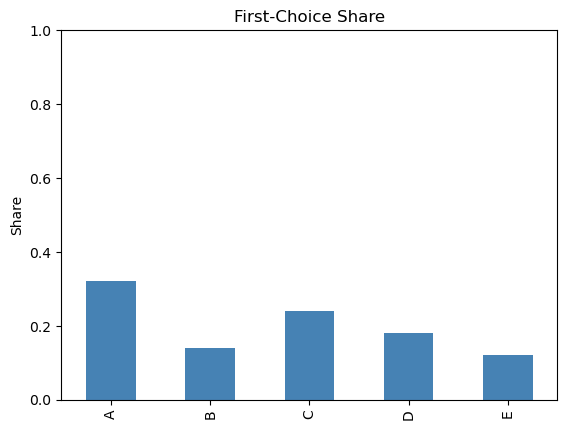

In [28]:
first_choice = (df_control == 1).sum()
(first_choice / len(df_control)).loc[option_names].plot(kind="bar", color="steelblue")
plt.ylabel("Share")
plt.title("First-Choice Share")
plt.ylim(0, 1)

In [29]:

# Create treatment data with matching column name and data type
treatment_data = SimulationExperimentEmpiricalValidator.read_empirical_data_from_dataframe(
    df=df,
    experimental_data_type="ordinal_ranking_per_agent",
    agent_id_column="name",
    value_column="Vote",
    agent_comments_column="justification",
    dataset_name="AI-enabled Story Telling Survey Simulation Results"
)

In [30]:
treatment_data

SimulationExperimentDataset(name='AI-enabled Story Telling Survey Simulation Results', description='Empirical data loaded from pandas DataFrame', key_results={'A_rank': [1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1], 'B_rank': [3, 4, 2, 2, 4, 3, 3, 5, 4, 2, 3, 4, 3, 3, 2, 4, 3, 2, 3, 3, 3, 1, 4, 3, 3, 2, 4, 3, 3, 4, 4, 3, 2, 3, 3, 3, 3, 3, 5, 2, 3, 3, 4, 3, 2, 3, 3, 3, 2, 3], 'C_rank': [4, 3, 4, 3, 3, 2, 2, 2, 2, 3, 2, 2, 2, 2, 3, 2, 2, 3, 2, 2, 2, 3, 2, 2, 2, 4, 3, 2, 4, 5, 3, 2, 4, 2, 2, 2, 2, 4, 2, 3, 2, 2, 1, 2, 3, 2, 2, 4, 4, 4], 'D_rank': [2, 1, 3, 4, 2, 4, 4, 3, 5, 4, 4, 3, 4, 4, 4, 3, 4, 4, 4, 4, 4, 4, 5, 5, 4, 3, 2, 4, 2, 2, 2, 4, 3, 4, 4, 4, 4, 2, 4, 4, 4, 4, 3, 4, 4, 4, 4, 2, 3, 2], 'E_rank': [5, 5, 5, 5, 5, 5, 5, 4, 3, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 3, 4, 5, 5, 5, 5, 5, 3, 5, 5, 5, 5, 5, 5, 5, 5, 3, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5]}, result_types={'A_rank': 'per_a

In [31]:
result_ttest = validate_simulation_experiment_empirically(
        control_data=control_data,
        treatment_data=treatment_data,
        validation_types=["statistical"],
        output_format="values"
    )

In [32]:
result_ttest.overall_score

0.5882229273532587

In [33]:
result_ttest.statistical_results

{'common_metrics': ['C_rank', 'D_rank', 'A_rank', 'E_rank', 'B_rank'],
 'test_results': {'treatment': {'C_rank': {'test_type': 'Welch t-test (unequal variance)',
    'control_mean': 2.54,
    'treatment_mean': 2.62,
    'mean_difference': 0.08000000000000007,
    'percent_change': 3.1496062992126013,
    't_statistic': -0.3673414747018703,
    'p_value': 0.7142531330541259,
    'confidence_interval': (-0.3528410450044054, 0.5128410450044055),
    'confidence_level': 0.95,
    'significant': False,
    'degrees_of_freedom': 87.3191757271271,
    'control_sample_size': 50,
    'treatment_sample_size': 50,
    'control_std': 1.265072394476026,
    'treatment_std': 0.8780776777502463,
    'effect_size': 0.07346829494037407},
   'D_rank': {'test_type': 'Welch t-test (unequal variance)',
    'control_mean': 2.86,
    'treatment_mean': 3.48,
    'mean_difference': 0.6200000000000001,
    'percent_change': 21.678321678321684,
    't_statistic': -2.8432285342290164,
    'p_value': 0.00551015430

In [34]:
result_ttest.semantic_results

In [35]:
result_ks = validate_simulation_experiment_empirically(
        control_data=control_data,
        treatment_data=treatment_data,
        validation_types=["statistical"],
        statistical_test_type="ks_test",
        output_format="values"
    )

In [36]:
result_ks.overall_score

0.6906055730556938

In [37]:
result_ks.statistical_results

{'common_metrics': ['C_rank', 'D_rank', 'A_rank', 'E_rank', 'B_rank'],
 'test_results': {'treatment': {'C_rank': {'test_type': 'Kolmogorov-Smirnov test',
    'control_mean': 2.54,
    'treatment_mean': 2.62,
    'control_median': 2.0,
    'treatment_median': 2.0,
    'control_std': 1.265072394476026,
    'treatment_std': 0.8780776777502463,
    'ks_statistic': 0.22,
    'p_value': 0.17858668181221732,
    'significant': False,
    'control_sample_size': 50,
    'treatment_sample_size': 50,
    'effect_size': 0.22,
    'overlap_coefficient': 0.5625,
    'percentile_differences': {'p25_diff': 0.0,
     'p50_diff': 0.0,
     'p75_diff': -0.75,
     'p90_diff': 0.0,
     'p95_diff': -1.0},
    'interpretation': 'No significant difference between distributions',
    'confidence_level': 0.95},
   'D_rank': {'test_type': 'Kolmogorov-Smirnov test',
    'control_mean': 2.86,
    'treatment_mean': 3.48,
    'control_median': 3.0,
    'treatment_median': 4.0,
    'control_std': 1.2290696664135679

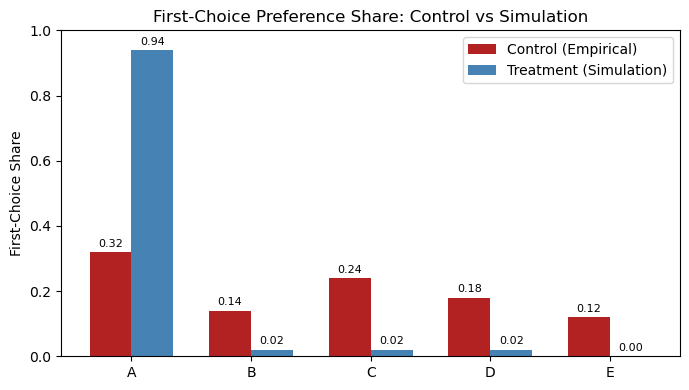

,Option,Control_FirstChoice,Treatment_FirstChoice
0,A,0.32,0.94
1,B,0.14,0.02
2,C,0.24,0.02
3,D,0.18,0.02
4,E,0.12,0.00


In [38]:
# Compare first-choice (rank==1) shares between control (empirical) and treatment (simulation)
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

def dataset_to_rank_df(dataset):
    rank_cols = [k for k in dataset.key_results if k.endswith("_rank")]
    opts = [c.replace("_rank", "") for c in rank_cols]
    if not rank_cols:
        raise ValueError("Dataset has no *_rank columns to compute first choices.")
    return pd.DataFrame({opt: dataset.key_results[f"{opt}_rank"] for opt in opts}), opts

# Build rank DataFrames
control_rank_df, options_control = dataset_to_rank_df(control_data)
try:
    treatment_rank_df, options_treatment = dataset_to_rank_df(treatment_data)
except Exception as e:
    # Fallback: attempt to reconstruct from original df if simulation dataset lacks expanded ranks
    if 'df' in globals():
        # Expect a column with combined ranking like "A,B,C,D,E" or single numeric; skip if not matching
        raise e
    else:
        raise e

# Ensure same option ordering
options = [opt for opt in options_control if opt in options_treatment]

# Compute first-choice shares (rank == 1)
fc_control = (control_rank_df[options] == 1).sum() / len(control_rank_df)
fc_treatment = (treatment_rank_df[options] == 1).sum() / len(treatment_rank_df)

comparison = pd.DataFrame({
    'Option': options,
    'Control_FirstChoice': [fc_control[o] for o in options],
    'Treatment_FirstChoice': [fc_treatment[o] for o in options]
})

# Plot side-by-side bars
x = np.arange(len(options))
width = 0.35
fig, ax = plt.subplots(figsize=(7,4))
ax.bar(x - width/2, comparison['Control_FirstChoice'], width, label='Control (Empirical)', color='firebrick')
ax.bar(x + width/2, comparison['Treatment_FirstChoice'], width, label='Treatment (Simulation)', color='steelblue')
ax.set_xticks(x)
ax.set_xticklabels(options)
ax.set_ylabel('First-Choice Share')
ax.set_ylim(0, 1)
ax.set_title('First-Choice Preference Share: Control vs Simulation')

for i, val in enumerate(comparison['Control_FirstChoice']):
    ax.text(x[i] - width/2, val + 0.01, f"{val:.2f}", ha='center', va='bottom', fontsize=8)
for i, val in enumerate(comparison['Treatment_FirstChoice']):
    ax.text(x[i] + width/2, val + 0.01, f"{val:.2f}", ha='center', va='bottom', fontsize=8)

ax.legend()
plt.tight_layout()
plt.show()

comparison

## Borda Count Comparison
This section computes Borda scores (higher is better) for each option in the empirical control data vs the simulation treatment data. Rank 1 gets the maximum points (N-1), rank N gets 0. We also show normalized scores (0-1) and the difference.

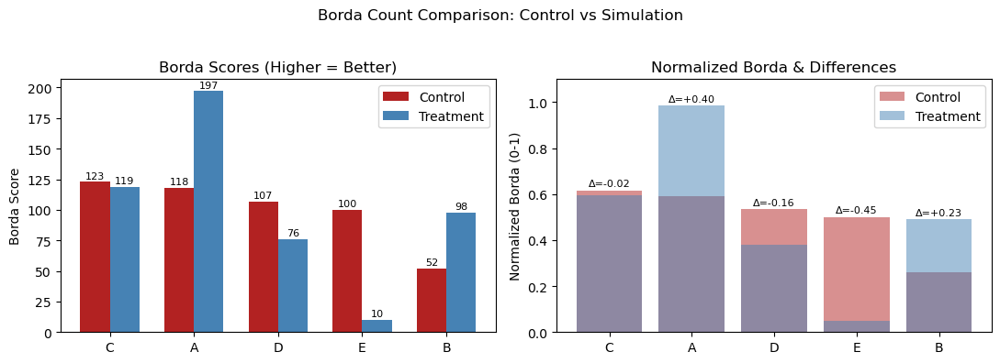

,Option,Control_Borda,Treatment_Borda,Control_Borda_Norm,Treatment_Borda_Norm,Norm_Diff
2,C,123,119,0.615,0.595,-0.020
0,A,118,197,0.590,0.985,0.395
3,D,107,76,0.535,0.380,-0.155
4,E,100,10,0.500,0.050,-0.450
1,B,52,98,0.260,0.490,0.230


In [39]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Reuse existing rank DataFrames: control_rank_df, treatment_rank_df, and options list
# Points scheme: with K options, rank 1 -> K-1 points, rank K -> 0 points
K = len(options)
points = {r: (K - r) for r in range(1, K+1)}

borda_control = control_rank_df[options].replace(points).sum()
borda_treatment = treatment_rank_df[options].replace(points).sum()

# Normalize (divide by max possible = (K-1) * number_of_respondents)
max_points_control = (K-1) * len(control_rank_df)
max_points_treatment = (K-1) * len(treatment_rank_df)

borda_control_norm = borda_control / max_points_control
borda_treatment_norm = borda_treatment / max_points_treatment

borda_df = pd.DataFrame({
    'Option': options,
    'Control_Borda': borda_control.values,
    'Treatment_Borda': borda_treatment.values,
    'Control_Borda_Norm': borda_control_norm.values,
    'Treatment_Borda_Norm': borda_treatment_norm.values,
})

borda_df['Norm_Diff'] = borda_df['Treatment_Borda_Norm'] - borda_df['Control_Borda_Norm']

# Order by control Borda descending for consistency
borda_df = borda_df.sort_values('Control_Borda', ascending=False)

fig, axes = plt.subplots(1, 2, figsize=(11,4))
# Absolute Borda scores
x = np.arange(len(borda_df))
width = 0.35
axes[0].bar(x - width/2, borda_df['Control_Borda'], width, label='Control', color='firebrick')
axes[0].bar(x + width/2, borda_df['Treatment_Borda'], width, label='Treatment', color='steelblue')
axes[0].set_xticks(x)
axes[0].set_xticklabels(borda_df['Option'])
axes[0].set_ylabel('Borda Score')
axes[0].set_title('Borda Scores (Higher = Better)')
axes[0].legend()
for i, v in enumerate(borda_df['Control_Borda']):
    axes[0].text(i - width/2, v + max(borda_df['Control_Borda'])*0.01, f"{int(v)}", ha='center', va='bottom', fontsize=8)
for i, v in enumerate(borda_df['Treatment_Borda']):
    axes[0].text(i + width/2, v + max(borda_df['Control_Borda'])*0.01, f"{int(v)}", ha='center', va='bottom', fontsize=8)

# Normalized difference plot
axes[1].bar(borda_df['Option'], borda_df['Control_Borda_Norm'], alpha=0.5, label='Control', color='firebrick')
axes[1].bar(borda_df['Option'], borda_df['Treatment_Borda_Norm'], alpha=0.5, label='Treatment', color='steelblue')
for i, opt in enumerate(borda_df['Option']):
    c_val = borda_df.iloc[i]['Control_Borda_Norm']
    t_val = borda_df.iloc[i]['Treatment_Borda_Norm']
    axes[1].text(i, max(c_val, t_val) + 0.01, f"Δ={t_val - c_val:+.02f}", ha='center', va='bottom', fontsize=8)
axes[1].set_ylim(0, 1.1)
axes[1].set_ylabel('Normalized Borda (0-1)')
axes[1].set_title('Normalized Borda & Differences')
axes[1].legend()

plt.suptitle('Borda Count Comparison: Control vs Simulation')
plt.tight_layout(rect=[0,0,1,0.95])
plt.show()

borda_df